In [1]:
#Import

import numpy as np
import matplotlib.pyplot as plt
from pprint import pprint
from biasmodels import MagnificationBias, GalaxyBias, EvolutionBias
from multipole_signal import Signal, Derivatives
from getdist import plots
from getdist.gaussian_mixtures import GaussianND
import fishermat as fm
import pickle as pk

#Set current directory
import os
import sys

PACKAGE_PARENT = '..'
SCRIPT_DIR = os.path.dirname(os.path.realpath(os.path.join(os.getcwd())))
sys.path.append(SCRIPT_DIR)
print(SCRIPT_DIR)

#Configuration
large = 22; med = 16; small = 12
params = {'axes.titlesize': large,
          'legend.fontsize': med,
          'axes.labelsize': med,
          'axes.titlesize': med,
          'xtick.labelsize': med,
          'ytick.labelsize': med,
          'figure.titlesize': large}
plt.rcParams.update(params)

plt.rcParams['text.usetex'] = True
plt.rcParams['font.family'] = 'serif'

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

C:\Users\Daniel SB\OneDrive\Documentos\GitHub


In [2]:
# Redshift bins

z_bins = np.array([0.15, 0.25, 0.35, 0.45, 0.55, 0.65, 0.75, 0.85, 0.95, 1.05, 1.15, 1.25, 1.35, 1.45, 1.55, 1.65, 1.75, 1.85, 1.95])

# Separations

dist = [
    np.arange(20, 164, 4),
    np.arange(32, 164, 4),
]

params_dict0 = {
    'h' : 0.6766,
    'As' : 2.05e-9,
    'ns' : 0.9665,
    'Ob' : 0.04897, # This is here the density parameter of Baryons
    'Om' : 0.3111, # This is here the density parameter of Cold Dark Matter
}

steps = [1e-3, 1e-1, 1e-4, 1e-2, 1e-2]

# Derivatives

In [3]:
with open('derivatives.pkl', 'rb') as File:
    derivatives_dict = pk.load(File)
    
#derivatives_50x50 = derivatives_dict['split_50x50']
#derivatives_30x70 = derivatives_dict['split_30x70']
derivatives_70x30 = derivatives_dict['split_70x30']

## Including the octupole

In [4]:
dsignal_dsbias_fit = derivatives_70x30['dsignal_dsbias']

dsignal_dgbias =  derivatives_70x30['dsignal_dgbias']

dsignal_dcosmic =  derivatives_70x30['dsignal_dcosmic']

dsignal_dnum_fit =  derivatives_70x30['dsignal_dnumev']

np.shape(dsignal_dsbias_fit), np.shape(dsignal_dgbias), np.shape(dsignal_dcosmic)

((8, 19, 324), (4, 19, 324), (5, 19, 324))

In [5]:
dsignal_dtheta_fit_all = np.concatenate([dsignal_dsbias_fit, dsignal_dnum_fit, dsignal_dgbias, dsignal_dcosmic])

np.shape(dsignal_dtheta_fit_all)

(21, 19, 324)

## Remove the octupole

In [6]:
n_sep = len(dist[0])

print('Number of separations per multipole = ', n_sep)

Number of separations per multipole =  36


In [7]:
dsignal_dsbias_fit_noct = dsignal_dsbias_fit[:,:,:-n_sep]

dsignal_dgbias_noct = dsignal_dgbias[:,:,:-n_sep]

dsignal_dcosmic_noct = dsignal_dcosmic[:,:,:-n_sep]

dsignal_dnum_fit_noct = dsignal_dnum_fit[:,:,:-n_sep]

np.shape(dsignal_dsbias_fit_noct), np.shape(dsignal_dgbias_noct), np.shape(dsignal_dcosmic_noct), np.shape(dsignal_dnum_fit_noct)

((8, 19, 288), (4, 19, 288), (5, 19, 288), (4, 19, 288))

In [8]:
dsignal_dtheta_fit_noct = np.concatenate([dsignal_dsbias_fit_noct, dsignal_dnum_fit_noct, dsignal_dgbias_noct, dsignal_dcosmic_noct])

np.shape(dsignal_dtheta_fit_noct)

(21, 19, 288)

# Analysis with $m = 10/7$

## NO OCTUPOLE

In [9]:
# Create the Cov Matrix for sB, sF, nevol

errB = [2e-1, 2e-1] 
errF = [2e-1, 2e-1]

sB_4fit = np.array([-0.93372809,  1.82432411, -0.92835543, -0.24102824])
sF_4fit = np.array([-0.19376095,  1.0747336,  -0.07806247, -0.00558005])
nevol_fid = np.array([7.94599875, -12.03752387,   2.29927261, -15.83887369])

num_fit = nevol_fid

dsB_19bins = sB_4fit * errB[0] 
dsF_19bins = sF_4fit * errF[0]

dnum_19bins = num_fit * errB[1]

Cov_all_19bins = np.diag(np.concatenate([dsB_19bins**2, dsF_19bins**2, dnum_19bins**2]))

Inv_Cov_all_19bins = np.linalg.inv(Cov_all_19bins)

Inv_Cov_prior_all = np.zeros([len(dsignal_dtheta_fit_all), len(dsignal_dtheta_fit_all)])

Inv_Cov_prior_all[:len(Inv_Cov_all_19bins), :len(Inv_Cov_all_19bins)] = Inv_Cov_all_19bins

np.shape(Cov_all_19bins)

(12, 12)

In [10]:
Cov_multipoles_19bins = fm.cov_matrix_survey(d = dist[0], z_bins = z_bins, split=[70,30])

np.shape(Cov_multipoles_19bins), type(Cov_multipoles_19bins)


 ... Loading Covariance Matrices [MONOBB, MONOBF, MONOFF, DIPBF, QUADBB, QUADBF, QUADFF, HEXAT, OCTBF] ... 

Population splitted in 70% BRIGHT - 30% FAINT 


 ... Success! ... 



((19, 324, 324), list)

In [11]:
Inv_Cov_multipoles_noct_19bins = [np.linalg.inv(Cov_multipoles_19bins[k][:-n_sep,:-n_sep]) for k,_ in enumerate(z_bins)]

Fisher_Matrix_multipoles_noct_19bins = fm.fisher_matrix(d_signal = dsignal_dtheta_fit_noct, inv_cov = Inv_Cov_multipoles_noct_19bins, z_bins = z_bins)
Fisher_Matrix_noct_19bins = Fisher_Matrix_multipoles_noct_19bins + Inv_Cov_prior_all

Sigma_Matrix_noct_19bins = np.linalg.inv(Fisher_Matrix_noct_19bins)

np.shape(Sigma_Matrix_noct_19bins)


 ... Computing the Fisher Matrix ... 

Signal & Cov must be given as functions (z,d) and (z,d,d') respectively. 


 ... Success! ... 



(21, 21)

#### Constraints

In [12]:
#Absolute Errors

Abs_Errors_noct_19bins = np.sqrt(np.diag(Sigma_Matrix_noct_19bins))

# Fiducial values

sbias_fid = np.concatenate([sB_4fit, sF_4fit])
num_fid = num_fit
gbias_fid = np.concatenate([np.array([0.554, 0.783]), np.array([0.554, 0.783])])
cosmic_fid = np.fromiter(params_dict0.values(), dtype=float)
cosmic_fid[1] = np.log(10**10 * cosmic_fid[1])

params_fid = np.concatenate([sbias_fid, num_fid, gbias_fid, cosmic_fid])

# Relative errors

Rel_Errors_noct_19bins = np.abs(Abs_Errors_noct_19bins/params_fid)

params_errors_noct_19bins = Rel_Errors_noct_19bins * 100

print()
print('------------ Relative errors * 100 ------------' )
print()
print('sbias = ', params_errors_noct_19bins[0:len(sbias_fid)])
print()
print('number = ', params_errors_noct_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))])
print()
print('gbias = ', params_errors_noct_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))])
print()
print('cosmic = ', params_errors_noct_19bins[(len(sbias_fid) + len(num_fid)+len(gbias_fid)):])


------------ Relative errors * 100 ------------

sbias =  [12.49690145  9.28232653 10.49348593 13.11050653 18.50862769 14.72545191
 19.28378534 19.98396027]

number =  [18.6255772  19.35767768 15.49220771 15.51695965]

gbias =  [0.39521786 0.33811297 0.16114476 0.3064237 ]

cosmic =  [1.17877091 0.75547588 0.97956221 1.1831462  0.5387367 ]


#### Plots

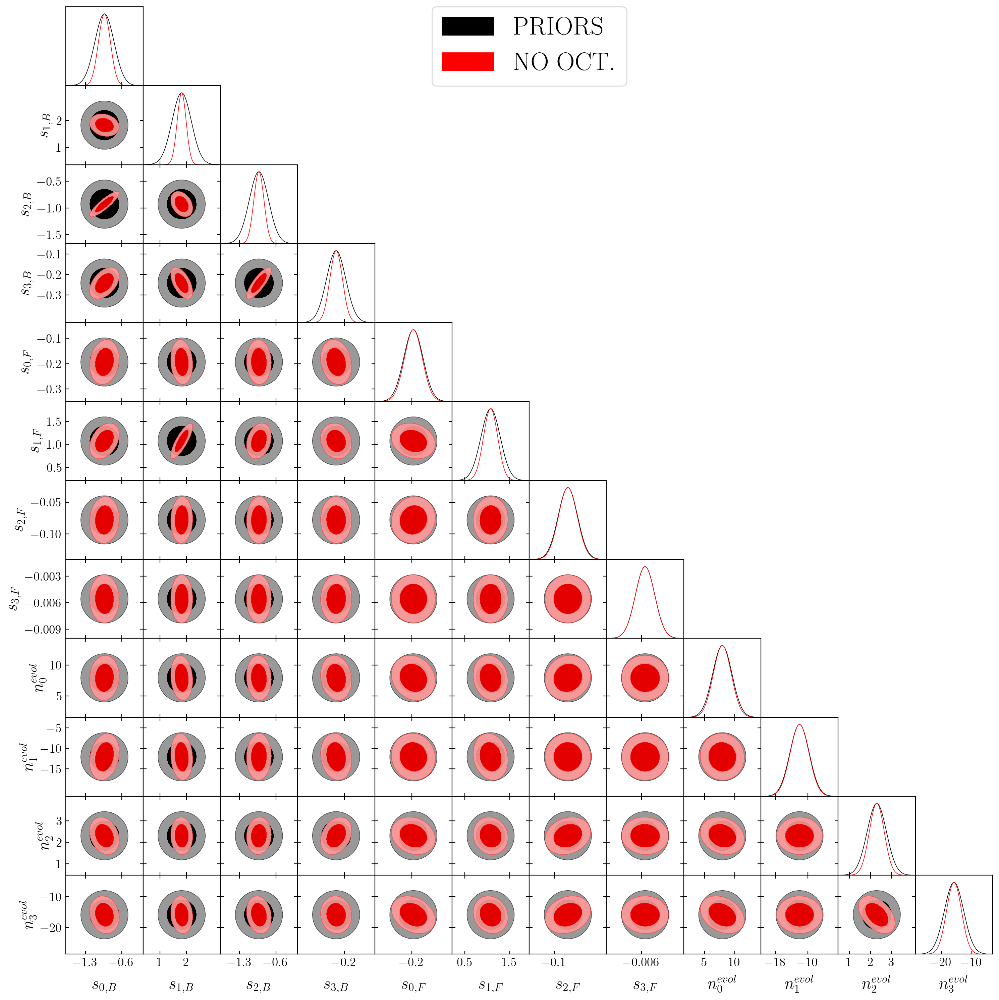

In [13]:
# Triangle plot

mean = np.concatenate([sB_4fit, sF_4fit, num_fit])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

num_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

num_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names + sF_names + num_names 
labels = sB_labels + sF_labels + num_labels 

GaussDist_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_noct_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_ini_sbias_fbias_fit = GaussianND(mean, Cov_all_19bins, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=15)
g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=18
g.settings.axes_labelsize=22
g.settings.axis_tick_max_labels=6

g.triangle_plot([GaussDist_ini_sbias_fbias_fit, GaussDist_sbias_fbias_fit], param_names, 
                filled=True, 
                legend_labels=['PRIORS', 'NO OCT.'],
                contour_colors=['black', 'red'])

In [14]:
# Remove sF and fevolB params

rows_to_remove = np.r_[4:8, 12:len(Sigma_Matrix_noct_19bins)]

Sigma_Matrix_noct_19bins_ = np.delete(Sigma_Matrix_noct_19bins, rows_to_remove, axis=0)
Sigma_Matrix_noct_19bins_ = np.delete(Sigma_Matrix_noct_19bins_, rows_to_remove, axis=1)

Cov_all_19bins_ = np.delete(Cov_all_19bins, np.r_[4:8], axis=0)
Cov_all_19bins_ = np.delete(Cov_all_19bins_, np.r_[4:8], axis=1)

np.shape(Sigma_Matrix_noct_19bins_), np.shape(Cov_all_19bins_)

((8, 8), (8, 8))

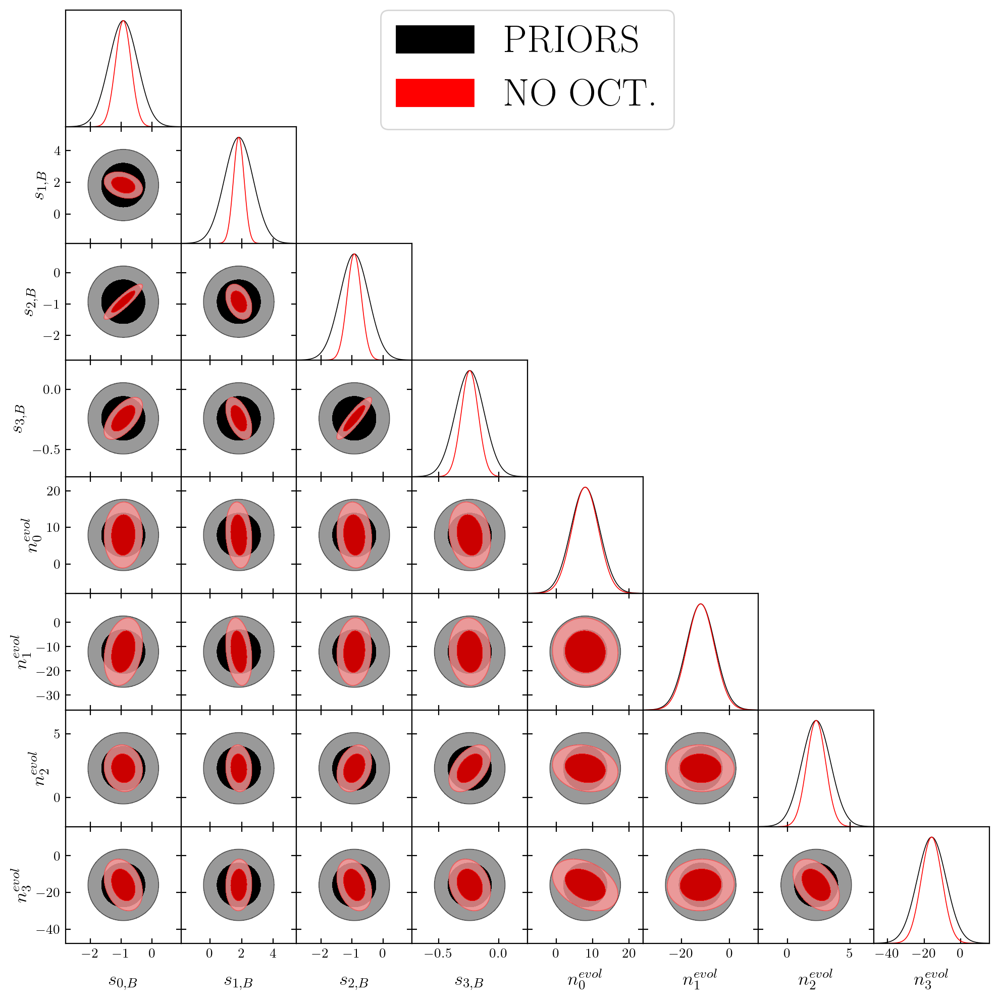

In [131]:
# Triangle plot

mean = np.concatenate([sB_4fit, num_fit])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

fB_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

fB_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names +  fB_names
labels = sB_labels + fB_labels

GaussDist_sbias_fbias_fit_ = GaussianND(mean, Sigma_Matrix_noct_19bins_, labels = labels, names = param_names)
GaussDist_ini_sbias_fbias_fit_ = GaussianND(mean, Cov_all_19bins_, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=10)
g.settings.legend_frame = True
g.settings.alpha_filled_add=0.8
g.settings.legend_fontsize=32
g.settings.axes_fontsize=14
g.settings.axes_labelsize=18
g.settings.axis_tick_max_labels=4

g.triangle_plot([GaussDist_ini_sbias_fbias_fit_, GaussDist_sbias_fbias_fit_], param_names, 
                filled=True, 
                legend_labels=['PRIORS', 'NO OCT.'],
                contour_colors=['black', 'red'])

#### Predictions

##### Magnification bias

In [15]:
# Magnification bias fit

def magbias_fit(params, x):
    a, b, c, d = params
    return  a + b * x + c * np.log(x) + d * (np.log(x))**2

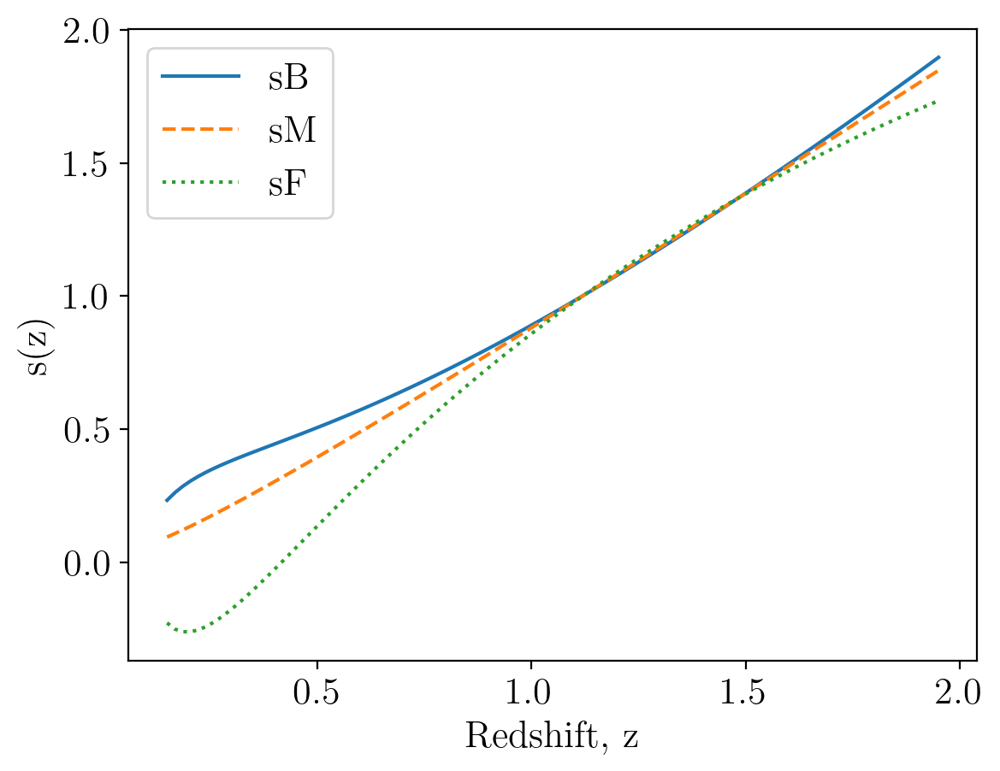

In [16]:
z_lin = np.linspace(z_bins[0], z_bins[-1], 100)
m_split = 10/7.

sB_fid = magbias_fit(sB_4fit, z_lin)
sM_fid = magbias_fit(sF_4fit, z_lin)
sF_fid = sM_fid * (m_split/(m_split-1)) - sB_fid/(m_split-1)

plt.plot(z_lin, sB_fid, '-', label=r'sB')
plt.plot(z_lin, sM_fid, '--', label=r'sM')
plt.plot(z_lin, sF_fid, ':', label=r'sF')

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.legend();


###### Compare the two observables

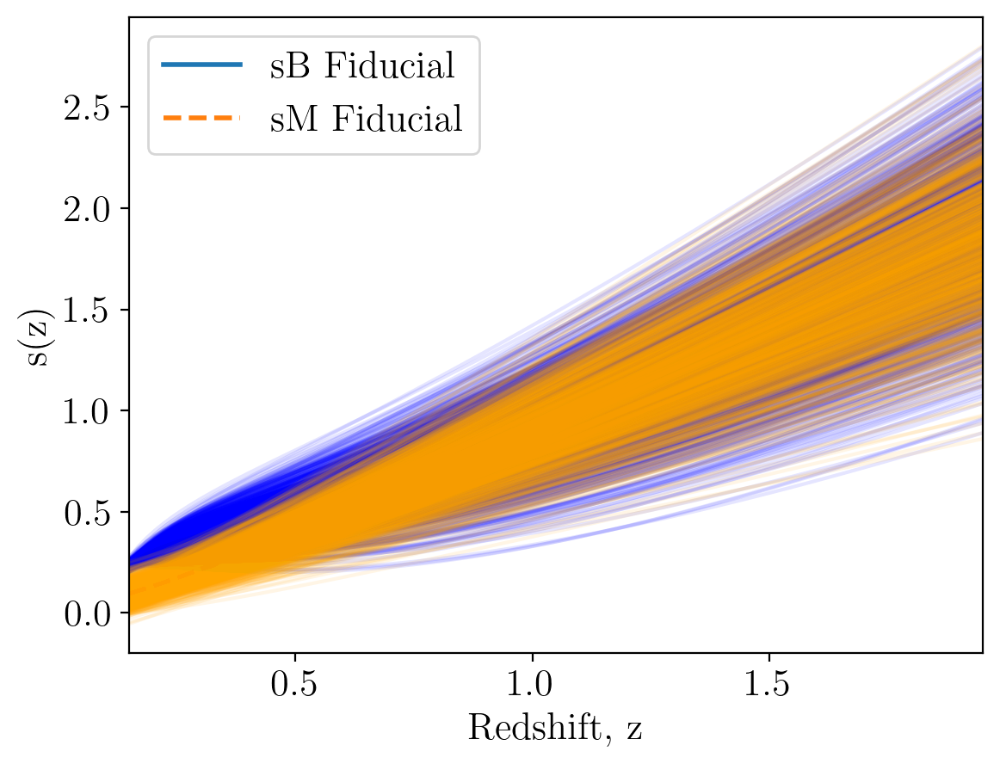

In [17]:
# Select the marginalized covariance matrix for the magnification biases

cov_sB = Sigma_Matrix_noct_19bins[:4, :4]
cov_sM = Sigma_Matrix_noct_19bins[4:8, 4:8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sB_pars_samples = np.random.multivariate_normal(sB_4fit, cov_sB, num_samples)
sM_pars_samples = np.random.multivariate_normal(sF_4fit, cov_sM, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples = np.array([magbias_fit(pars, z_lin) for pars in sB_pars_samples])
sM_samples = np.array([magbias_fit(pars, z_lin) for pars in sM_pars_samples])

# Calculate the 68% confidence interval
sB_lower_bound = np.percentile(sB_samples, 16, axis=0)
sB_upper_bound = np.percentile(sB_samples, 84, axis=0)
sM_lower_bound = np.percentile(sM_samples, 16, axis=0)
sM_upper_bound = np.percentile(sM_samples, 84, axis=0)

# Step 5: Plotting

plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0)
plt.plot(z_lin, sM_fid, '--', label=r'sM Fiducial', lw = 2.0)

# Plot the fitting function for each sample
for sample in sB_samples:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)

for sample in sM_samples:
    plt.plot(z_lin, sample, color='orange', alpha=0.1)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.legend();


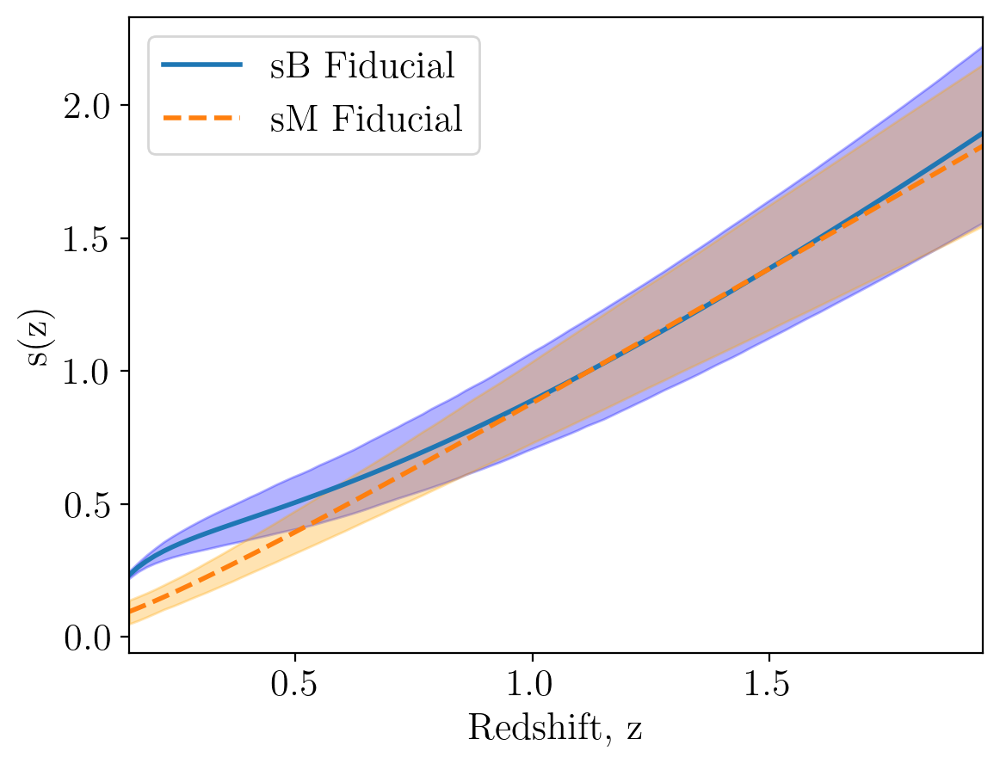

In [18]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0)
plt.plot(z_lin, sM_fid, '--', label=r'sM Fiducial', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound, sM_upper_bound, color='orange', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.legend();

###### Compare with priors

In [19]:
# Select the marginalized covariance matrix for the magnification biases priors

cov_sB_priors = Cov_all_19bins[:4, :4]
cov_sM_priors = Cov_all_19bins[4:8, 4:8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sB_pars_samples_priors = np.random.multivariate_normal(sB_4fit, cov_sB_priors, num_samples)
sM_pars_samples_priors = np.random.multivariate_normal(sF_4fit, cov_sM_priors, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_priors = np.array([magbias_fit(pars, z_lin) for pars in sB_pars_samples_priors])
sM_samples_priors = np.array([magbias_fit(pars, z_lin) for pars in sM_pars_samples_priors])

# Calculate the 68% confidence interval
sB_lower_bound_priors = np.percentile(sB_samples_priors, 16, axis=0)
sB_upper_bound_priors = np.percentile(sB_samples_priors, 84, axis=0)
sM_lower_bound_priors = np.percentile(sM_samples_priors, 16, axis=0)
sM_upper_bound_priors = np.percentile(sM_samples_priors, 84, axis=0)

Text(0.5, 1.0, 'Prediction vs Prior')

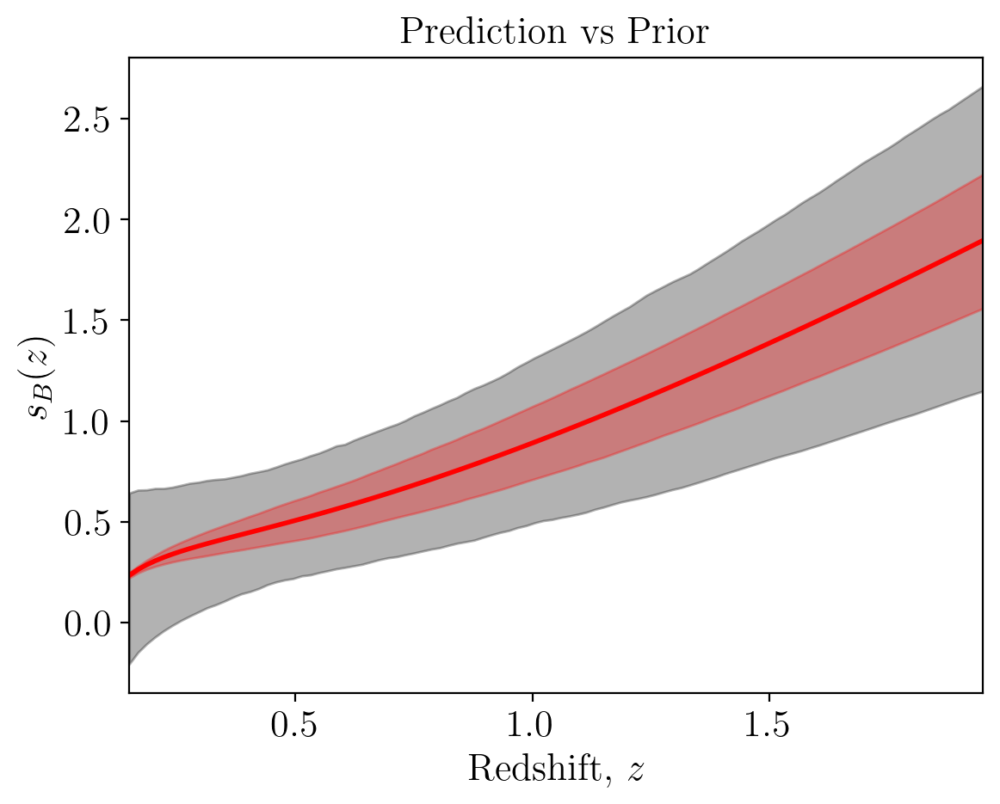

In [20]:
plt.plot(z_lin, sB_fid, '-', lw = 2.0, color='red')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_priors, sB_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='red', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_B(z)$');
plt.title(r'Prediction vs Prior')

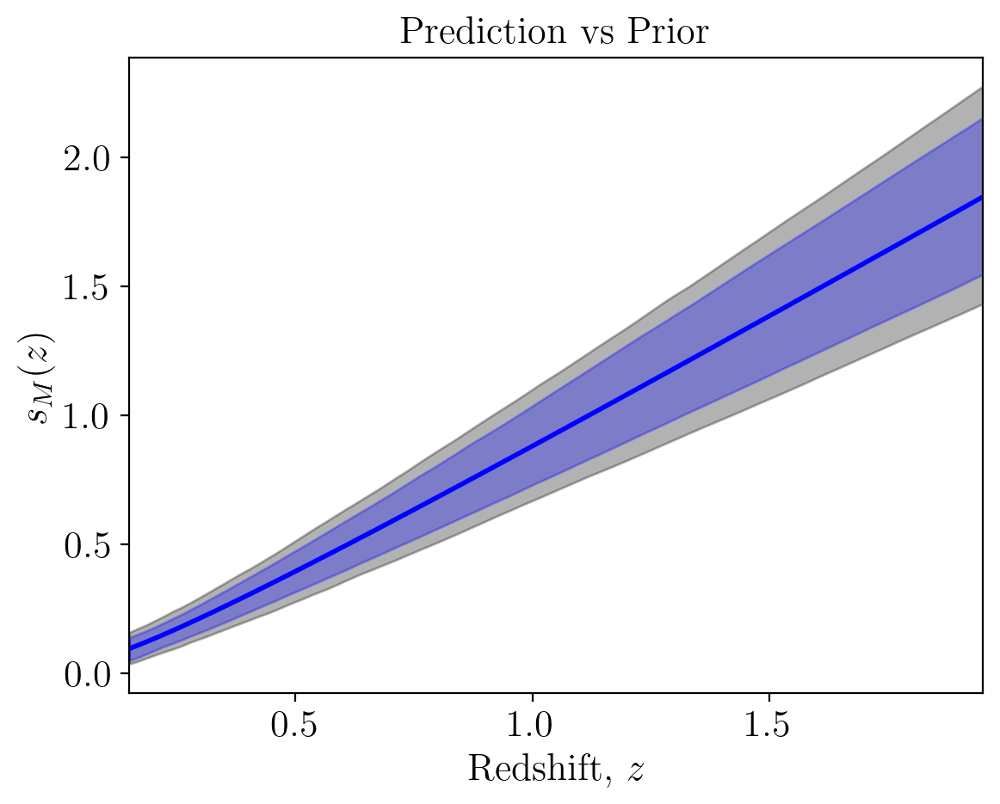

In [21]:
plt.plot(z_lin, sM_fid, '-', lw = 2.0, color='blue')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sM_lower_bound_priors, sM_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound, sM_upper_bound, color='blue', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_M(z)$');
plt.title(r'Prediction vs Prior');

###### Magnification bias of the Faint

The magnification bias of the faint population is obtained by:

$$ s_F(z) = s_{model}(z)\frac{\bar{N}(z)}{\bar{N}_F(z)} - s_B(z)\frac{\bar{N}_B(z)}{\bar{N}_F(z)} = s_F(z) = s_{model}(z)\frac{m}{m-1} - s_B(z)\frac{1}{m-1} $$ 

We need to sample together the $s_B$ and $s_m$ parameters.

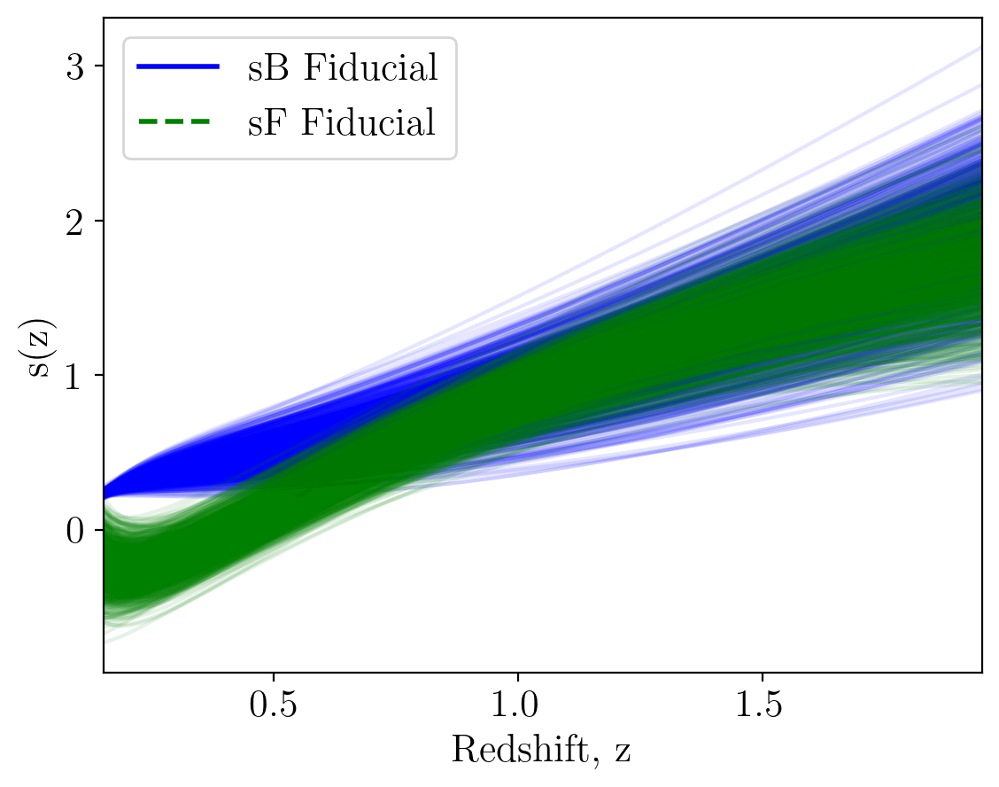

In [22]:
# Select the marginalized covariance matrix for the magnification biases together
cov_sbias = Sigma_Matrix_noct_19bins[:8, :8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sbias_pars_samples = np.random.multivariate_normal(sbias_fid, cov_sbias, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples = np.array([magbias_fit(pars[:4], z_lin) for pars in sbias_pars_samples])
sM_samples = np.array([magbias_fit(pars[4:8], z_lin) for pars in sbias_pars_samples])

# Compute the sF for each sample
sF_samples = sM_samples*m_split/(m_split-1) - sB_samples/(m_split-1)

# Calculate the 68% confidence interval
sF_lower_bound = np.percentile(sF_samples, 16, axis=0)
sF_upper_bound = np.percentile(sF_samples, 84, axis=0)

# Step 5: Plotting

plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='blue')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='green')

# Plot the fitting function for each sample
for sample in sB_samples:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)

for sample in sF_samples:
    plt.plot(z_lin, sample, color='green', alpha=0.1)
    
plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.legend();

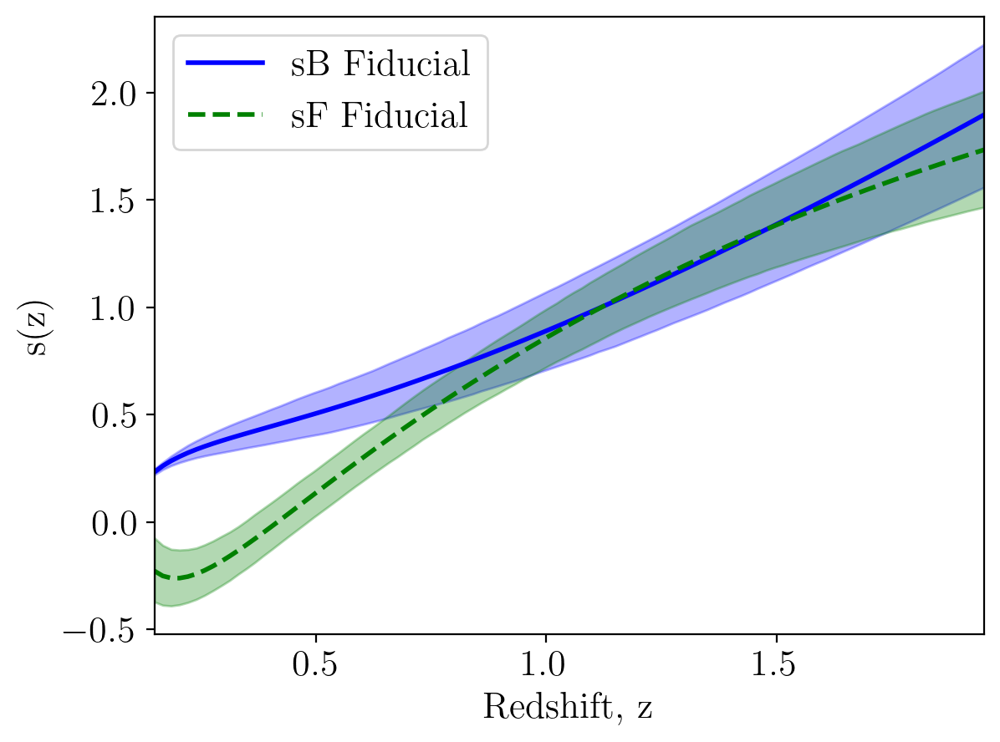

In [23]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='blue')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='green')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound, sF_upper_bound, color='green', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.legend();

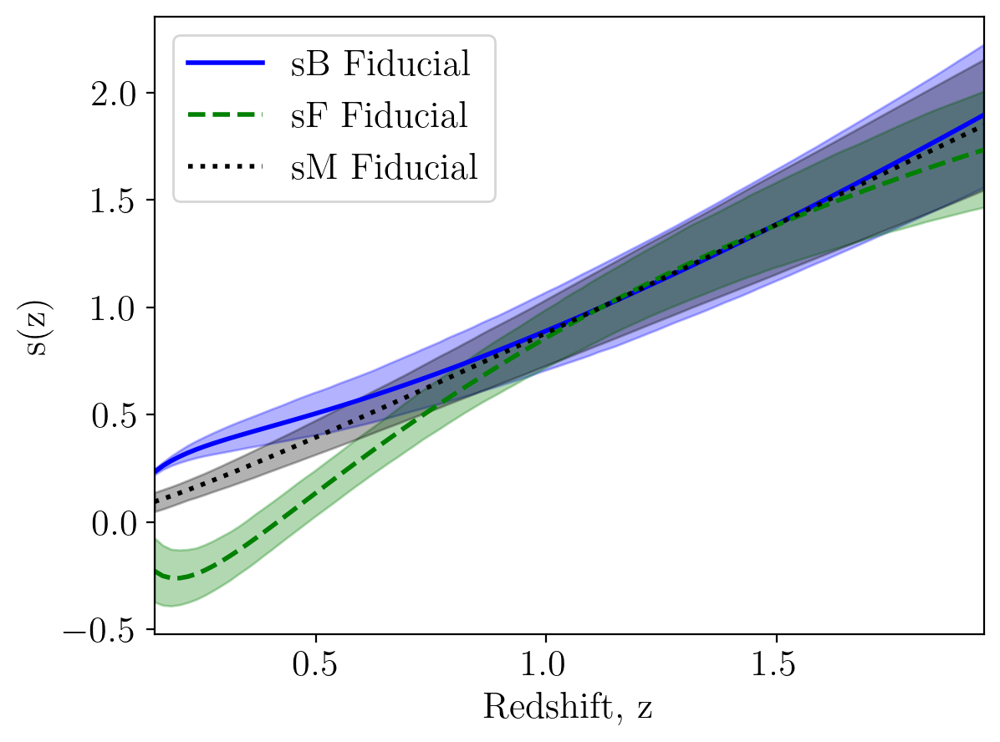

In [24]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='blue')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='green')
plt.plot(z_lin, sM_fid, ':', label=r'sM Fiducial', lw = 2.0, color='black')


# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound, sF_upper_bound, color='green', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound, sM_upper_bound, color='black', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.legend();

Compare with priors

In [25]:
# Select the marginalized covariance matrix for the magnification biases together
cov_sbias_priors = Cov_all_19bins[:8, :8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sbias_pars_samples_priors = np.random.multivariate_normal(sbias_fid, cov_sbias_priors, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_priors = np.array([magbias_fit(pars[:4], z_lin) for pars in sbias_pars_samples_priors])
sM_samples_priors = np.array([magbias_fit(pars[4:8], z_lin) for pars in sbias_pars_samples_priors])

# Compute the sF for each sample
sF_samples_priors = sM_samples_priors*m_split/(m_split-1) - sB_samples_priors/(m_split-1)

# Calculate the 68% confidence interval
sF_lower_bound_priors = np.percentile(sF_samples_priors, 16, axis=0)
sF_upper_bound_priors = np.percentile(sF_samples_priors, 84, axis=0)

Text(0.5, 1.0, 'Prediction vs Prior')

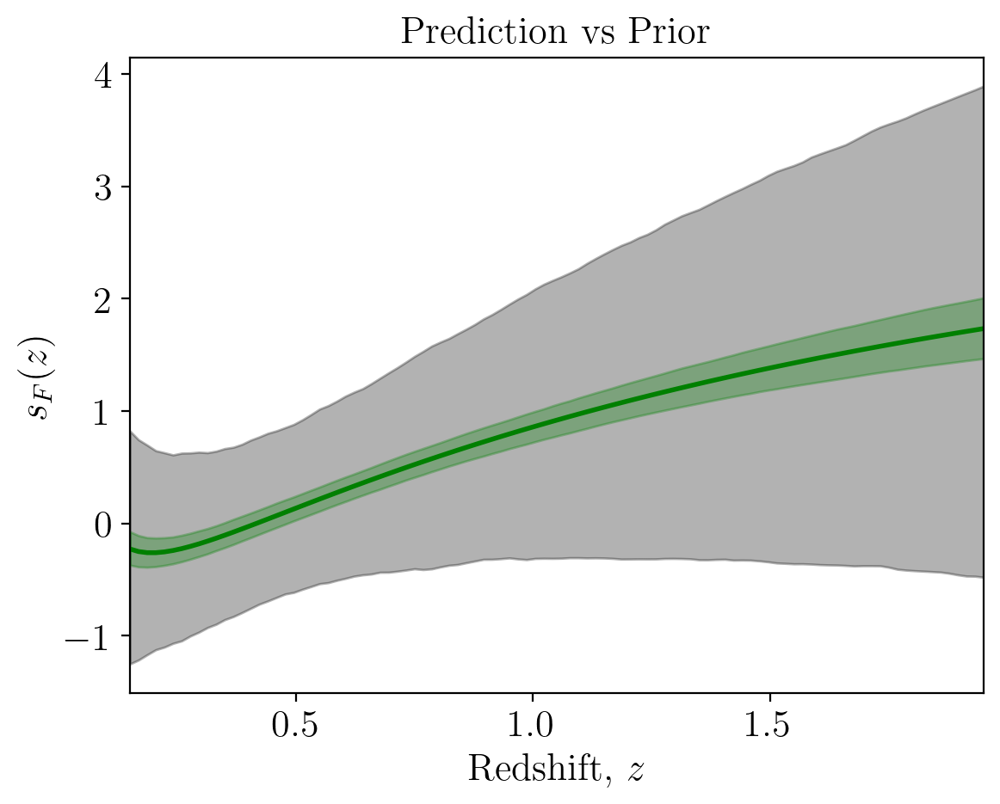

In [26]:
plt.plot(z_lin, sF_fid, '-', lw = 2.0, color='green')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sF_lower_bound_priors, sF_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound, sF_upper_bound, color='green', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_F(z)$');
plt.title(r'Prediction vs Prior')

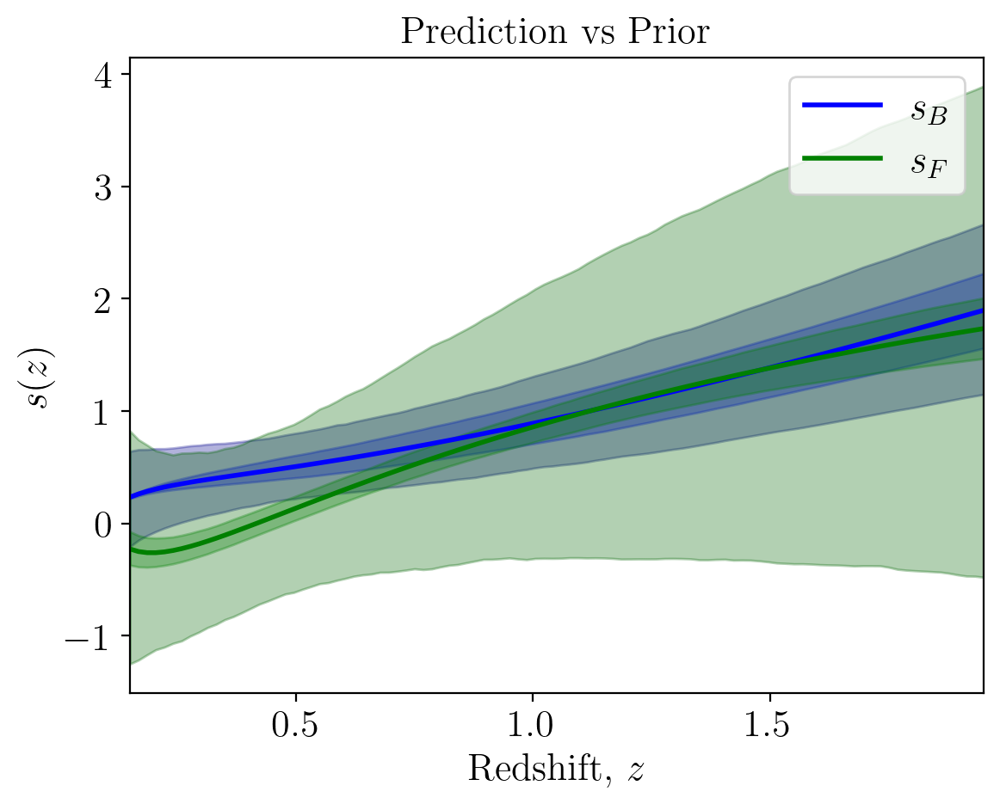

In [27]:
plt.plot(z_lin, sB_fid, '-', lw = 2.0, color='blue', label=r'$s_B$')
plt.plot(z_lin, sF_fid, '-', lw = 2.0, color='green', label=r'$s_F$')


# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_priors, sB_upper_bound_priors, color='darkblue', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_priors, sF_upper_bound_priors, color='darkgreen', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound, sF_upper_bound, color='green', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s(z)$');
plt.title(r'Prediction vs Prior');
plt.legend();

##### Number evolution

In [28]:
def nevol_fit(params, x):
    a, b, c, d = params
    return a + b * x + c * (1/x) + d * np.exp(-x)

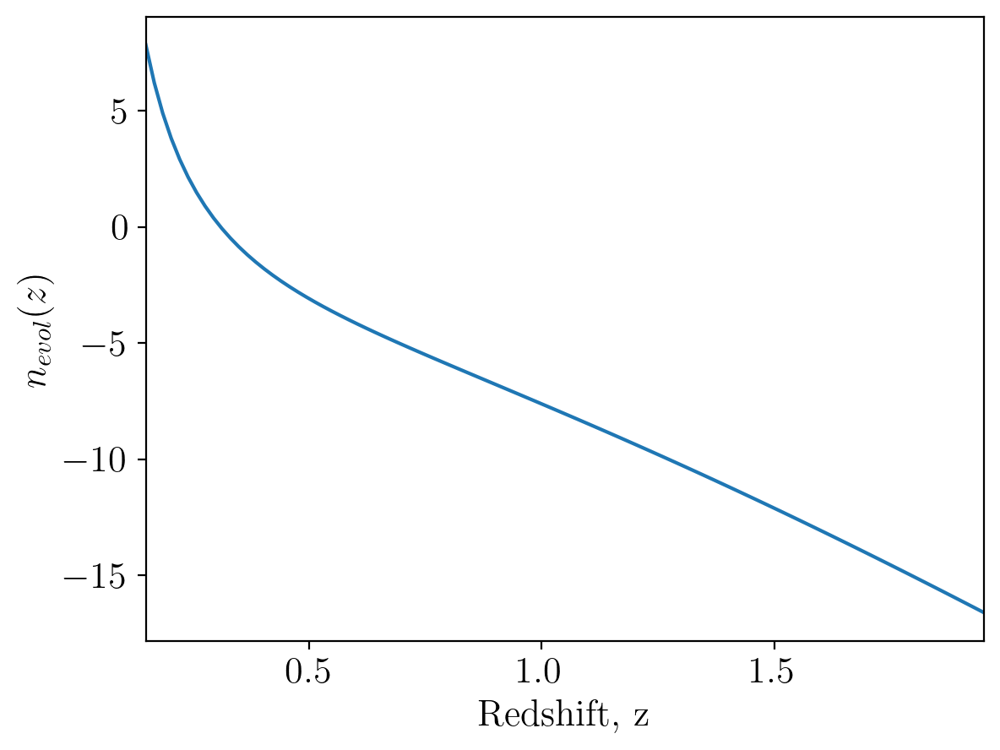

In [29]:
z_lin = np.linspace(z_bins[0], z_bins[-1], 100)
m_split = 2.

num_evol_fid = nevol_fit(nevol_fid, z_lin)

plt.plot(z_lin, num_evol_fid, '-')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$n_{evol}(z)$');

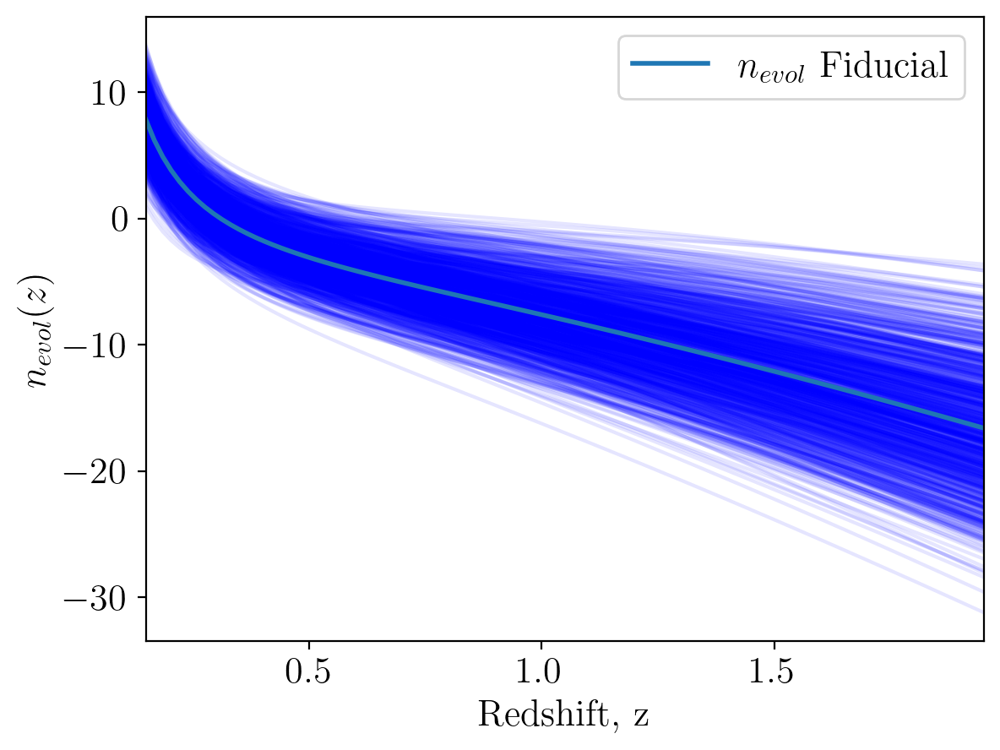

In [30]:
# Select the marginalized covariance matrix for the number evolution
cov_numevol = Sigma_Matrix_noct_19bins[8:12, 8:12]
cov_numevol_priors = Cov_all_19bins[8:12, 8:12]


# Generate parameter samples from multivariate normal distribution
num_samples = 1000
nevol_pars_samples = np.random.multivariate_normal(nevol_fid, cov_numevol, num_samples)
nevol_samples_priors = np.random.multivariate_normal(nevol_fid, cov_numevol_priors, num_samples)


# Evaluate fitting function for each parameter sample
nevol_samples = np.array([nevol_fit(pars, z_lin) for pars in nevol_pars_samples])
nevol_samples_priors = np.array([nevol_fit(pars, z_lin) for pars in nevol_samples_priors])

# Calculate the 68% confidence interval
nevol_lower_bound = np.percentile(nevol_samples, 16, axis=0)
nevol_upper_bound = np.percentile(nevol_samples, 84, axis=0)
nevol_lower_bound_priors = np.percentile(nevol_samples_priors, 16, axis=0)
nevol_upper_bound_priors = np.percentile(nevol_samples_priors, 84, axis=0)

# Step 5: Plotting

# Plot the fitting function for each sample
for sample in nevol_samples:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.plot(z_lin, num_evol_fid, '-', label=r'$n_{evol}$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$n_{evol}(z)$')
plt.legend();

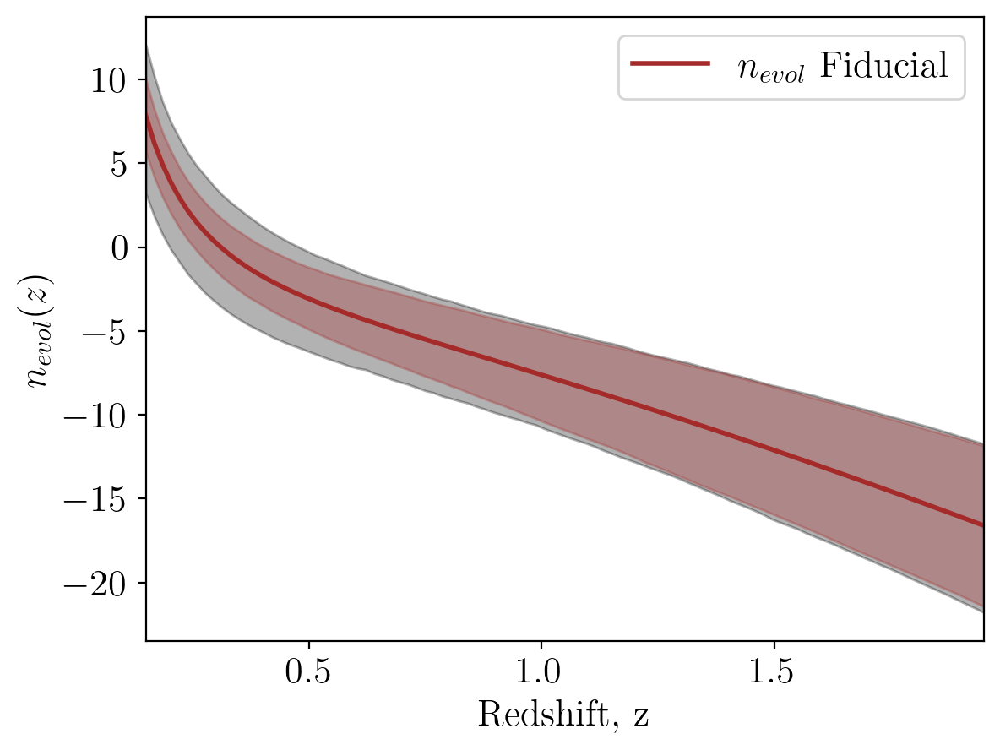

In [31]:
plt.plot(z_lin, num_evol_fid, '-', color='brown', label=r'$n_{evol}$'+' Fiducial', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, nevol_lower_bound_priors, nevol_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, nevol_lower_bound, nevol_upper_bound, color='brown', alpha=0.3)


plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$n_{evol}(z)$')
plt.legend();

##### Evolution bias

The evolution bias is computed from the magnification biases and the evolution of the number densities.

$$ f^{evol}_{B}(z) = -\frac{d\log{N_B(z)}}{d\log{(1+z)}} - \frac{d\log{H(z)}}{d\log{(1+z)}} + \frac{2(1+z)}{r(z)H(z)} -5\,s_B(z)\left(1+\frac{(1+z)}{r(z)H(z)}\right) - \frac{5}{2}s_B(z)\,\frac{d\log{F_c}}{d\log{(1+z)}} $$

$$ f^{evol}_{F}(z) = -\frac{d\log{N_F(z)}}{d\log{(1+z)}} - \frac{d\log{H(z)}}{d\log{(1+z)}} + \frac{2(1+z)}{r(z)H(z)} -5\,s_F(z)\left(1+\frac{(1+z)}{r(z)H(z)}\right) 
    - \frac{5}{2}\left[\frac{\bar{N}}{\bar{N}_F}\,s_{model}(z)\frac{d\log{F_*}}{d\log{(1+z)}}-\frac{\bar{N}_B}{\bar{N}_F}\,s_B(z)\frac{d\log{F_c}}{d\log{(1+z)}}\right] $$

We have all the ingredients defined as methods in the EvolutionBias class. We need to extract the relevant terms and then sample togeter the $n_{evol}$ and magnification bias parameters to construct the predictions for each evolution bias. 

In [32]:
m_split = 10/7

myEvolBias = EvolutionBias(n_split=m_split)

dlogH = myEvolBias.dlogH
rHterm = myEvolBias.rHterm
dFstar = myEvolBias.dLogFstar
dFcut = myEvolBias.dLogFcut

In [33]:
def fevol_bright(pars_s, pars_n, z):
    pars_sB = pars_s[:4] 
    return - nevol_fit(params=pars_n, x=z) - dlogH(z) + (2 - 5*magbias_fit(params=pars_sB, x=z))*rHterm(z) - 5*magbias_fit(params=pars_sB, x=z) - 5/2*magbias_fit(params=pars_sB, x=z)*dFcut(z)
    
def fevol_faint(pars_s, pars_n, z):
    
    pars_sB = pars_s[:4]
    pars_sM = pars_s[4:]
    s_B = magbias_fit(params=pars_sB, x=z)
    s_M = magbias_fit(params=pars_sM, x=z)
    s_faint = s_M*m_split/(m_split-1) - s_B/(m_split-1)
    
    return - nevol_fit(params=pars_n, x=z) - dlogH(z) + (2 - 5*s_faint)*rHterm(z) - 5*s_faint + 5/2*((1/(m_split-1)) * s_B *dFcut(z) - (m_split/(m_split-1)) * s_M *dFstar(z))

In [34]:
sbias_fid

array([-0.93372809,  1.82432411, -0.92835543, -0.24102824, -0.19376095,
        1.0747336 , -0.07806247, -0.00558005])

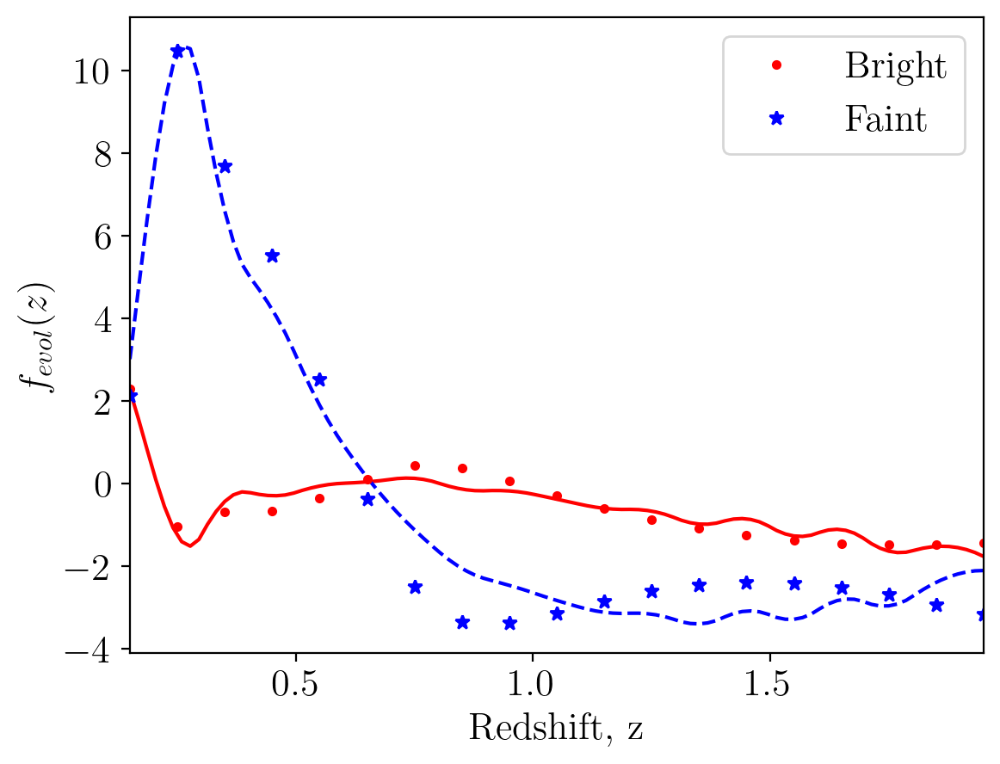

In [35]:
z_lin = np.linspace(z_bins[0], z_bins[-1], 100)

fevol_B_fid = fevol_bright(pars_s = sbias_fid, pars_n = nevol_fid, z = z_lin)
fevol_F_fid = fevol_faint(pars_s = sbias_fid, pars_n = nevol_fid, z = z_lin)

plt.plot(z_lin, fevol_B_fid, 'r-')
plt.plot(z_lin, fevol_F_fid, 'b--')

feB = myEvolBias.fevol_bright(z_bins)
feF = myEvolBias.fevol_faint(z_bins)

plt.plot(z_bins, feB, 'r.', label='Bright')
plt.plot(z_bins, feF, 'b*', label='Faint')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f_{evol}(z)$');
plt.legend();

In [36]:
# Select the marginalized covariance matrix for the number evolution

cov_all = Sigma_Matrix_noct_19bins[:12, :12]
cov_all_priors = Cov_all_19bins[:12, :12]

all_fid = np.concatenate([sbias_fid, nevol_fid])

# Generate parameter samples from multivariate normal distribution

num_samples = 1000
all_pars_samples = np.random.multivariate_normal(all_fid, cov_all, num_samples)
all_pars_samples_priors = np.random.multivariate_normal(all_fid, cov_all_priors, num_samples)

# Evaluate fitting function for each parameter sample

fevol_B_samples = np.array([fevol_bright(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples])
fevol_B_samples_priors = np.array([fevol_bright(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_priors])
fevol_F_samples = np.array([fevol_faint(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples])
fevol_F_samples_priors = np.array([fevol_faint(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_priors])

# Calculate the 68% confidence intervals

fevol_B_lower_bound = np.percentile(fevol_B_samples, 16, axis=0)
fevol_B_upper_bound = np.percentile(fevol_B_samples, 84, axis=0)
fevol_B_lower_bound_priors = np.percentile(fevol_B_samples_priors, 16, axis=0)
fevol_B_upper_bound_priors = np.percentile(fevol_B_samples_priors, 84, axis=0)

fevol_F_lower_bound = np.percentile(fevol_F_samples, 16, axis=0)
fevol_F_upper_bound = np.percentile(fevol_F_samples, 84, axis=0)
fevol_F_lower_bound_priors = np.percentile(fevol_F_samples_priors, 16, axis=0)
fevol_F_upper_bound_priors = np.percentile(fevol_F_samples_priors, 84, axis=0)

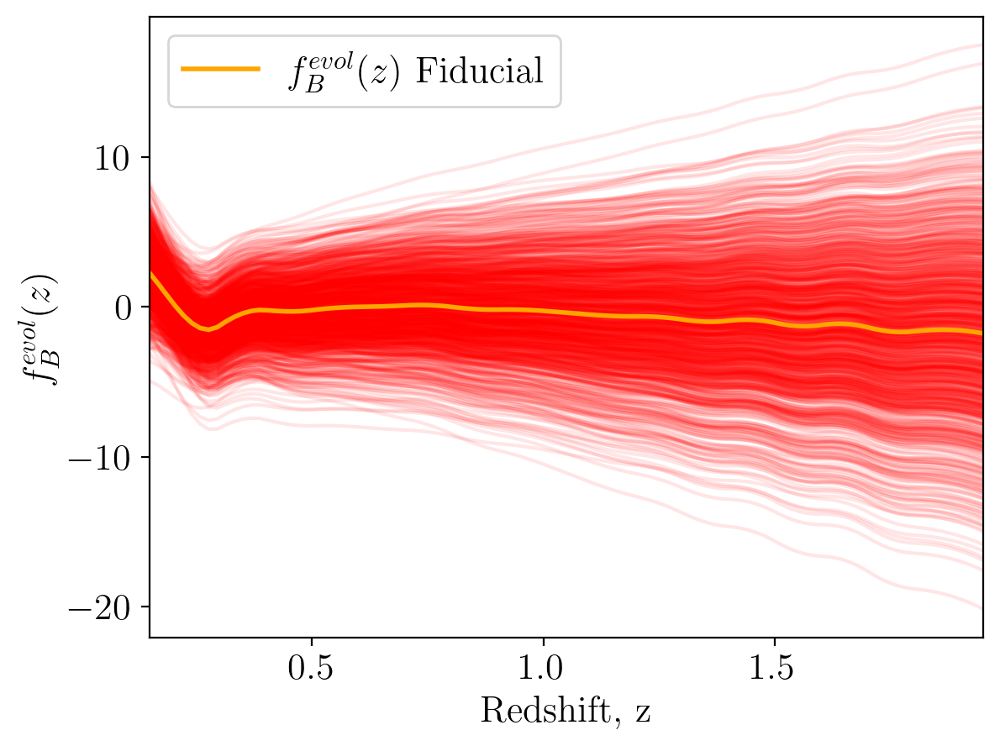

In [37]:
# Plot the fitting function for each sample
for sample in fevol_B_samples:
    plt.plot(z_lin, sample, color='red', alpha=0.1)
    
plt.plot(z_lin, fevol_B_fid, '-', color='orange', label=r'$f^{evol}_B(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
plt.legend();

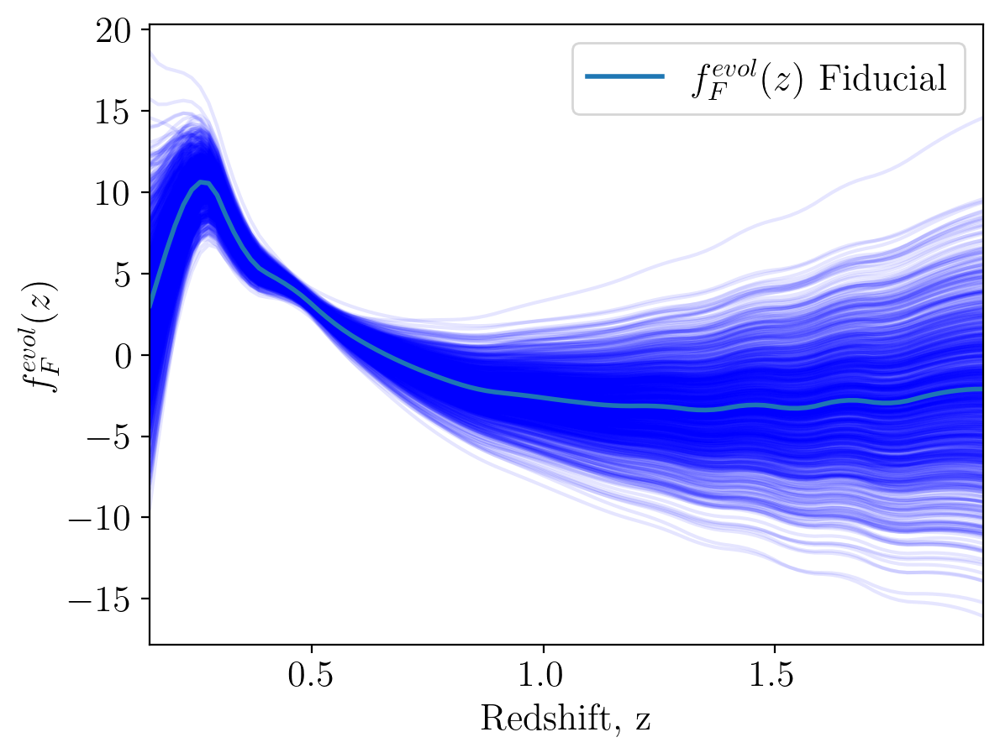

In [38]:
# Plot the fitting function for each sample
for sample in fevol_F_samples:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.plot(z_lin, fevol_F_fid, '-', label=r'$f^{evol}_F(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_F(z)$')
plt.legend();

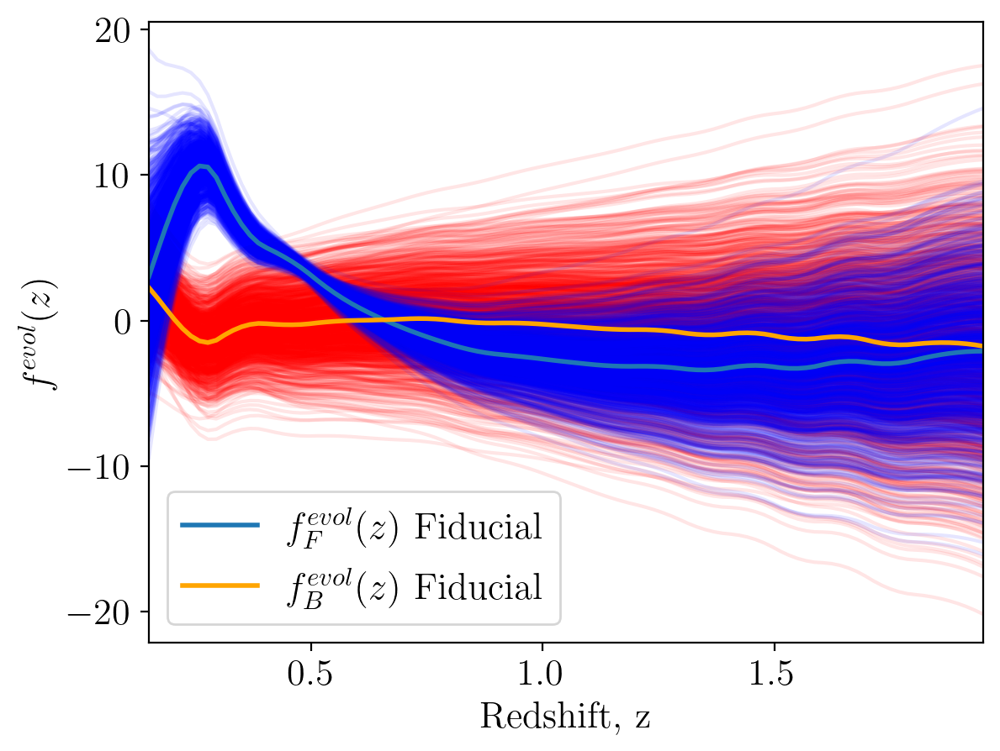

In [39]:
# Plot the fitting function for each sample
for sample in fevol_B_samples:
    plt.plot(z_lin, sample, color='red', alpha=0.1)

for sample in fevol_F_samples:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.plot(z_lin, fevol_F_fid, '-', label=r'$f^{evol}_F(z)$'+' Fiducial', lw = 2.0)
plt.plot(z_lin, fevol_B_fid, '-', color='orange', label=r'$f^{evol}_B(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}(z)$')
plt.legend();

Text(0, 0.5, '$f^{evol}_B(z)$')

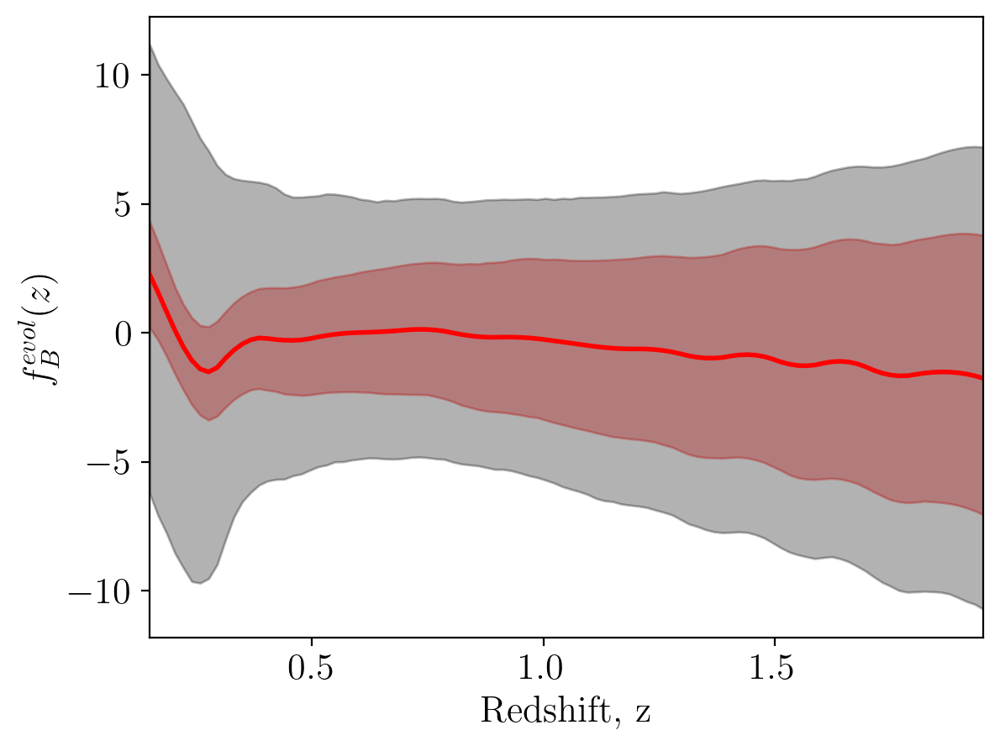

In [40]:
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_B_lower_bound, fevol_B_upper_bound, color='red', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound_priors, fevol_B_upper_bound_priors, color='black', alpha=0.3)


plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')

Text(0, 0.5, '$f^{evol}_F(z)$')

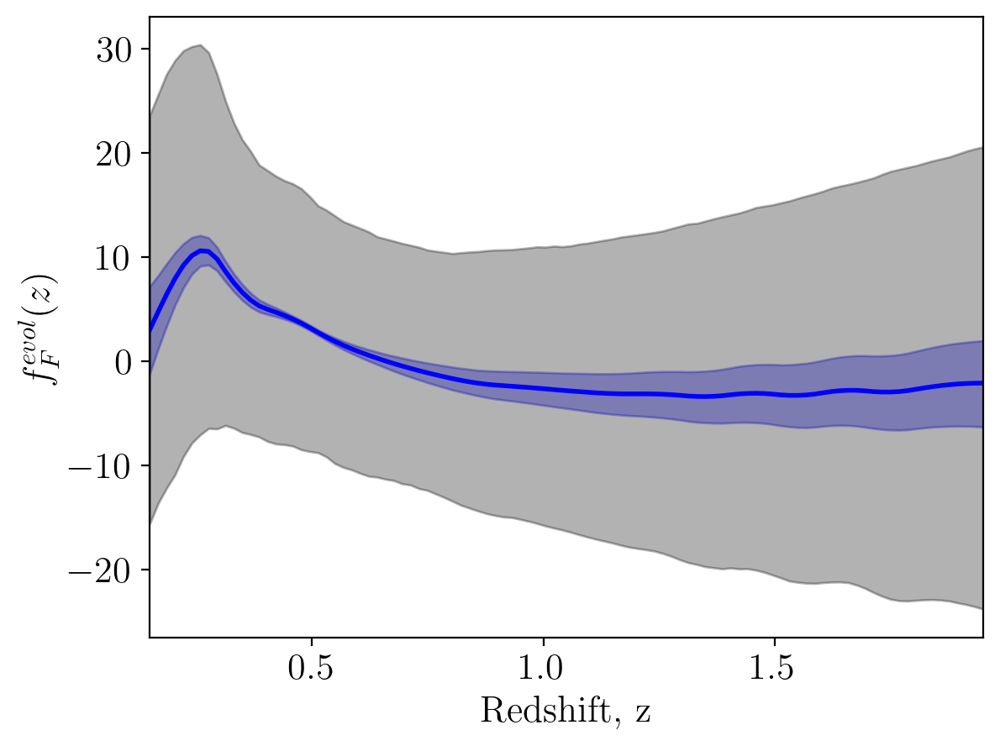

In [41]:
plt.plot(z_lin, fevol_F_fid, '-', color='blue', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_F_lower_bound, fevol_F_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound_priors, fevol_F_upper_bound_priors, color='black', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_F(z)$')

## Include the octupole

### Neglect cross-variance

We include the octupole in the previous analysis. We neglect the cross correlation between the octupole and the other multipoles (it only has non-zero cross-correlations with the dipole).

In [13]:
# Create the Cov Matrix for sB, sF, fevolB, fevolF

errB = [2e-1, 2e-1]
errF = [2e-1, 2e-1]

sB_4fit = np.array([-0.93372809,  1.82432411, -0.92835543, -0.24102824])
sF_4fit = np.array([-0.19376095,  1.0747336,  -0.07806247, -0.00558005])
nevol_fid = np.array([7.94599875, -12.03752387,   2.29927261, -15.83887369])

num_fit = nevol_fid

dsB_19bins = sB_4fit * errB[0] 
dsF_19bins = sF_4fit * errF[0]
dnum_19bins = num_fit * errB[1]

Cov_all_19bins = np.diag(np.concatenate([dsB_19bins**2, dsF_19bins**2, dnum_19bins**2]))

Inv_Cov_oct_all_19bins = np.linalg.inv(Cov_all_19bins)

Inv_Cov_oct_prior_all = np.zeros([len(dsignal_dtheta_fit_all), len(dsignal_dtheta_fit_all)])
Inv_Cov_oct_prior_all[:len(Inv_Cov_oct_all_19bins), :len(Inv_Cov_oct_all_19bins)] = Inv_Cov_oct_all_19bins

Cov_oct_multipoles_19bins = np.array(Cov_multipoles_19bins)

np.shape(Cov_oct_multipoles_19bins)

(19, 324, 324)

In [14]:
8*n_sep

288

In [15]:
# Remove cross-variance dip - oct

Cov_oct_multipoles_19bins[:,int(8*n_sep):int(9*n_sep), int(3*n_sep):int(4*n_sep)] = np.zeros_like(Cov_oct_multipoles_19bins[0,int(8*n_sep):int(9*n_sep), int(3*n_sep):int(4*n_sep)])
Cov_oct_multipoles_19bins[:, int(3*n_sep):int(4*n_sep), int(8*n_sep):int(9*n_sep) ] = np.zeros_like(Cov_oct_multipoles_19bins[0,int(8*n_sep):int(9*n_sep), int(3*n_sep):int(4*n_sep)])


In [16]:
# Fisher Matrix

Inv_Cov_oct_multipoles_19bins = np.array([np.linalg.inv(Cov_oct_multipoles_19bins[k]) for k,_ in enumerate(z_bins)])

Fisher_Matrix_oct_multipoles_19bins = fm.fisher_matrix(d_signal = dsignal_dtheta_fit_all, inv_cov = Inv_Cov_oct_multipoles_19bins, z_bins = z_bins)
Fisher_Matrix_oct_all_19bins = Fisher_Matrix_oct_multipoles_19bins + Inv_Cov_oct_prior_all

Sigma_Matrix_oct_all_19bins = np.linalg.inv(Fisher_Matrix_oct_all_19bins)

np.shape(Sigma_Matrix_oct_all_19bins)


 ... Computing the Fisher Matrix ... 

Signal & Cov must be given as functions (z,d) and (z,d,d') respectively. 


 ... Success! ... 



(21, 21)

#### Constraints

In [17]:
#Absolute Errors

Abs_Errors_oct_all_19bins = np.sqrt(np.diag(Sigma_Matrix_oct_all_19bins))

# Fiducial values

sbias_fid = np.concatenate([sB_4fit, sF_4fit])
num_fid = num_fit
gbias_fid = np.concatenate([np.array([0.554, 0.783]), np.array([0.554, 0.783])])
cosmic_fid = np.fromiter(params_dict0.values(), dtype=float)
cosmic_fid[1] = np.log(10**10 * cosmic_fid[1])

params_fid = np.concatenate([sbias_fid, num_fid, gbias_fid, cosmic_fid])

# Relative errors

Rel_Errors_oct_all_19bins = np.abs(Abs_Errors_oct_all_19bins/params_fid)

params_errors_oct_all_19bins = Rel_Errors_oct_all_19bins * 100

print()
print('------------ Relative errors * 100 ------------' )
print()
print('sbias = ', params_errors_oct_all_19bins[0:len(sbias_fid)])
print()
print('number = ', params_errors_oct_all_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))])
print()
print('gbias = ', params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))])
print()
print('cosmic = ', params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid)+len(gbias_fid)):])


------------ Relative errors * 100 ------------

sbias =  [11.80151424  9.01583111 10.37216946 12.71099567 16.32084733 13.99200604
 17.79803933 19.96299088]

number =  [17.32312846 16.05188437 14.36146918 14.51482608]

gbias =  [0.39519997 0.33810213 0.16113816 0.3064184 ]

cosmic =  [1.17875706 0.75546725 0.97954159 1.18313639 0.53872795]


#### Plots

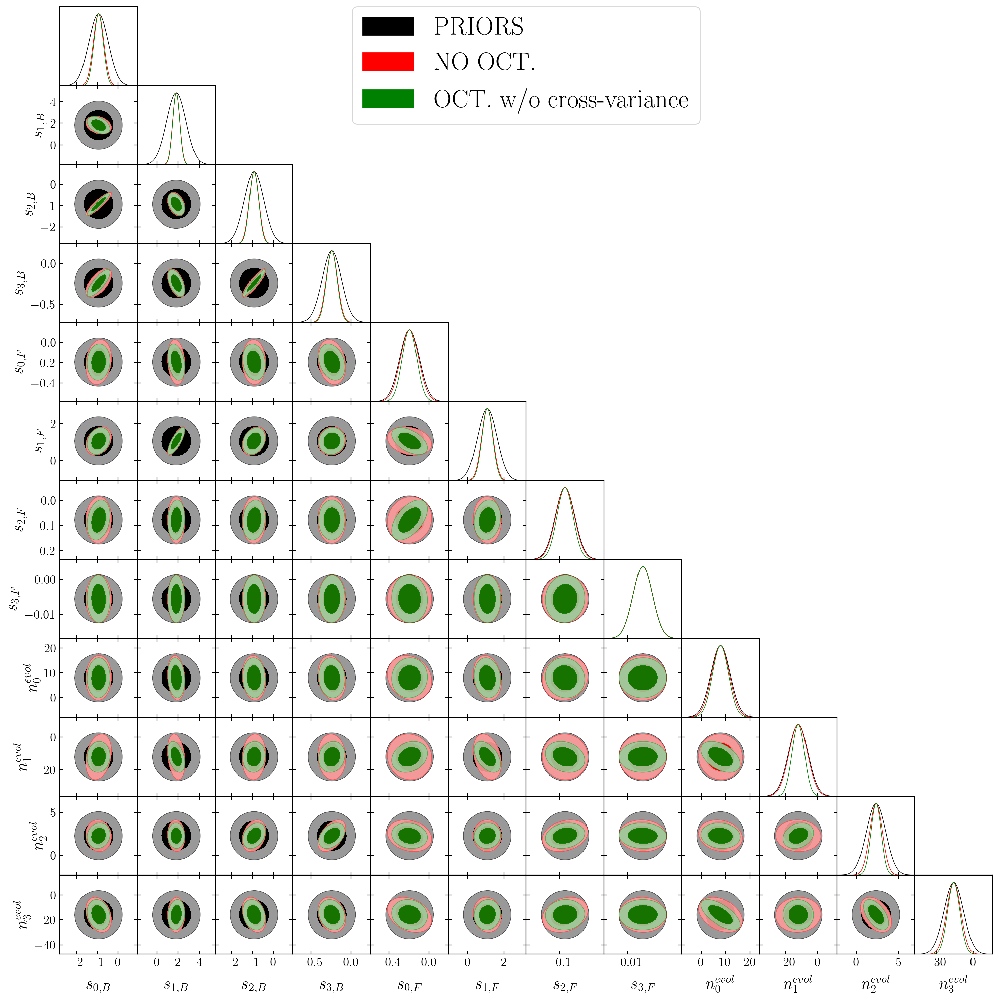

In [164]:
# Triangle plot

mean = np.concatenate([sB_4fit, sF_4fit, num_fit])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

num_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

num_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names + sF_names + num_names 
labels = sB_labels + sF_labels + num_labels 

GaussDist_oct_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_oct_all_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_noct_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_ini_sbias_fbias_fit = GaussianND(mean, Cov_all_19bins, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=15)
g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=18
g.settings.axes_labelsize=22
g.settings.axis_tick_max_labels=6

g.triangle_plot([GaussDist_ini_sbias_fbias_fit, GaussDist_sbias_fbias_fit ,GaussDist_oct_sbias_fbias_fit], param_names,
                filled=True, 
                legend_labels=['PRIORS', 'NO OCT.', 'OCT. w/o cross-variance'],
                contour_colors=['black', 'red', 'green'])

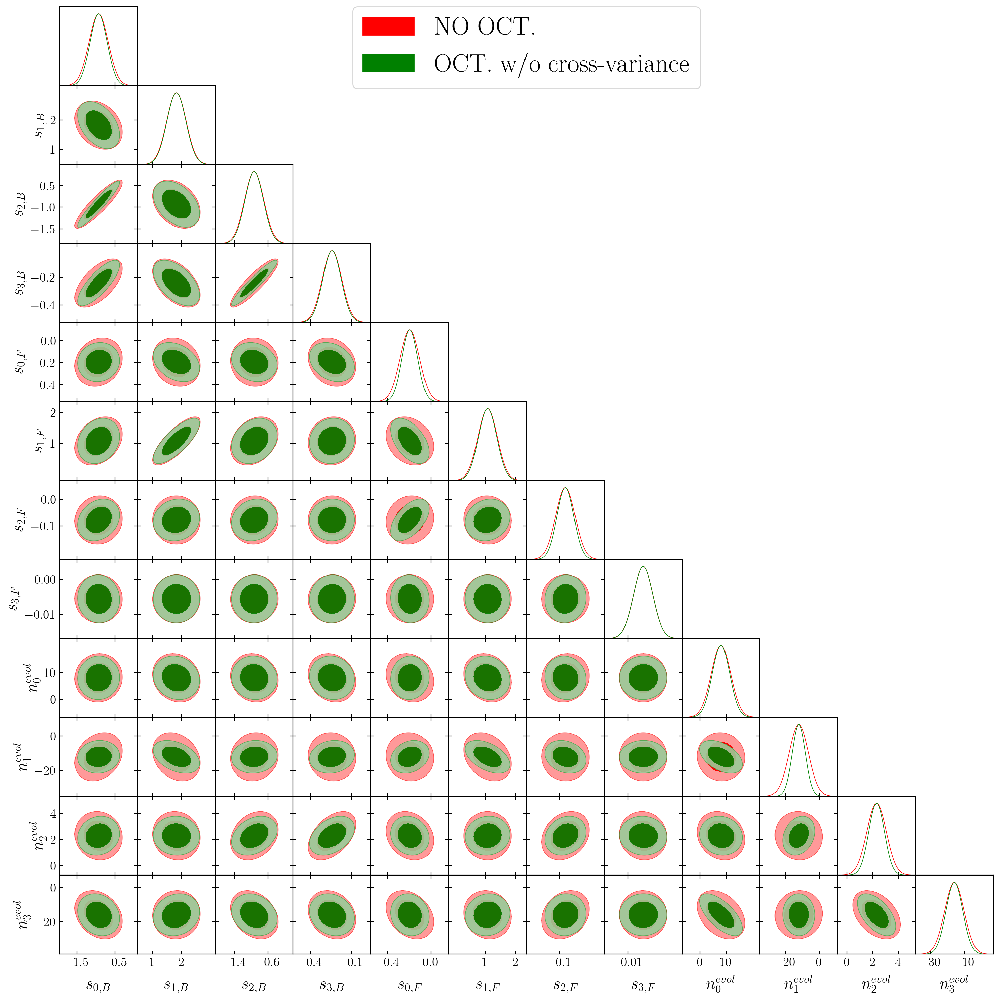

In [165]:
# Triangle plot

mean = np.concatenate([sB_4fit, sF_4fit, num_fit])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

num_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

num_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names + sF_names + num_names 
labels = sB_labels + sF_labels + num_labels 

GaussDist_oct_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_oct_all_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_noct_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_ini_sbias_fbias_fit = GaussianND(mean, Cov_all_19bins, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=15)

g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=18
g.settings.axes_labelsize=22
g.settings.axis_tick_max_labels=6

g.triangle_plot([GaussDist_sbias_fbias_fit ,GaussDist_oct_sbias_fbias_fit], param_names,
                filled=True, 
                legend_labels=['NO OCT.', 'OCT. w/o cross-variance'],
                contour_colors=['red', 'green'])

#g.export('plots/tri_plot_st_vs_oct_50x50.pdf')

In [166]:
# Remove sF and fevolB params

rows_to_remove = np.r_[4:8, 12:len(Sigma_Matrix_oct_all_19bins)]

Sigma_Matrix_oct_all_19bins_ = np.delete(Sigma_Matrix_oct_all_19bins, rows_to_remove, axis=0)
Sigma_Matrix_oct_all_19bins_ = np.delete(Sigma_Matrix_oct_all_19bins_, rows_to_remove, axis=1)

Cov_all_19bins_ = np.delete(Cov_all_19bins, np.r_[4:8], axis=0)
Cov_all_19bins_ = np.delete(Cov_all_19bins_, np.r_[4:8], axis=1)

np.shape(Sigma_Matrix_oct_all_19bins_), np.shape(Cov_all_19bins_)

((8, 8), (8, 8))

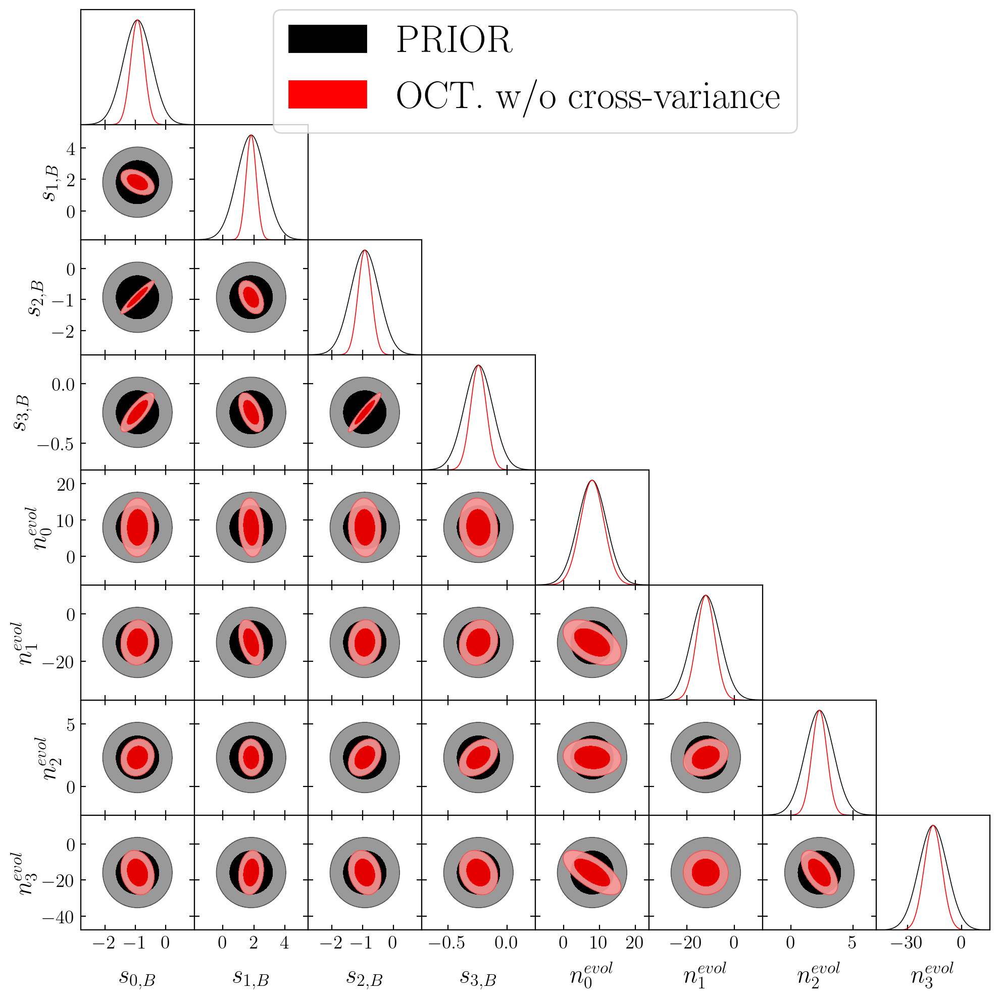

In [167]:
# Triangle plot

mean = np.concatenate([sB_4fit, num_fit])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

fB_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

fB_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names +  fB_names
labels = sB_labels + fB_labels

GaussDist_oct_sbias_fbias_fit_ = GaussianND(mean, Sigma_Matrix_oct_all_19bins_, labels = labels, names = param_names)
GaussDist_ini_sbias_fbias_fit_ = GaussianND(mean, Cov_all_19bins_, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=10)
g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=18
g.settings.axes_labelsize=22
g.settings.axis_tick_max_labels=6

g.triangle_plot([GaussDist_ini_sbias_fbias_fit_, GaussDist_oct_sbias_fbias_fit_], param_names, 
                filled=True, 
                legend_labels=['PRIOR', 'OCT. w/o cross-variance'],
                contour_colors=['black', 'red'])

#### Comparing with and without OCTUPOLE w/0 cross-variance

Compute the improvement in %

In [18]:
print('------------ Relative errors with octupole * 100 ------------' )
print()
print('sbias = ', params_errors_oct_all_19bins[0:len(sbias_fid)])
print()
print('number = ', params_errors_oct_all_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))])

------------ Relative errors with octupole * 100 ------------

sbias =  [11.80151424  9.01583111 10.37216946 12.71099567 16.32084733 13.99200604
 17.79803933 19.96299088]

number =  [17.32312846 16.05188437 14.36146918 14.51482608]


In [19]:
print('------------ Relative errors without octupole * 100 ------------' )
print()
print('sbias = ', params_errors_noct_19bins[0:len(sbias_fid)])
print()
print('number = ', params_errors_noct_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))])

------------ Relative errors without octupole * 100 ------------

sbias =  [12.49690145  9.28232653 10.49348593 13.11050653 18.50862769 14.72545191
 19.28378534 19.98396027]

number =  [18.6255772  19.35767768 15.49220771 15.51695965]


In [20]:
print('------------ Improvement * 100 ------------' )
print()
print('sbias = ', (1-params_errors_oct_all_19bins[0:len(sbias_fid)]/params_errors_noct_19bins[0:len(sbias_fid)]) * 100)
print()
print('number = ', (1-params_errors_oct_all_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))]/params_errors_noct_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))]) * 100)

------------ Improvement * 100 ------------

sbias =  [ 5.56447702  2.87099803  1.15611219  3.04725727 11.82032723  4.98080379
  7.70463881  0.10493108]

number =  [ 6.99279665 17.07742719  7.29875662  6.45831139]


In [21]:
# Galaxy bias and Cosmic params

print('------------ Relative errors with octupole * 100 ------------' )
print()
print('gbias = ', params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))])
print()
print('cosmic = ', params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid) + len(gbias_fid)):])

print('\n------------ Relative errors without octupole * 100 ------------' )
print()
print('gbias = ', params_errors_noct_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))])
print()
print('cosmic = ', params_errors_noct_19bins[(len(sbias_fid) + len(num_fid) + len(gbias_fid)):])

print('\n------------ Improvement * 100 ------------' )
print()
print('gbias = ', (1-params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))]/params_errors_noct_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))]) * 100)
print()
print('cosmic = ', (1-params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid) + len(gbias_fid)):]/params_errors_noct_19bins[(len(sbias_fid) + len(num_fid) + len(gbias_fid)):]) * 100)

------------ Relative errors with octupole * 100 ------------

gbias =  [0.39519997 0.33810213 0.16113816 0.3064184 ]

cosmic =  [1.17875706 0.75546725 0.97954159 1.18313639 0.53872795]

------------ Relative errors without octupole * 100 ------------

gbias =  [0.39521786 0.33811297 0.16114476 0.3064237 ]

cosmic =  [1.17877091 0.75547588 0.97956221 1.1831462  0.5387367 ]

------------ Improvement * 100 ------------

gbias =  [0.00452543 0.00320412 0.00409823 0.00172804]

cosmic =  [0.00117514 0.00114192 0.00210491 0.00082935 0.00162389]


#### Full triangle plot

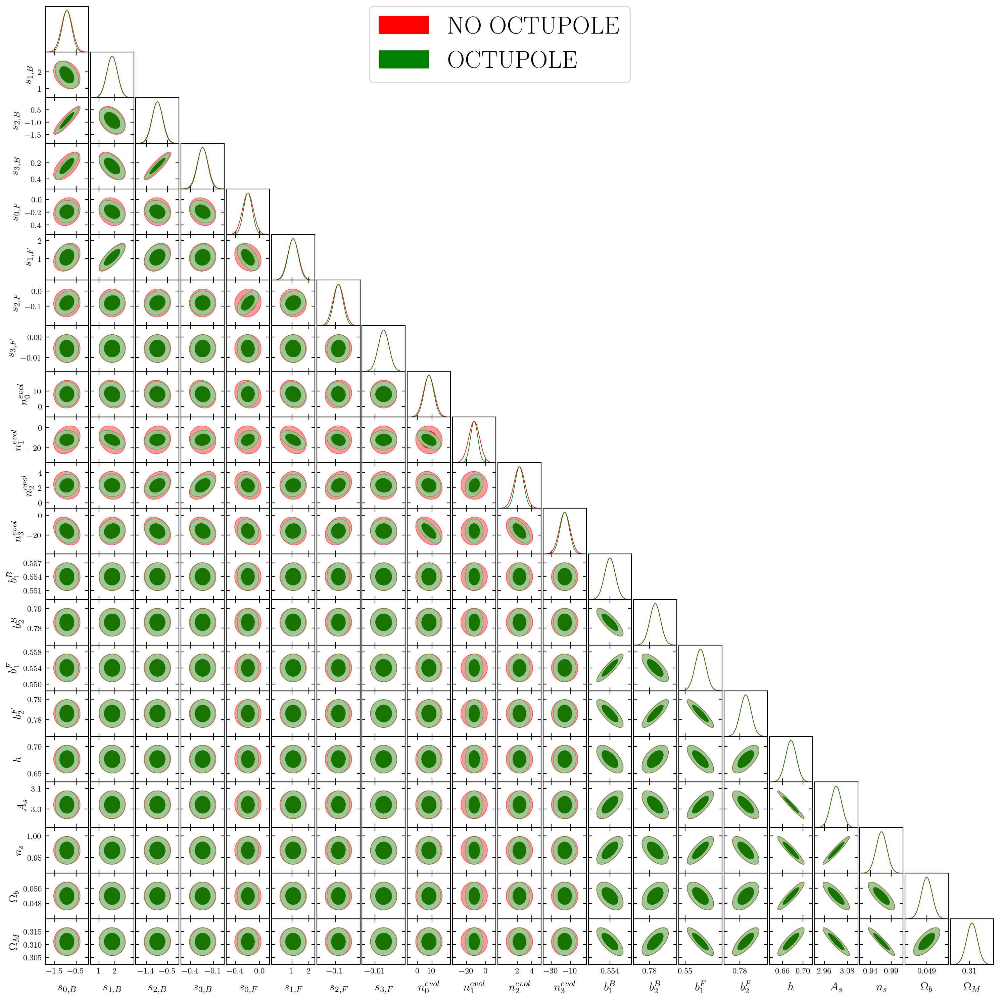

In [172]:
# Triangle plot

mean = np.concatenate([sB_4fit, sF_4fit, num_fit, gbias_fid, cosmic_fid])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

fB_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

fB_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names + sF_names + fB_names + ['b1B', 'b2B', 'b1F', 'b2F'] + ['h', 'As', 'ns', 'Ob', 'OM']
labels = sB_labels + sF_labels + fB_labels + [r'b_1^B', r'b_2^B', r'b_1^F', r'b_2^F'] + [r'h', r'A_s', r'n_s', r'\Omega_b', r'\Omega_M']

GaussDist_oct_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_oct_all_19bins, labels = labels, names = param_names)
GaussDist_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_noct_19bins, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=15)
g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=14
g.settings.axes_labelsize=18
g.settings.axis_tick_max_labels=4

g.triangle_plot([GaussDist_sbias_fbias_fit, GaussDist_oct_sbias_fbias_fit], param_names, 
                filled=True, 
                legend_labels=['NO OCTUPOLE', 'OCTUPOLE'],
                contour_colors=['red', 'green'])

#### Predictions

##### Magnification bias

In [52]:
# Magnification bias fit

def magbias_fit(params, x):
    a, b, c, d = params
    return  a + b * x + c * np.log(x) + d * (np.log(x))**2

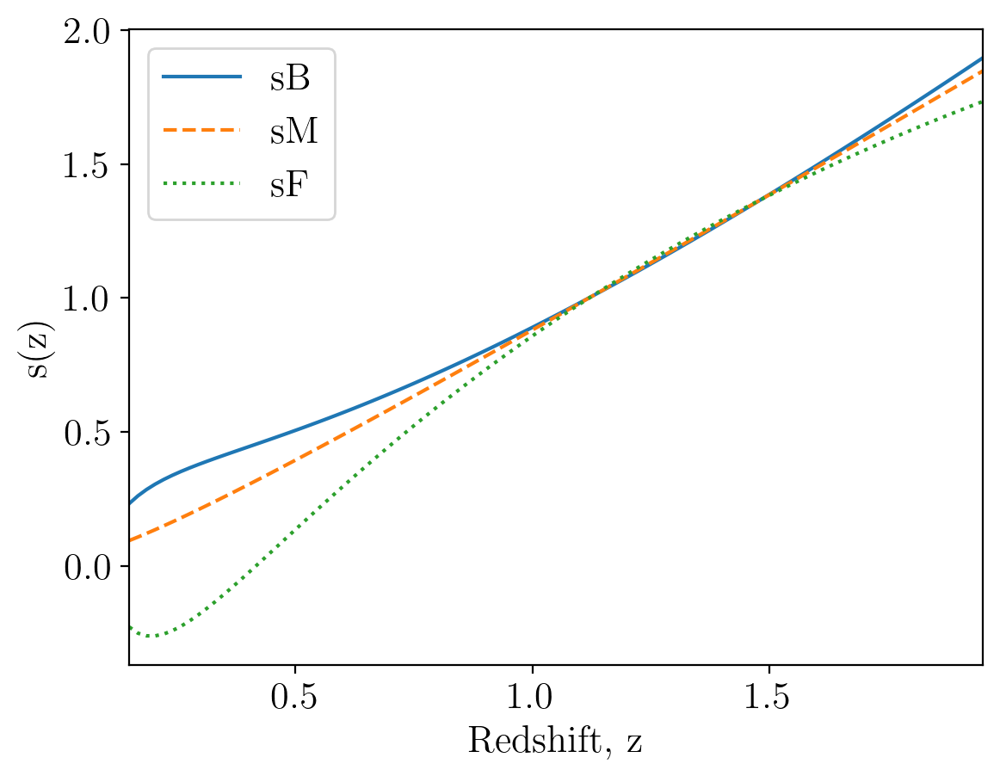

In [53]:
z_lin = np.linspace(z_bins[0], z_bins[-1], 100)
m_split = 10/7

sB_fid = magbias_fit(sB_4fit, z_lin)
sM_fid = magbias_fit(sF_4fit, z_lin)
sF_fid = sM_fid * (m_split/(m_split-1)) - sB_fid/(m_split-1)

plt.plot(z_lin, sB_fid, '-', label=r'sB')
plt.plot(z_lin, sM_fid, '--', label=r'sM')
plt.plot(z_lin, sF_fid, ':', label=r'sF')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.legend();


###### Compare the two observables

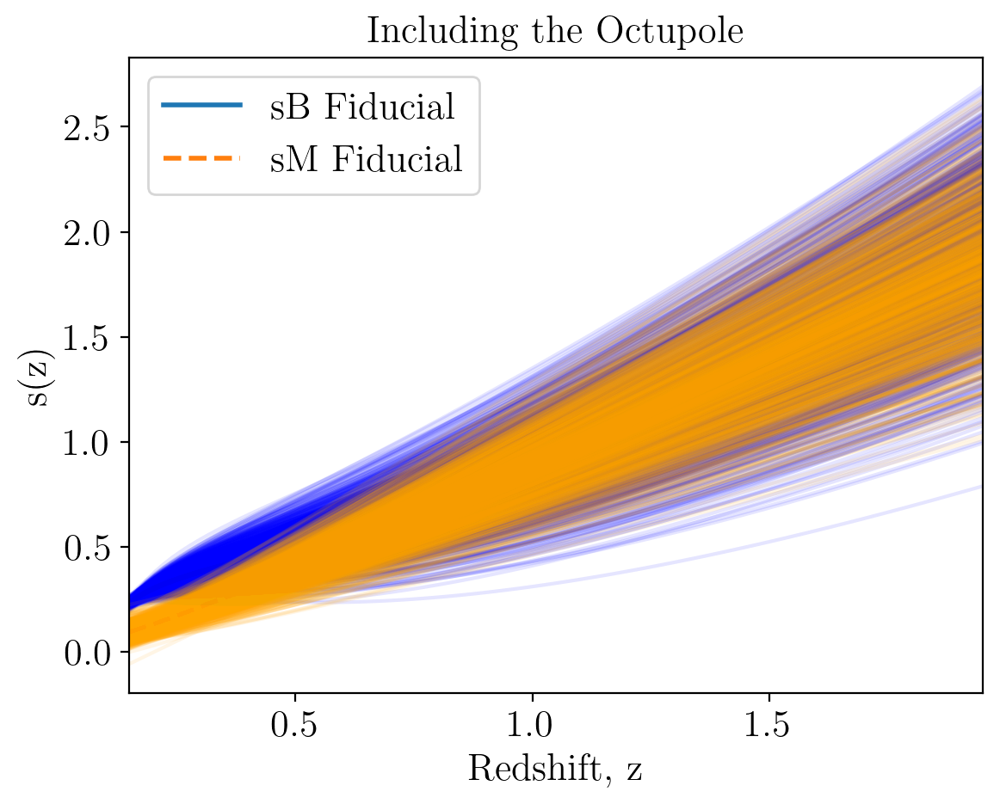

In [54]:
# Select the marginalized covariance matrix for the magnification biases

cov_sB_ = Sigma_Matrix_oct_all_19bins[:4, :4]
cov_sM_ = Sigma_Matrix_oct_all_19bins[4:8, 4:8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sB_pars_samples_ = np.random.multivariate_normal(sB_4fit, cov_sB_, num_samples)
sM_pars_samples_ = np.random.multivariate_normal(sF_4fit, cov_sM_, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_ = np.array([magbias_fit(pars, z_lin) for pars in sB_pars_samples_])
sM_samples_ = np.array([magbias_fit(pars, z_lin) for pars in sM_pars_samples_])

# Calculate the 68% confidence interval
sB_lower_bound_ = np.percentile(sB_samples_, 16, axis=0)
sB_upper_bound_ = np.percentile(sB_samples_, 84, axis=0)
sM_lower_bound_ = np.percentile(sM_samples_, 16, axis=0)
sM_upper_bound_ = np.percentile(sM_samples_, 84, axis=0)

# Step 5: Plotting

plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0)
plt.plot(z_lin, sM_fid, '--', label=r'sM Fiducial', lw = 2.0)

# Plot the fitting function for each sample
for sample in sB_samples_:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)

for sample in sM_samples_:
    plt.plot(z_lin, sample, color='orange', alpha=0.1)
    
plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title(r'Including the Octupole')
plt.legend();


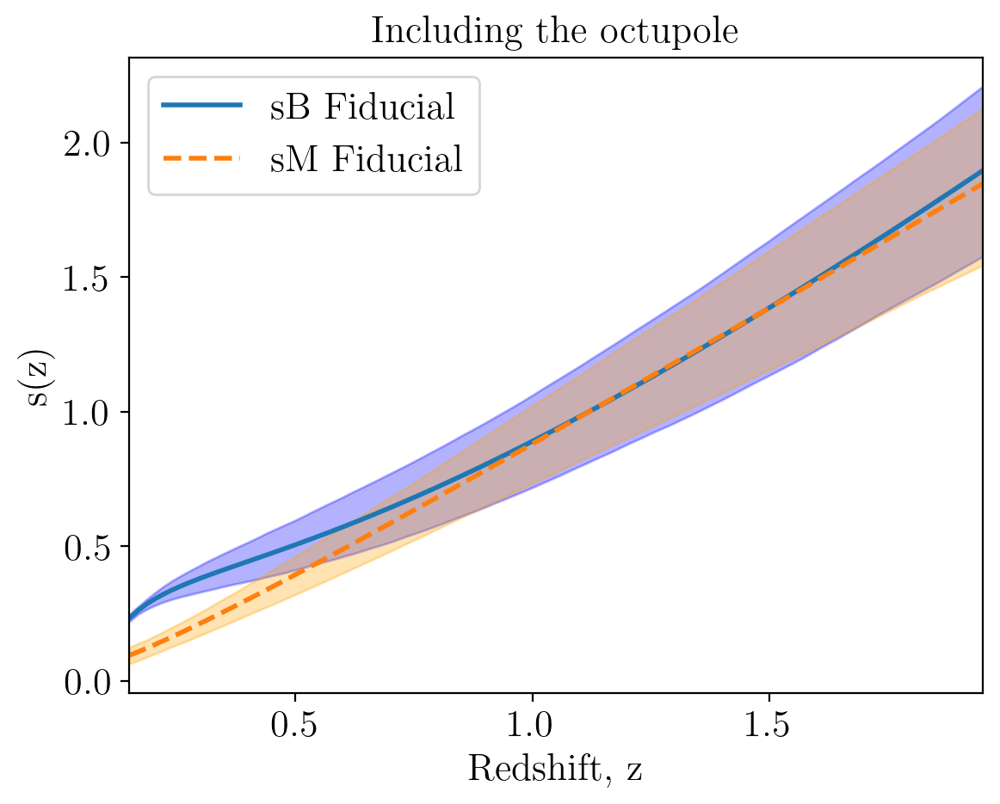

In [55]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0)
plt.plot(z_lin, sM_fid, '--', label=r'sM Fiducial', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_, sB_upper_bound_, color='blue', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound_, sM_upper_bound_, color='orange', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

###### Compare with priors

In [56]:
# Select the marginalized covariance matrix for the magnification biases priors

cov_sB_priors = Cov_all_19bins[:4, :4]
cov_sM_priors = Cov_all_19bins[4:8, 4:8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sB_pars_samples_priors = np.random.multivariate_normal(sB_4fit, cov_sB_priors, num_samples)
sM_pars_samples_priors = np.random.multivariate_normal(sF_4fit, cov_sM_priors, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_priors = np.array([magbias_fit(pars, z_lin) for pars in sB_pars_samples_priors])
sM_samples_priors = np.array([magbias_fit(pars, z_lin) for pars in sM_pars_samples_priors])

# Calculate the 68% confidence interval
sB_lower_bound_priors = np.percentile(sB_samples_priors, 16, axis=0)
sB_upper_bound_priors = np.percentile(sB_samples_priors, 84, axis=0)
sM_lower_bound_priors = np.percentile(sM_samples_priors, 16, axis=0)
sM_upper_bound_priors = np.percentile(sM_samples_priors, 84, axis=0)

Text(0.5, 1.0, 'Prediction vs Prior (with octupole)')

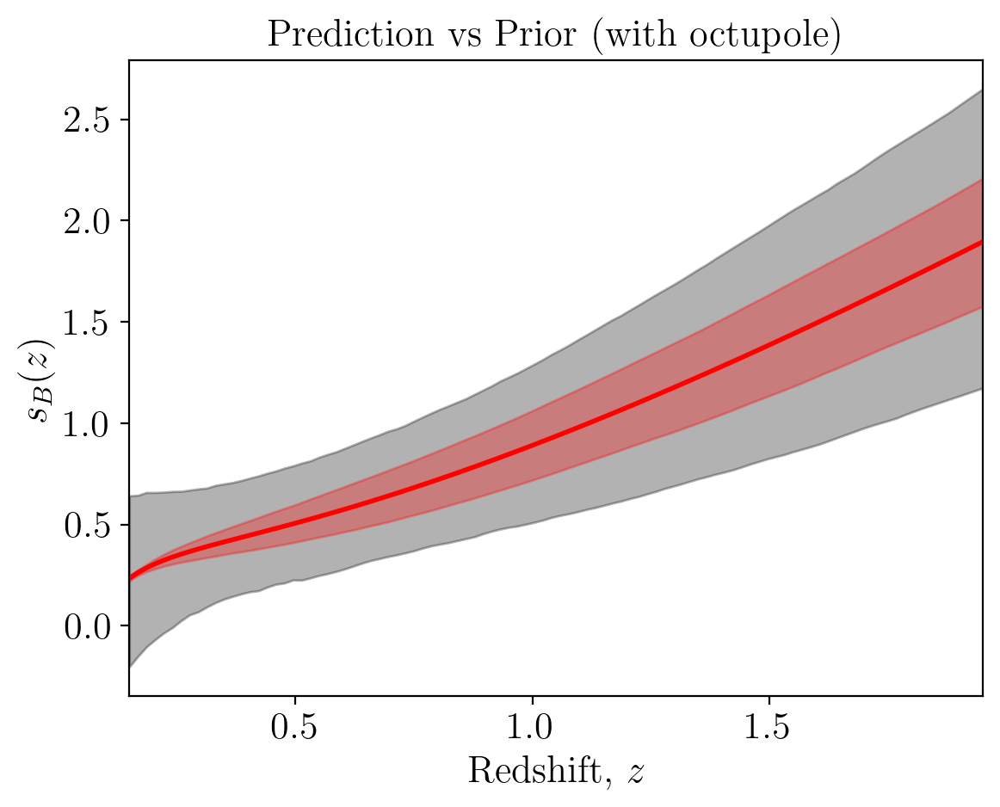

In [57]:
plt.plot(z_lin, sB_fid, '-', lw = 2.0, color='red')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_priors, sB_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound_, sB_upper_bound_, color='red', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_B(z)$');
plt.title(r'Prediction vs Prior (with octupole)')

Text(0.5, 1.0, 'Prediction vs Prior (with octupole)')

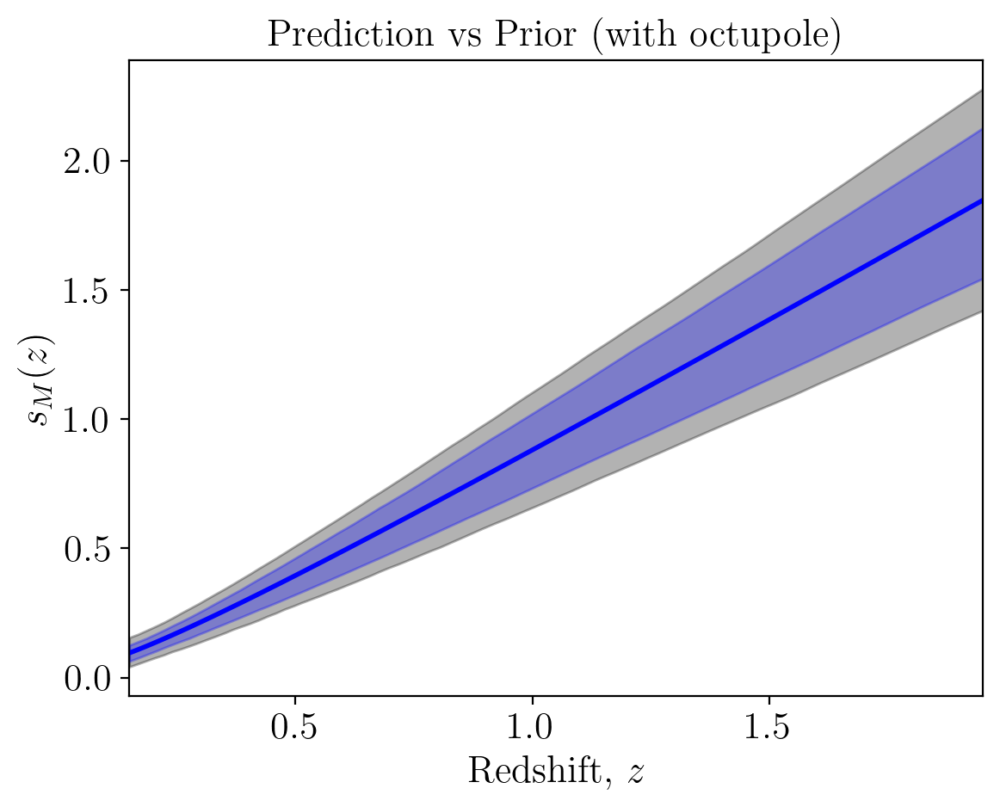

In [58]:
plt.plot(z_lin, sM_fid, '-', lw = 2.0, color='blue')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sM_lower_bound_priors, sM_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound_, sM_upper_bound_, color='blue', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_M(z)$');
plt.title(r'Prediction vs Prior (with octupole)')

###### Compare with no-octupole

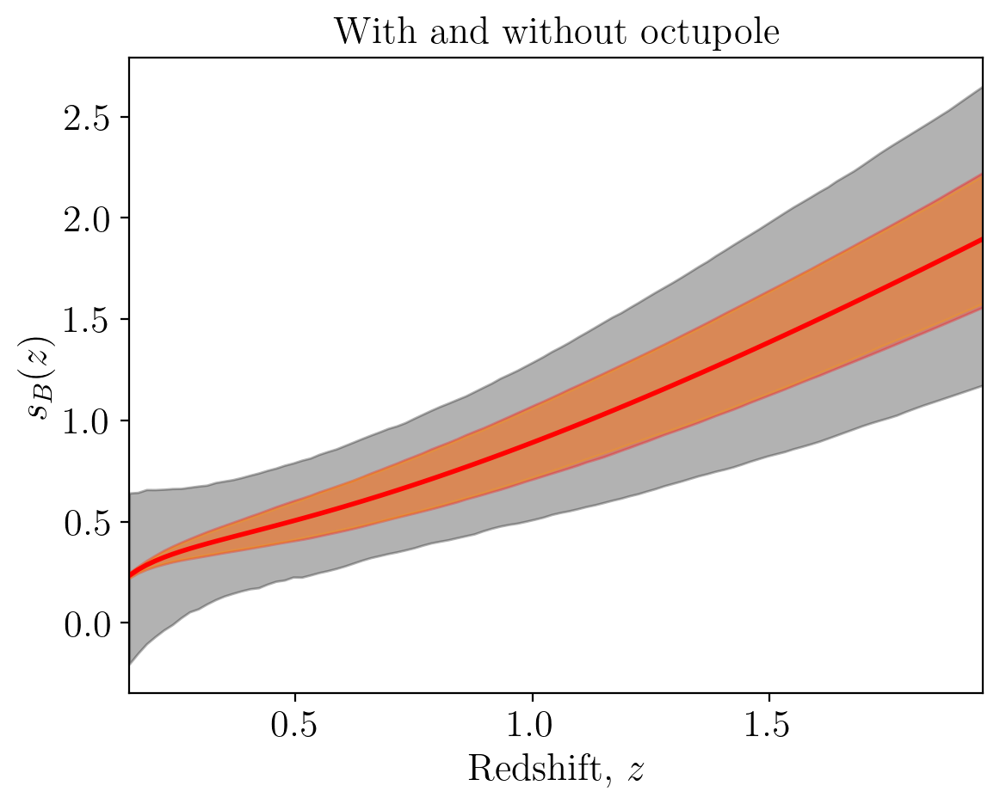

In [59]:
plt.plot(z_lin, sB_fid, '-', lw = 2.0, color='red')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_priors, sB_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='red', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound_, sB_upper_bound_, color='orange', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_B(z)$');
plt.title(r'With and without octupole');

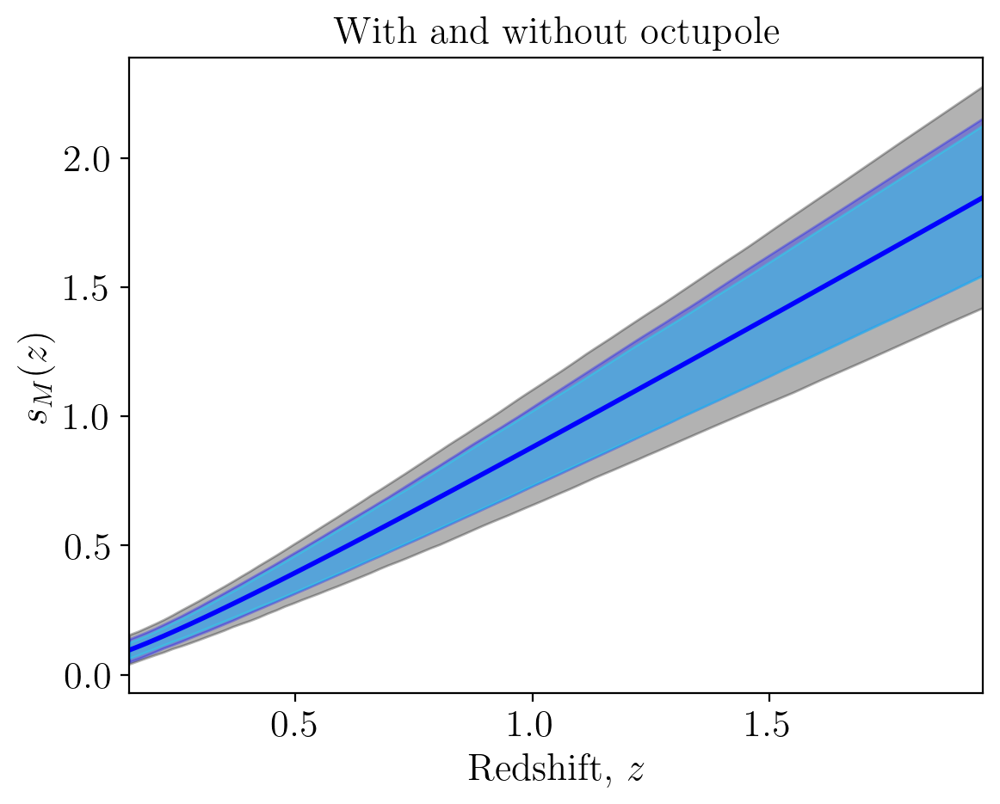

In [60]:
plt.plot(z_lin, sM_fid, '-', lw = 2.0, color='blue')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sM_lower_bound_priors, sM_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound, sM_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound_, sM_upper_bound_, color='cyan', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_M(z)$');
plt.title(r'With and without octupole');

###### Magnification bias of the Faint

The magnification bias of the faint population is obtained by:

$$ s_F(z) = s_{model}(z)\frac{\bar{N}(z)}{\bar{N}_F(z)} - s_B(z)\frac{\bar{N}_B(z)}{\bar{N}_F(z)} = s_F(z) = s_{model}(z)\frac{m}{m-1} - s_B(z)\frac{1}{m-1} $$ 

We need to sample together the $s_B$ and $s_m$ parameters.

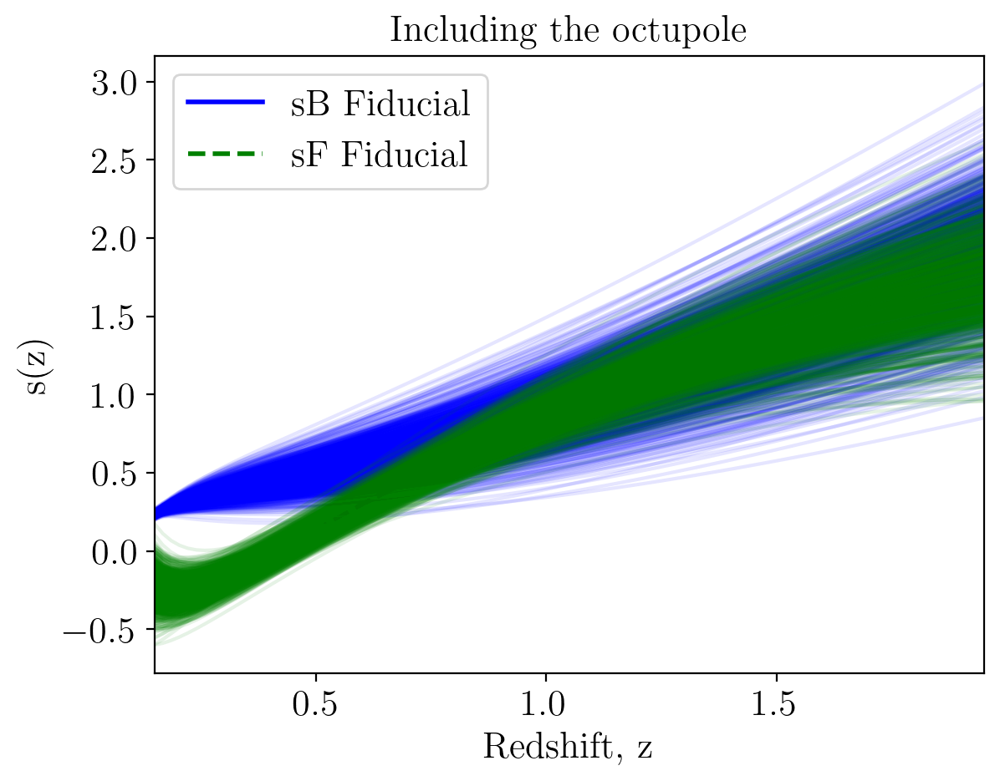

In [61]:
# Select the marginalized covariance matrix for the magnification biases together
cov_sbias_ = Sigma_Matrix_oct_all_19bins[:8, :8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sbias_pars_samples_ = np.random.multivariate_normal(sbias_fid, cov_sbias_, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_ = np.array([magbias_fit(pars[:4], z_lin) for pars in sbias_pars_samples_])
sM_samples_ = np.array([magbias_fit(pars[4:8], z_lin) for pars in sbias_pars_samples_])

# Compute the sF for each sample
sF_samples_ = sM_samples_*m_split/(m_split-1) - sB_samples_/(m_split-1)

# Calculate the 68% confidence interval
sF_lower_bound_ = np.percentile(sF_samples_, 16, axis=0)
sF_upper_bound_ = np.percentile(sF_samples_, 84, axis=0)

# Step 5: Plotting

plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='blue')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='green')

# Plot the fitting function for each sample
for sample in sB_samples_:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)

for sample in sF_samples_:
    plt.plot(z_lin, sample, color='green', alpha=0.1)
    
plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

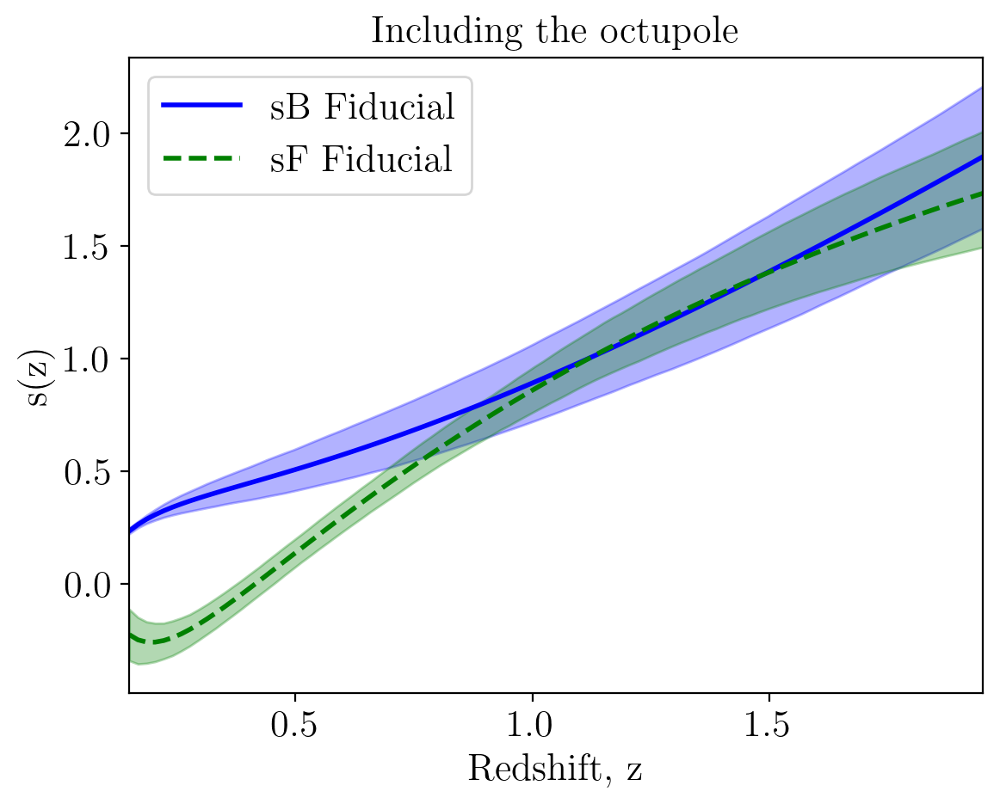

In [62]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='blue')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='green')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_, sB_upper_bound_, color='blue', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_, sF_upper_bound_, color='green', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

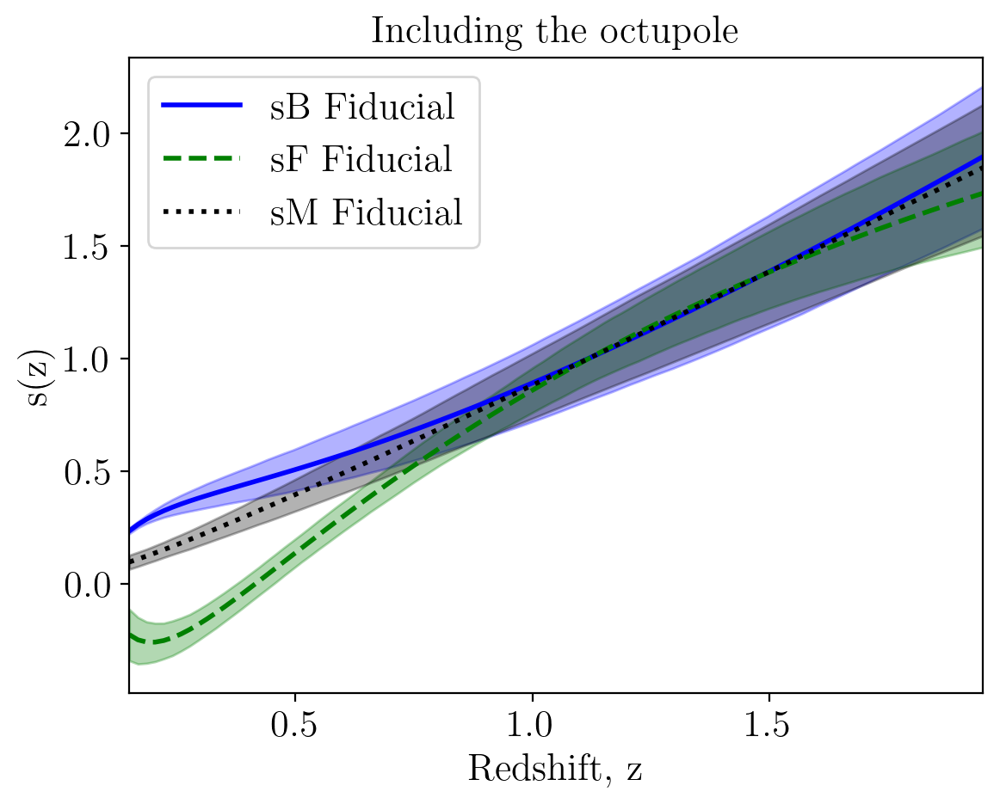

In [63]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='blue')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='green')
plt.plot(z_lin, sM_fid, ':', label=r'sM Fiducial', lw = 2.0, color='black')


# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_, sB_upper_bound_, color='blue', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_, sF_upper_bound_, color='green', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound_, sM_upper_bound_, color='black', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

Compare with priors

In [64]:
# Select the marginalized covariance matrix for the magnification biases together
cov_sbias_priors = Cov_all_19bins[:8, :8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sbias_pars_samples_priors = np.random.multivariate_normal(sbias_fid, cov_sbias_priors, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_priors = np.array([magbias_fit(pars[:4], z_lin) for pars in sbias_pars_samples_priors])
sM_samples_priors = np.array([magbias_fit(pars[4:8], z_lin) for pars in sbias_pars_samples_priors])

# Compute the sF for each sample
sF_samples_priors = sM_samples_priors*m_split/(m_split-1) - sB_samples_priors/(m_split-1)

# Calculate the 68% confidence interval
sF_lower_bound_priors = np.percentile(sF_samples_priors, 16, axis=0)
sF_upper_bound_priors = np.percentile(sF_samples_priors, 84, axis=0)

Text(0.5, 1.0, 'Prediction vs Prior (with octupole)')

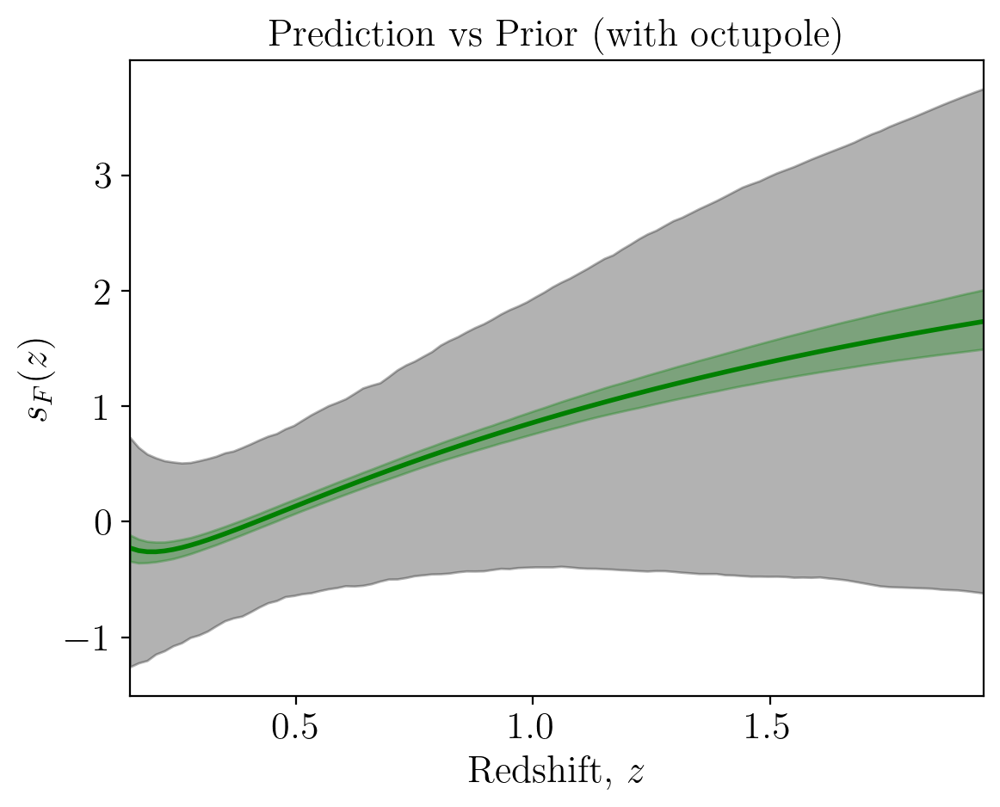

In [65]:
plt.plot(z_lin, sF_fid, '-', lw = 2.0, color='green')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sF_lower_bound_priors, sF_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_, sF_upper_bound_, color='green', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_F(z)$');
plt.title(r'Prediction vs Prior (with octupole)')

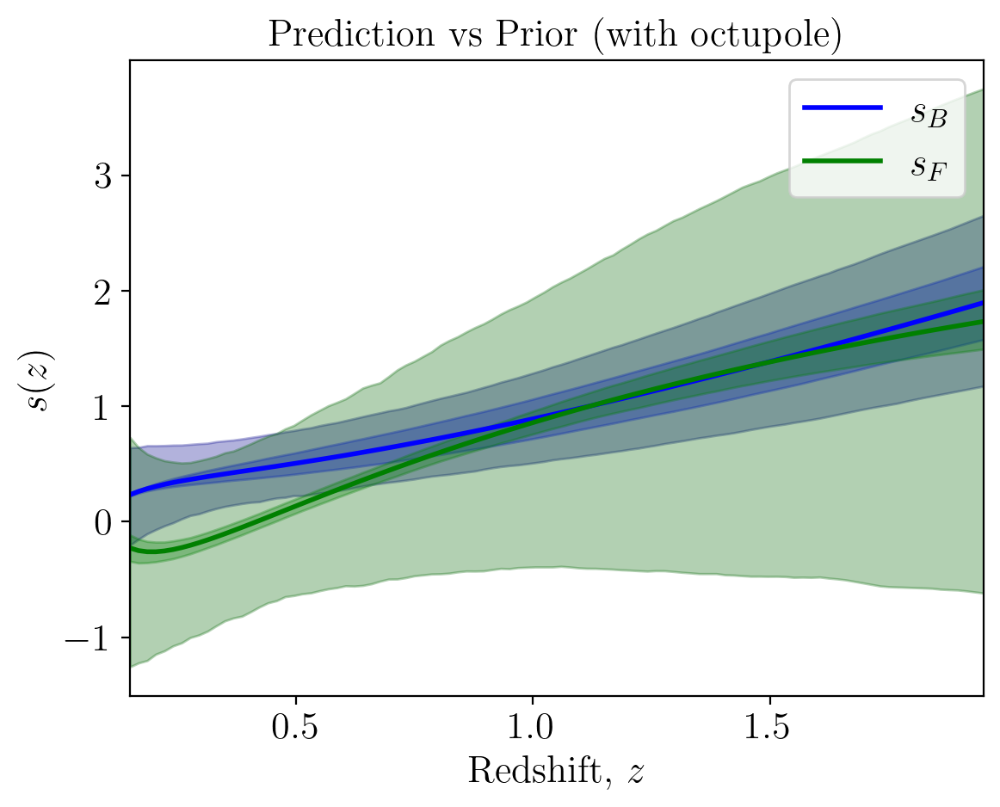

In [66]:
plt.plot(z_lin, sB_fid, '-', lw = 2.0, color='blue', label=r'$s_B$')
plt.plot(z_lin, sF_fid, '-', lw = 2.0, color='green', label=r'$s_F$')


# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_priors, sB_upper_bound_priors, color='darkblue', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound_, sB_upper_bound_, color='blue', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_priors, sF_upper_bound_priors, color='darkgreen', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_, sF_upper_bound_, color='green', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s(z)$');
plt.title(r'Prediction vs Prior (with octupole)');
plt.legend();

Compare with no octupole

Text(0.5, 1.0, 'With and without octupole')

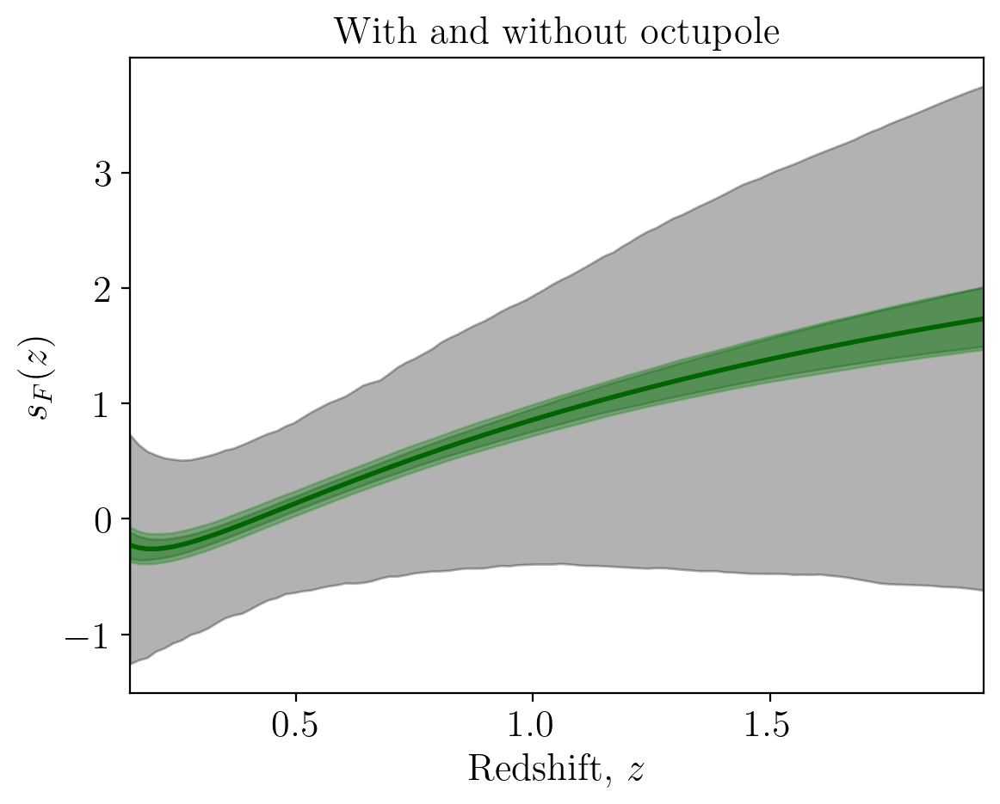

In [67]:
plt.plot(z_lin, sF_fid, '-', lw = 2.0, color='darkgreen')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sF_lower_bound_priors, sF_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound, sF_upper_bound, color='green', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_, sF_upper_bound_, color='darkgreen', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_F(z)$');
plt.title(r'With and without octupole')

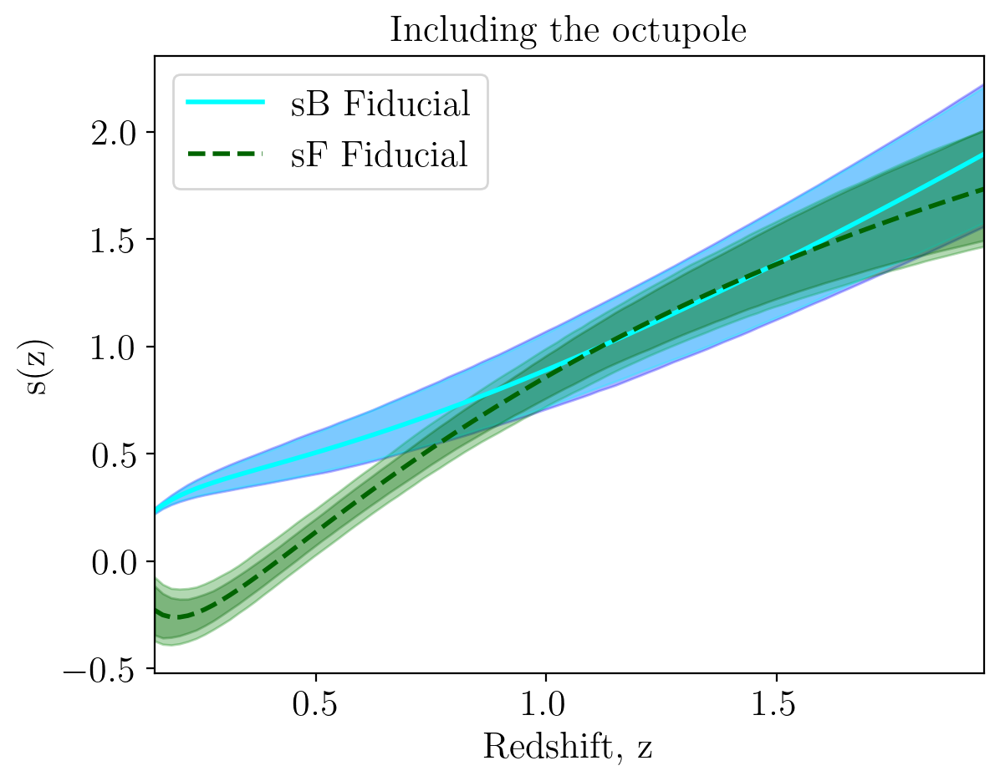

In [68]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='cyan')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='darkgreen')

# Shade the 68% confidence interval
plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound, sF_upper_bound, color='green', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound_, sB_upper_bound_, color='cyan', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_, sF_upper_bound_, color='darkgreen', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

##### Number evolution

In [69]:
def nevol_fit(params, x):
    a, b, c, d = params
    return a + b * x + c * (1/x) + d * np.exp(-x)

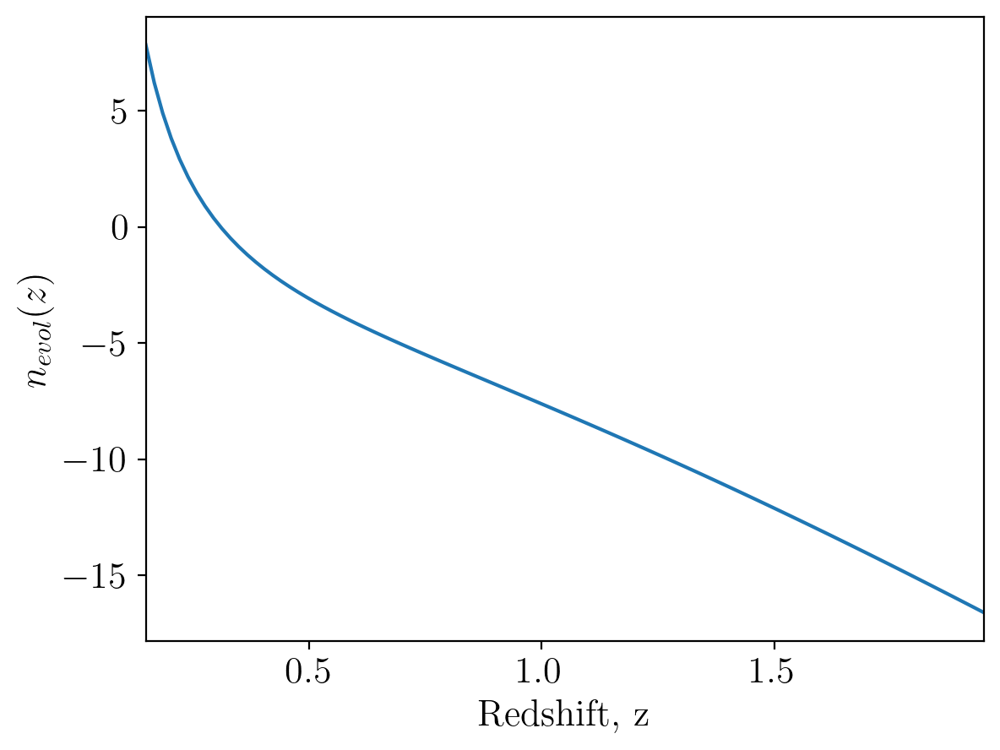

In [70]:
z_lin = np.linspace(z_bins[0], z_bins[-1], 100)
m_split = 10/7

num_evol_fid = nevol_fit(nevol_fid, z_lin)

plt.plot(z_lin, num_evol_fid, '-')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$n_{evol}(z)$');

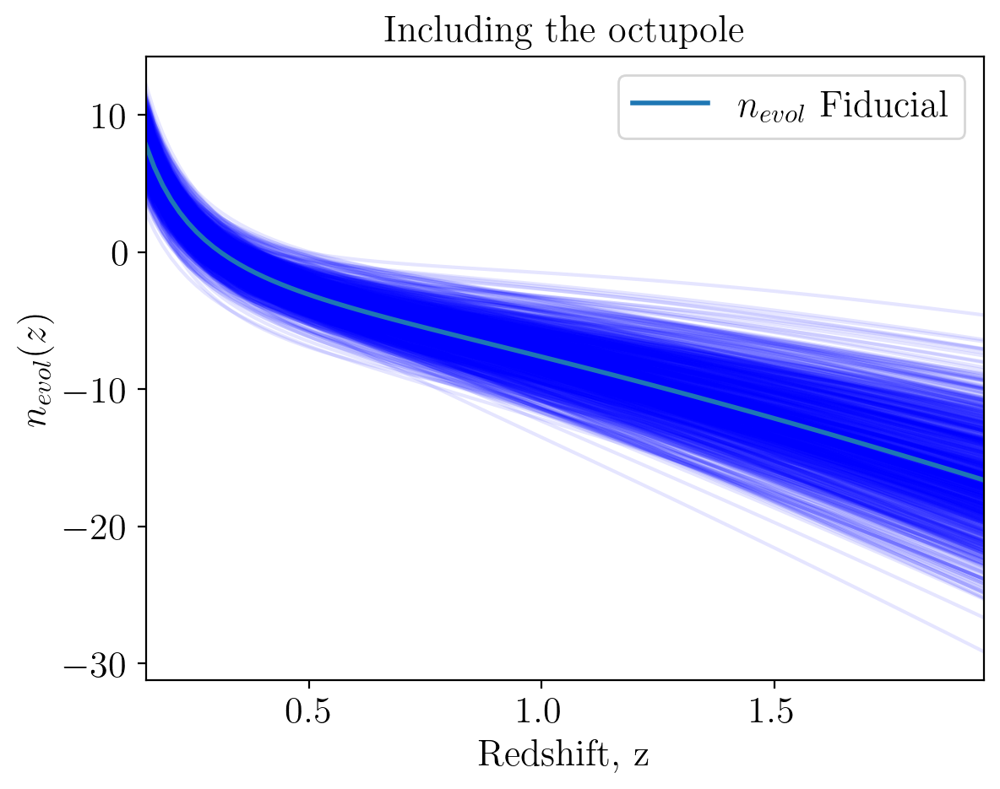

In [71]:
# Select the marginalized covariance matrix for the number evolution
cov_numevol_ = Sigma_Matrix_oct_all_19bins[8:12, 8:12]
cov_numevol_priors = Cov_all_19bins[8:12, 8:12]


# Generate parameter samples from multivariate normal distribution
num_samples = 1000
nevol_pars_samples_ = np.random.multivariate_normal(nevol_fid, cov_numevol_, num_samples)
nevol_samples_priors = np.random.multivariate_normal(nevol_fid, cov_numevol_priors, num_samples)


# Evaluate fitting function for each parameter sample
nevol_samples_ = np.array([nevol_fit(pars, z_lin) for pars in nevol_pars_samples_])
nevol_samples_priors = np.array([nevol_fit(pars, z_lin) for pars in nevol_samples_priors])

# Calculate the 68% confidence interval
nevol_lower_bound_ = np.percentile(nevol_samples_, 16, axis=0)
nevol_upper_bound_ = np.percentile(nevol_samples_, 84, axis=0)
nevol_lower_bound_priors = np.percentile(nevol_samples_priors, 16, axis=0)
nevol_upper_bound_priors = np.percentile(nevol_samples_priors, 84, axis=0)

# Step 5: Plotting

# Plot the fitting function for each sample
for sample in nevol_samples_:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.plot(z_lin, num_evol_fid, '-', label=r'$n_{evol}$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$n_{evol}(z)$')
plt.title('Including the octupole')
plt.legend();

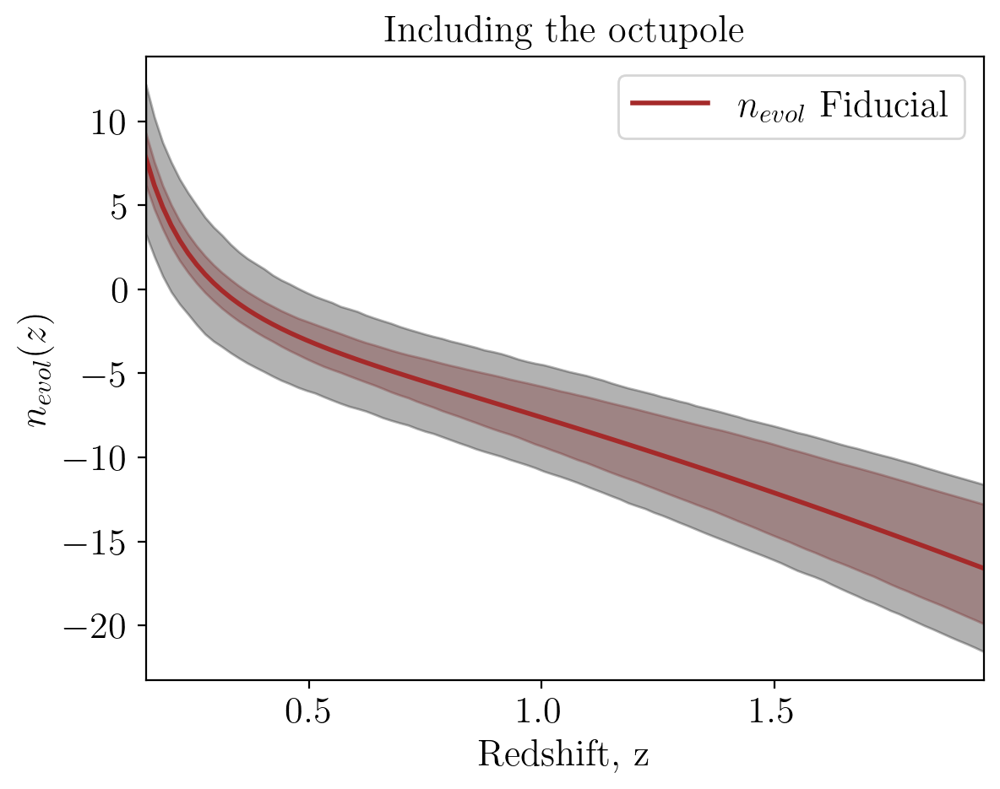

In [72]:
plt.plot(z_lin, num_evol_fid, '-', color='brown', label=r'$n_{evol}$'+' Fiducial', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, nevol_lower_bound_, nevol_upper_bound_, color='brown', alpha=0.3)
plt.fill_between(z_lin, nevol_lower_bound_priors, nevol_upper_bound_priors, color='black', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$n_{evol}(z)$')
plt.title('Including the octupole')
plt.legend();

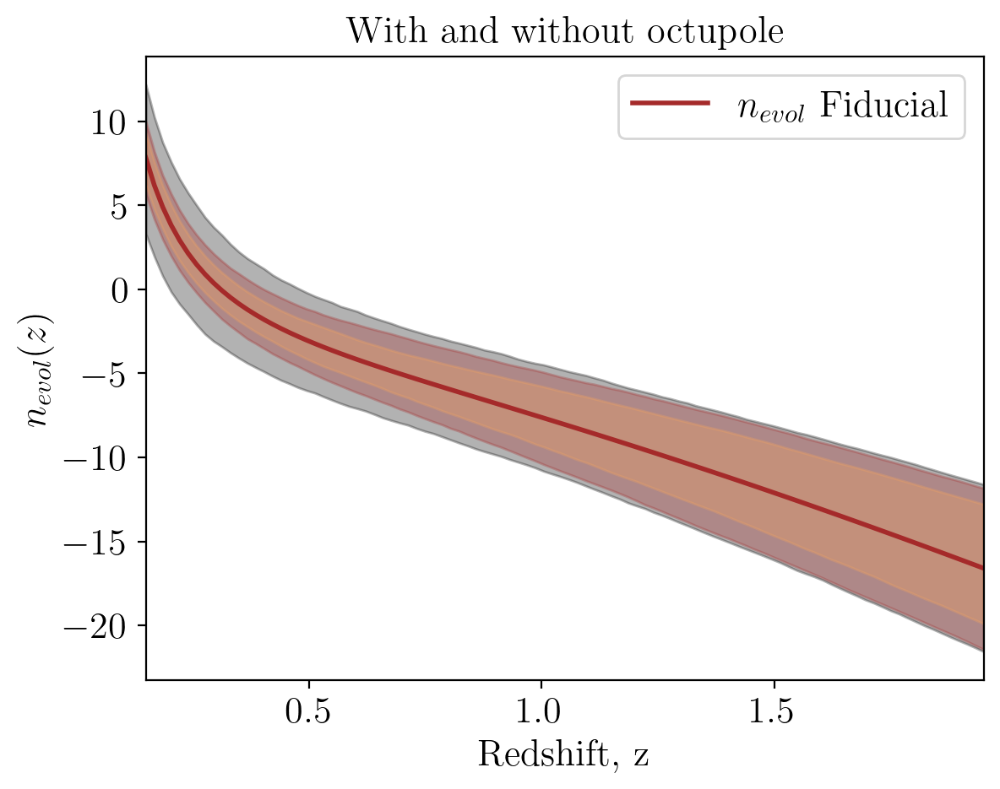

In [73]:
plt.plot(z_lin, num_evol_fid, '-', color='brown', label=r'$n_{evol}$'+' Fiducial', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, nevol_lower_bound_priors, nevol_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, nevol_lower_bound, nevol_upper_bound, color='brown', alpha=0.3)
plt.fill_between(z_lin, nevol_lower_bound_, nevol_upper_bound_, color='sandybrown', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$n_{evol}(z)$')
plt.title('With and without octupole')
plt.legend();

##### Evolution bias

The evolution bias is computed from the magnification biases and the evolution of the number densities.

$$ f^{evol}_{B}(z) = -\frac{d\log{N_B(z)}}{d\log{(1+z)}} - \frac{d\log{H(z)}}{d\log{(1+z)}} + \frac{2(1+z)}{r(z)H(z)} -5\,s_B(z)\left(1+\frac{(1+z)}{r(z)H(z)}\right) - \frac{5}{2}s_B(z)\,\frac{d\log{F_c}}{d\log{(1+z)}} $$

$$ f^{evol}_{F}(z) = -\frac{d\log{N_F(z)}}{d\log{(1+z)}} - \frac{d\log{H(z)}}{d\log{(1+z)}} + \frac{2(1+z)}{r(z)H(z)} -5\,s_F(z)\left(1+\frac{(1+z)}{r(z)H(z)}\right) 
    - \frac{5}{2}\left[\frac{\bar{N}}{\bar{N}_F}\,s_{model}(z)\frac{d\log{F_*}}{d\log{(1+z)}}-\frac{\bar{N}_B}{\bar{N}_F}\,s_B(z)\frac{d\log{F_c}}{d\log{(1+z)}}\right] $$

We have all the ingredients defined as methods in the EvolutionBias class. We need to extract the relevant terms and then sample togeter the $n_{evol}$ and magnification bias parameters to construct the predictions for each evolution bias. 

In [74]:
m_split = 10/7

myEvolBias = EvolutionBias(n_split=m_split)

dlogH = myEvolBias.dlogH
rHterm = myEvolBias.rHterm
dFstar = myEvolBias.dLogFstar
dFcut = myEvolBias.dLogFcut

In [75]:
def fevol_bright(pars_s, pars_n, z):
    pars_sB = pars_s[:4] 
    return - nevol_fit(params=pars_n, x=z) - dlogH(z) + (2 - 5*magbias_fit(params=pars_sB, x=z))*rHterm(z) - 5*magbias_fit(params=pars_sB, x=z) - 5/2*magbias_fit(params=pars_sB, x=z)*dFcut(z)
    
def fevol_faint(pars_s, pars_n, z):
    
    pars_sB = pars_s[:4]
    pars_sM = pars_s[4:]
    s_B = magbias_fit(params=pars_sB, x=z)
    s_M = magbias_fit(params=pars_sM, x=z)
    s_faint = s_M*m_split/(m_split-1) - s_B/(m_split-1)
    
    return - nevol_fit(params=pars_n, x=z) - dlogH(z) + (2 - 5*s_faint)*rHterm(z) - 5*s_faint + 5/2*((1/(m_split-1)) * s_B *dFcut(z) - (m_split/(m_split-1)) * s_M *dFstar(z))

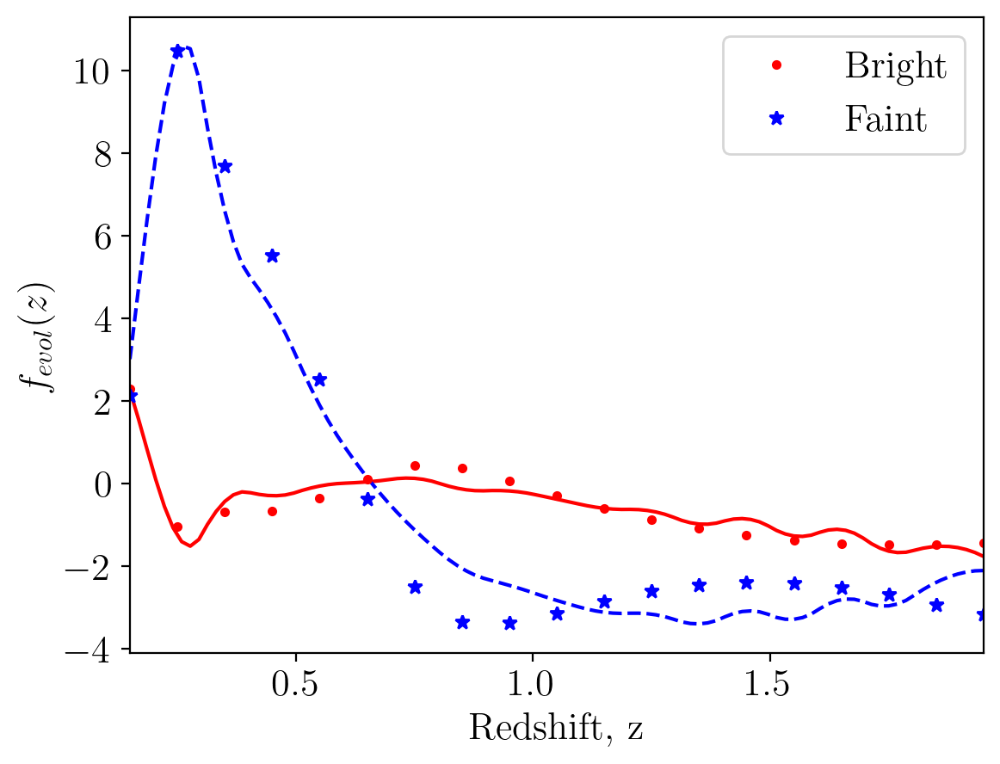

In [76]:
z_lin = np.linspace(z_bins[0], z_bins[-1], 100)

fevol_B_fid = fevol_bright(pars_s = sbias_fid, pars_n = nevol_fid, z = z_lin)
fevol_F_fid = fevol_faint(pars_s = sbias_fid, pars_n = nevol_fid, z = z_lin)

plt.plot(z_lin, fevol_B_fid, 'r-')
plt.plot(z_lin, fevol_F_fid, 'b--')

feB = myEvolBias.fevol_bright(z_bins)
feF = myEvolBias.fevol_faint(z_bins)

plt.plot(z_bins, feB, 'r.', label='Bright')
plt.plot(z_bins, feF, 'b*', label='Faint')

plt.xlim(z_bins[0], z_bins[-1])

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f_{evol}(z)$');
plt.legend();

In [77]:
# Select the marginalized covariance matrix for the number evolution

cov_all_ = Sigma_Matrix_oct_all_19bins[:12, :12]
cov_all_priors = Cov_all_19bins[:12, :12]

all_fid = np.concatenate([sbias_fid, nevol_fid])

# Generate parameter samples from multivariate normal distribution

num_samples = 1000
all_pars_samples_ = np.random.multivariate_normal(all_fid, cov_all_, num_samples)
all_pars_samples_priors = np.random.multivariate_normal(all_fid, cov_all_priors, num_samples)

# Evaluate fitting function for each parameter sample

fevol_B_samples_ = np.array([fevol_bright(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_])
fevol_B_samples_priors = np.array([fevol_bright(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_priors])
fevol_F_samples_ = np.array([fevol_faint(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_])
fevol_F_samples_priors = np.array([fevol_faint(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_priors])

# Calculate the 68% confidence intervals

fevol_B_lower_bound_ = np.percentile(fevol_B_samples_, 16, axis=0)
fevol_B_upper_bound_ = np.percentile(fevol_B_samples_, 84, axis=0)
fevol_B_lower_bound_priors = np.percentile(fevol_B_samples_priors, 16, axis=0)
fevol_B_upper_bound_priors = np.percentile(fevol_B_samples_priors, 84, axis=0)

fevol_F_lower_bound_ = np.percentile(fevol_F_samples_, 16, axis=0)
fevol_F_upper_bound_ = np.percentile(fevol_F_samples_, 84, axis=0)
fevol_F_lower_bound_priors = np.percentile(fevol_F_samples_priors, 16, axis=0)
fevol_F_upper_bound_priors = np.percentile(fevol_F_samples_priors, 84, axis=0)

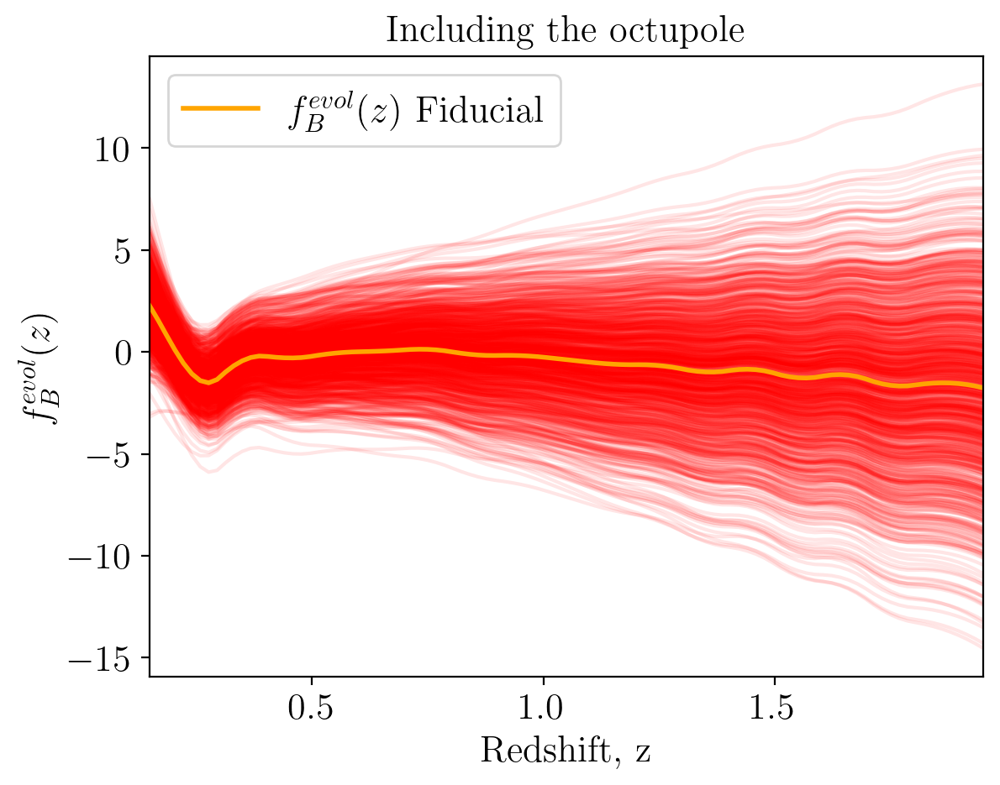

In [78]:
# Plot the fitting function for each sample
for sample in fevol_B_samples_:
    plt.plot(z_lin, sample, color='red', alpha=0.1)
    
plt.plot(z_lin, fevol_B_fid, '-', color='orange', label=r'$f^{evol}_B(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
plt.title('Including the octupole')
plt.legend();

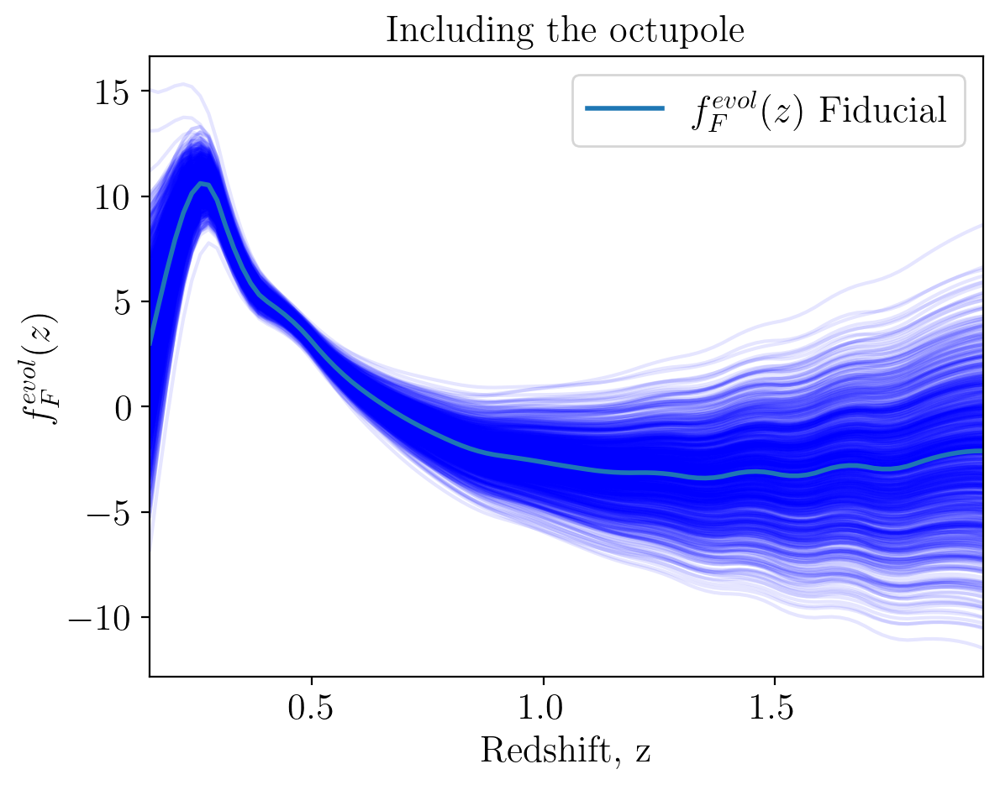

In [79]:
# Plot the fitting function for each sample
for sample in fevol_F_samples_:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.plot(z_lin, fevol_F_fid, '-', label=r'$f^{evol}_F(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_F(z)$')
plt.title('Including the octupole')
plt.legend();

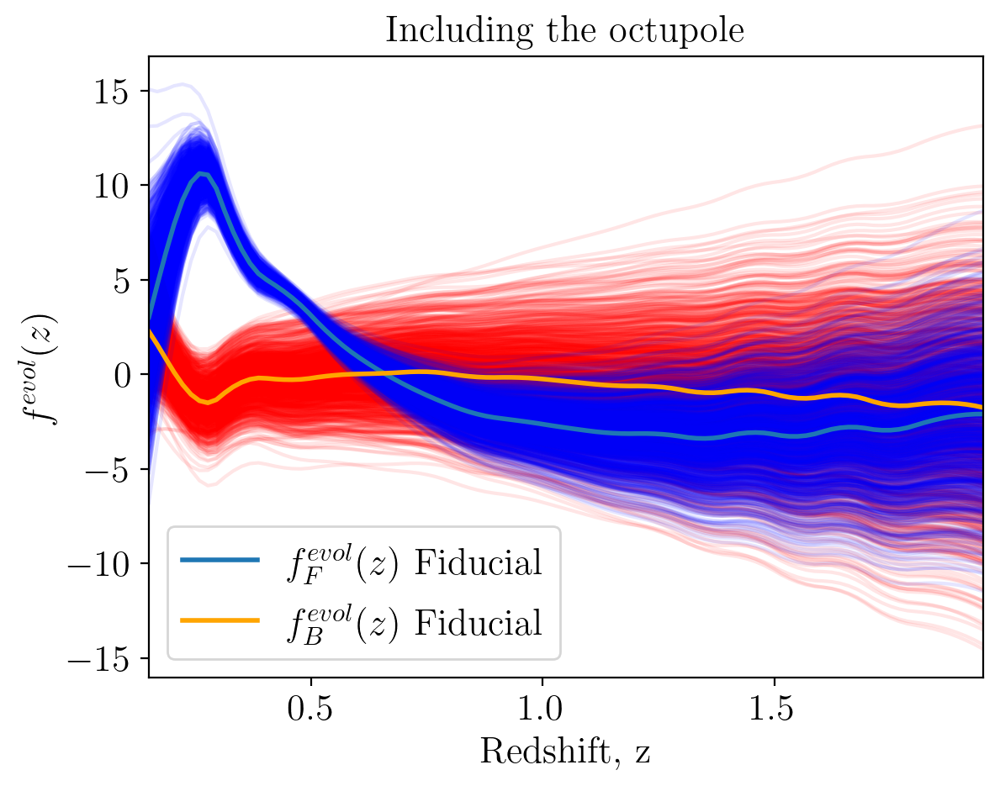

In [80]:
# Plot the fitting function for each sample
for sample in fevol_B_samples_:
    plt.plot(z_lin, sample, color='red', alpha=0.1)

for sample in fevol_F_samples_:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.plot(z_lin, fevol_F_fid, '-', label=r'$f^{evol}_F(z)$'+' Fiducial', lw = 2.0)
plt.plot(z_lin, fevol_B_fid, '-', color='orange', label=r'$f^{evol}_B(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}(z)$')
plt.title('Including the octupole')
plt.legend();

Text(0.5, 1.0, 'Including the octupole')

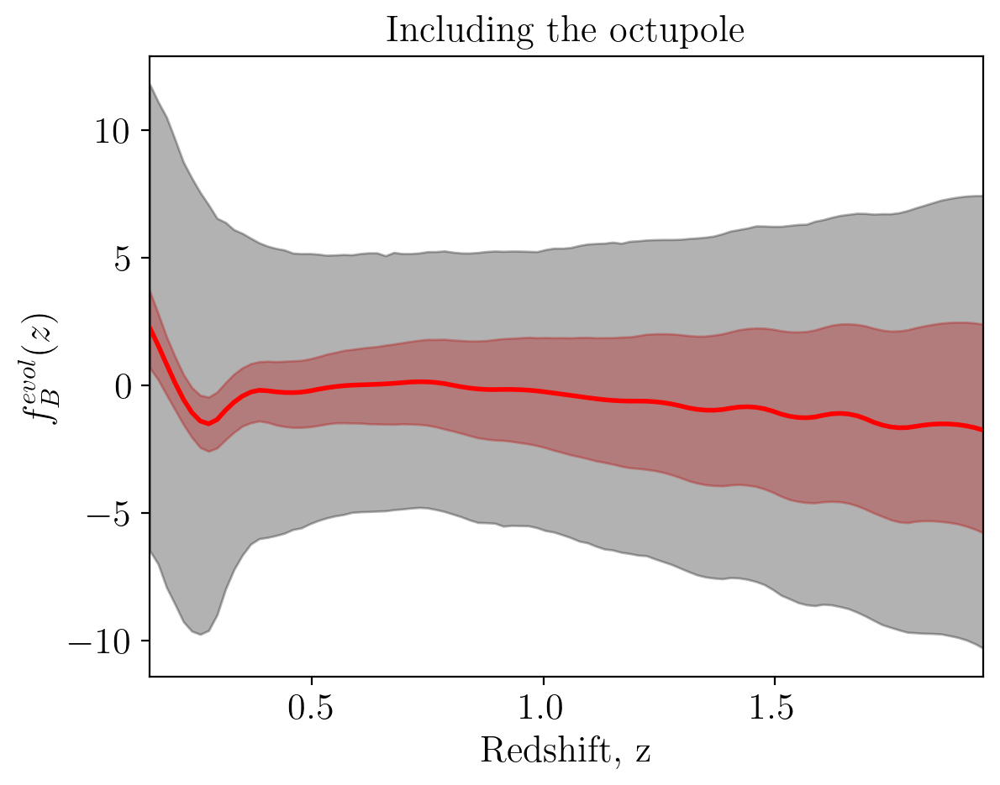

In [81]:
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_B_lower_bound_, fevol_B_upper_bound_, color='red', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound_priors, fevol_B_upper_bound_priors, color='black', alpha=0.3)


plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
plt.title('Including the octupole')

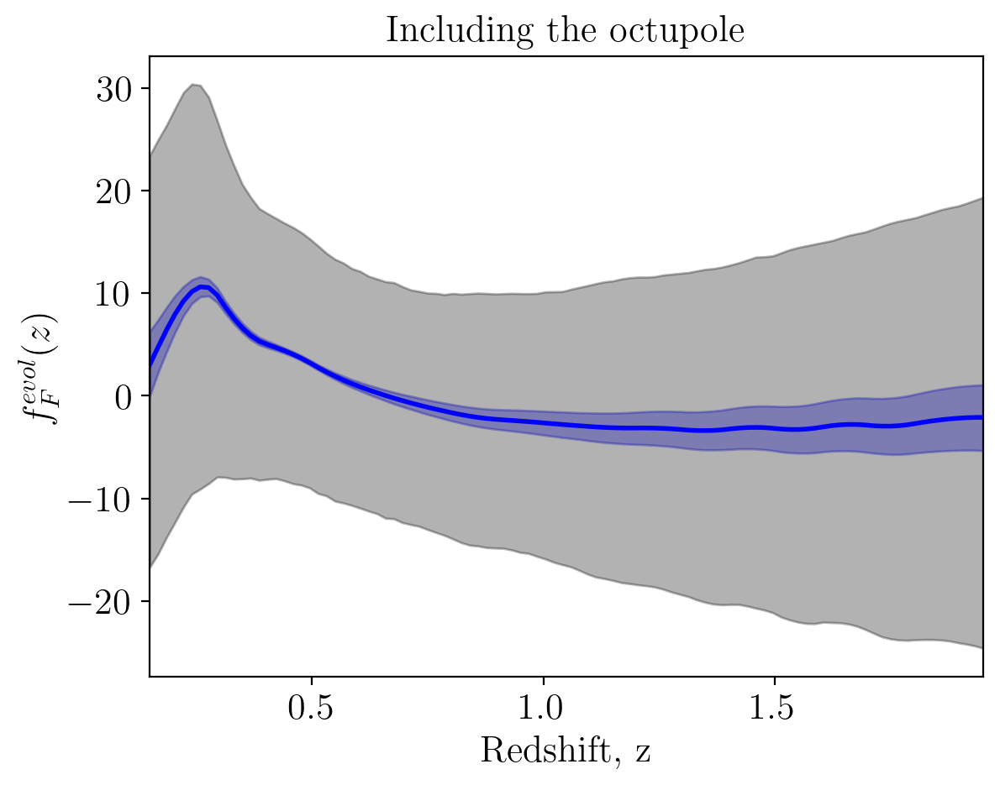

In [82]:
plt.plot(z_lin, fevol_F_fid, '-', color='blue', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_F_lower_bound_, fevol_F_upper_bound_, color='blue', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound_priors, fevol_F_upper_bound_priors, color='black', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f^{evol}_F(z)$');
plt.title('Including the octupole');

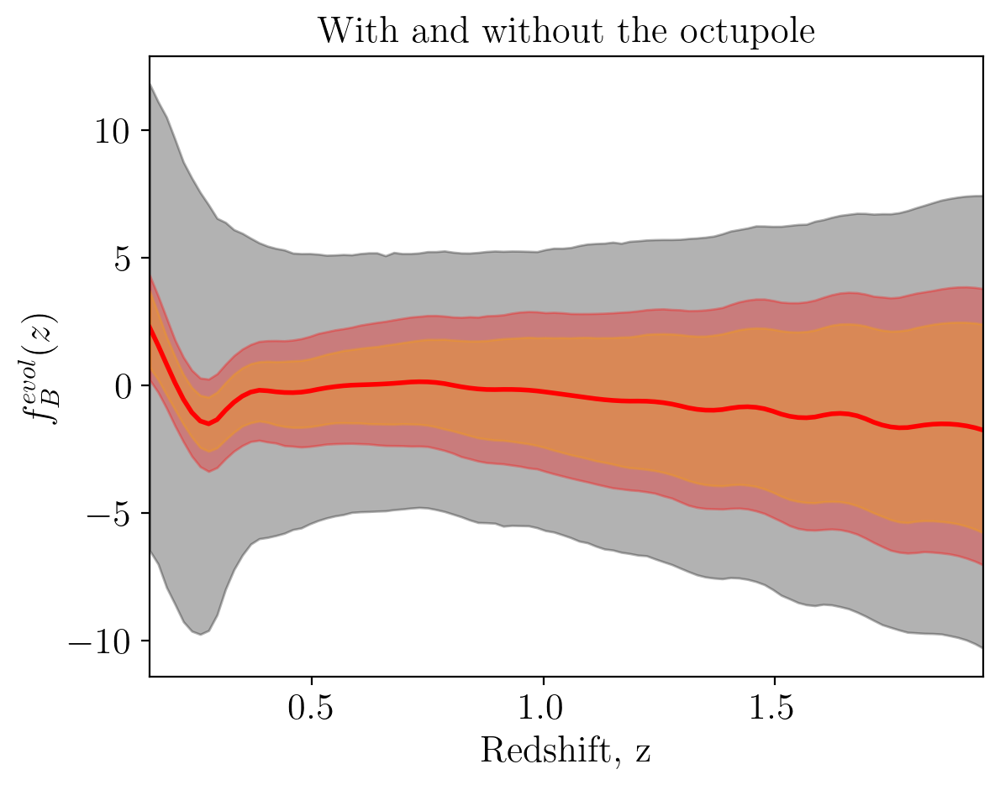

In [83]:
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 2.0)

# Shade the 68% confidence interval


plt.fill_between(z_lin, fevol_B_lower_bound_priors, fevol_B_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound, fevol_B_upper_bound, color='red', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound_, fevol_B_upper_bound_, color='orange', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
plt.title('With and without the octupole');

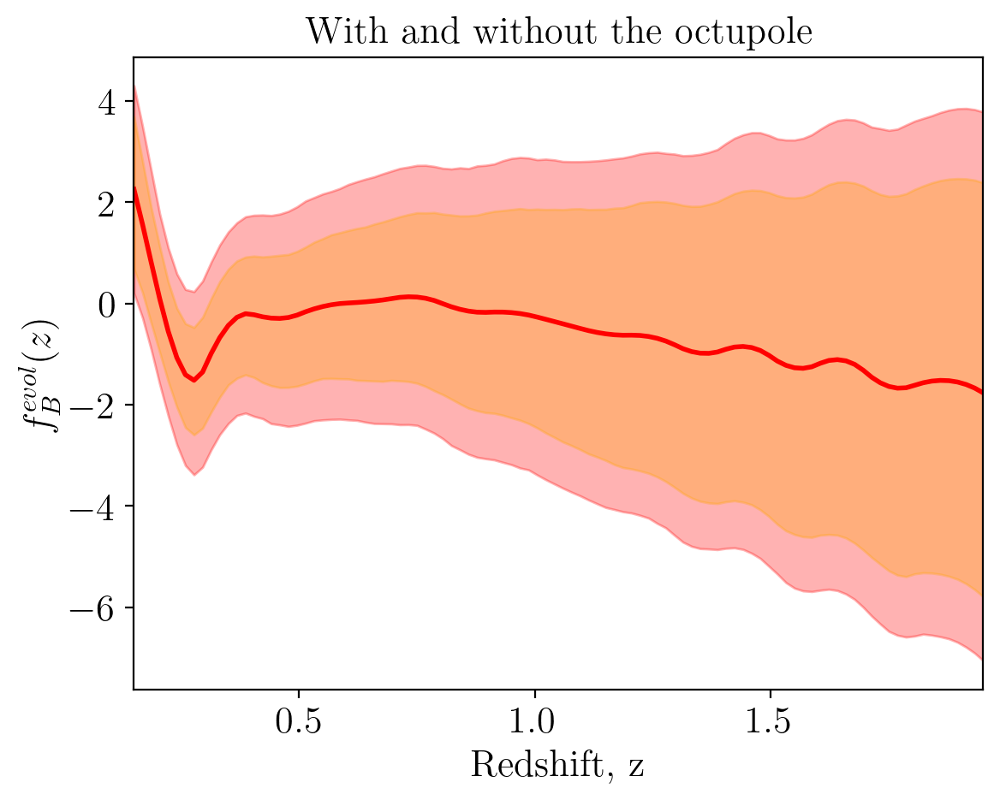

In [84]:
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_B_lower_bound, fevol_B_upper_bound, color='red', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound_, fevol_B_upper_bound_, color='orange', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
plt.title('With and without the octupole');

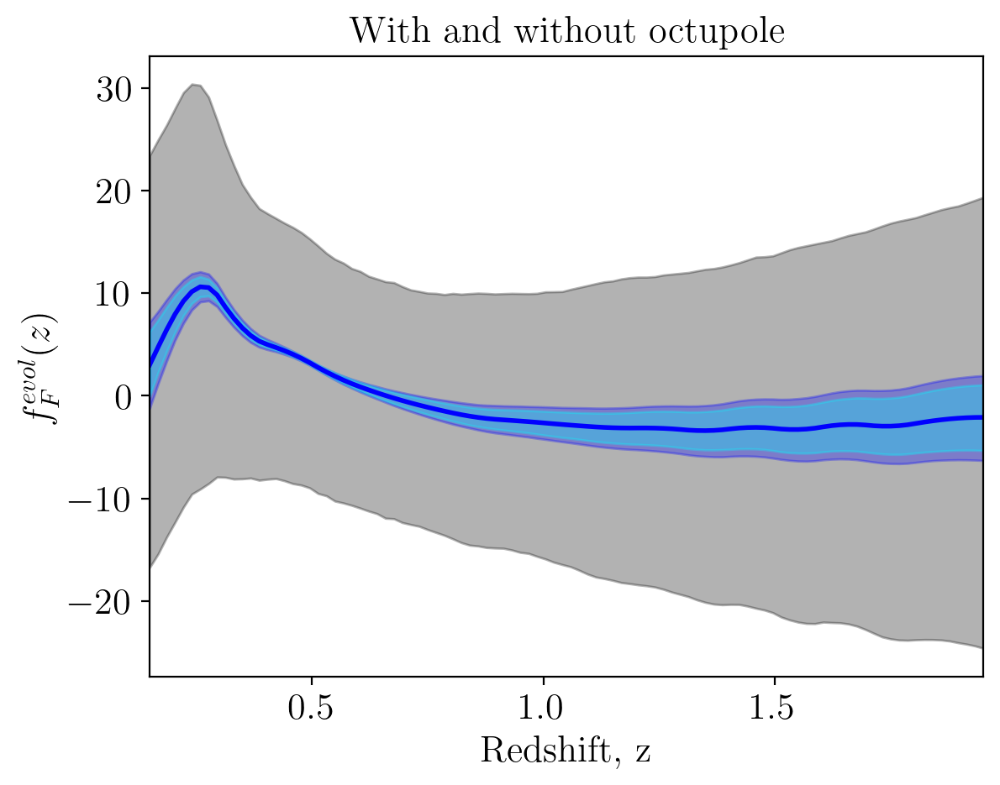

In [85]:
plt.plot(z_lin, fevol_F_fid, '-', color='blue', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_F_lower_bound_priors, fevol_F_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound, fevol_F_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound_, fevol_F_upper_bound_, color='cyan', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f^{evol}_F(z)$');
plt.title('With and without octupole');

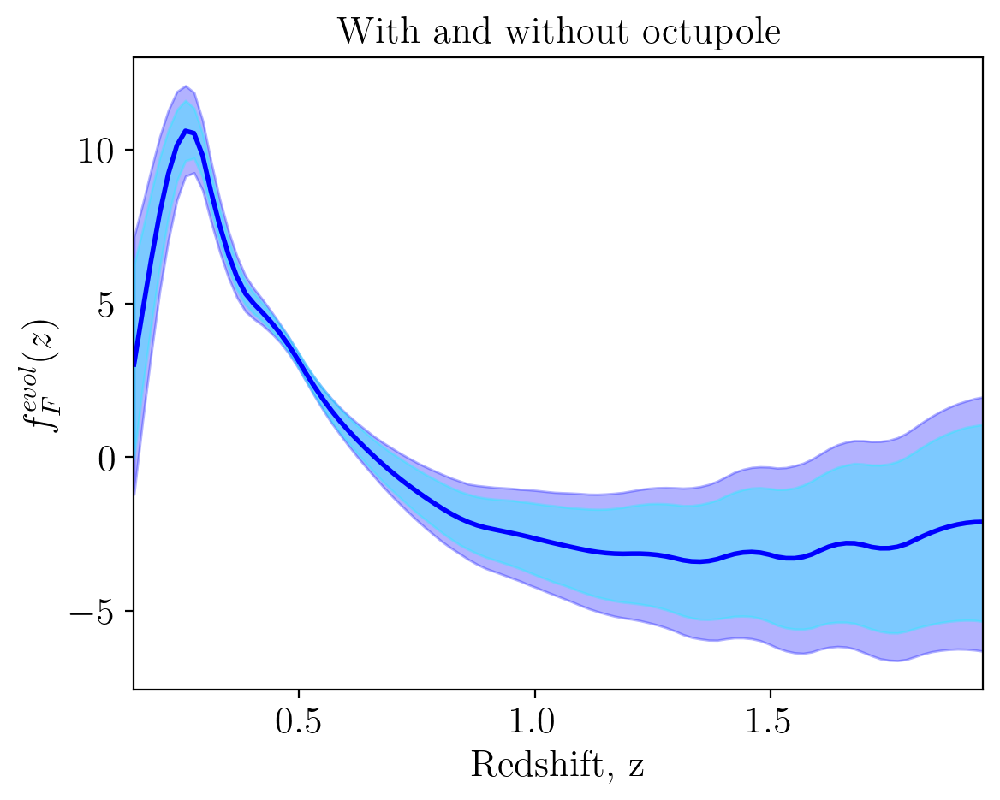

In [86]:
plt.plot(z_lin, fevol_F_fid, '-', color='blue', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_F_lower_bound, fevol_F_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound_, fevol_F_upper_bound_, color='cyan', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f^{evol}_F(z)$');
plt.title('With and without octupole');

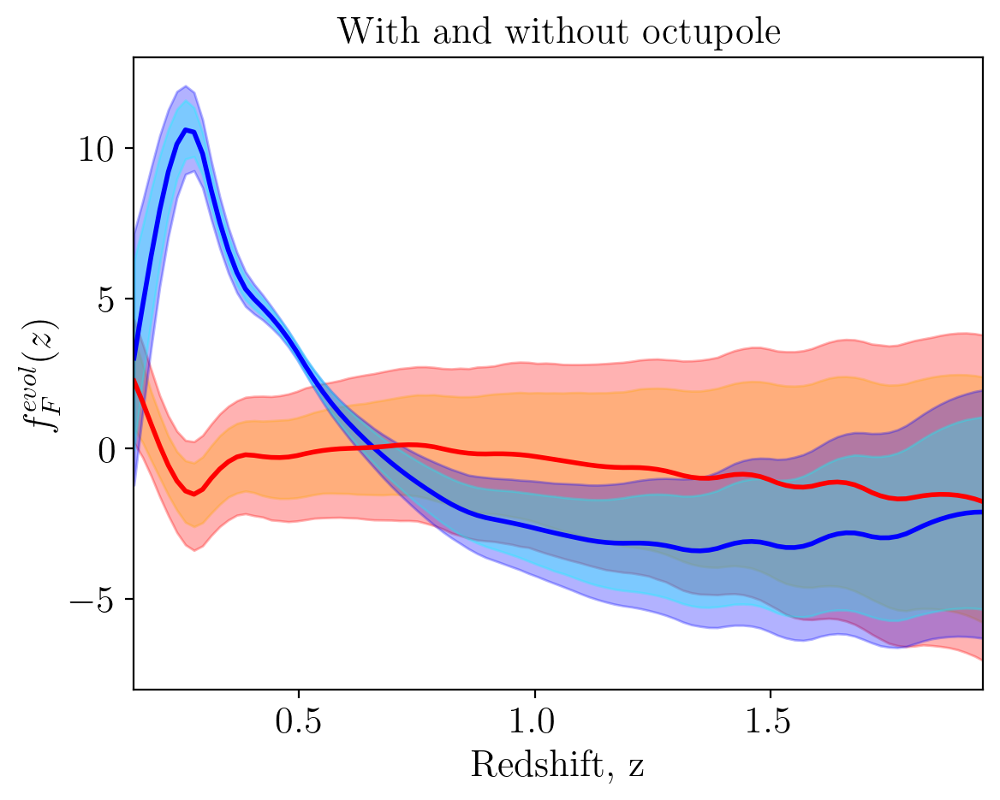

In [87]:
plt.plot(z_lin, fevol_F_fid, '-', color='blue', lw = 2.0)
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 2.0)

# Shade the 68% confidence interval

#plt.fill_between(z_lin, fevol_B_lower_bound_priors, fevol_B_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound, fevol_B_upper_bound, color='red', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound_, fevol_B_upper_bound_, color='orange', alpha=0.3)

# Shade the 68% confidence interval

#plt.fill_between(z_lin, fevol_F_lower_bound_priors, fevol_F_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound, fevol_F_upper_bound, color='blue', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound_, fevol_F_upper_bound_, color='cyan', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f^{evol}_F(z)$');
plt.title('With and without octupole');

### Include cross-variances (FULL ANALYSIS)

We include the octupole in the previous analysis. We include now the cross correlation between the octupole and the other multipoles (it only has non-zero cross-correlations with the dipole).

In [22]:
# Create the Cov Matrix for sB, sF, fevolB, fevolF

errB = [2e-1, 2e-1]
errF = [2e-1, 2e-1]

sB_4fit = np.array([-0.93372809,  1.82432411, -0.92835543, -0.24102824])
sF_4fit = np.array([-0.19376095,  1.0747336,  -0.07806247, -0.00558005])
nevol_fid = np.array([7.94599875, -12.03752387,   2.29927261, -15.83887369])

num_fit = nevol_fid

dsB_19bins = sB_4fit * errB[0] 
dsF_19bins = sF_4fit * errF[0]
dnum_19bins = num_fit * errB[1]

Cov_all_19bins = np.diag(np.concatenate([dsB_19bins**2, dsF_19bins**2, dnum_19bins**2]))

Inv_Cov_oct_all_19bins = np.linalg.inv(Cov_all_19bins)

Inv_Cov_oct_prior_all = np.zeros([len(dsignal_dtheta_fit_all), len(dsignal_dtheta_fit_all)])
Inv_Cov_oct_prior_all[:len(Inv_Cov_oct_all_19bins), :len(Inv_Cov_oct_all_19bins)] = Inv_Cov_oct_all_19bins

Cov_oct_multipoles_19bins = np.array(Cov_multipoles_19bins)

np.shape(Cov_oct_multipoles_19bins)

(19, 324, 324)

In [23]:
# Import full Covariance Matrix

Cov_oct_multipoles_19bins = fm.cov_matrix_survey(d = dist[0], z_bins = z_bins, small_off_diagonal = True, split=[70,30], rtol=1e-4)

np.shape(Cov_oct_multipoles_19bins)


 ... Loading Covariance Matrices [MONOBB, MONOBF, MONOFF, DIPBF, QUADBB, QUADBF, QUADFF, HEXAT, OCTBF] ... 

Population splitted in 70% BRIGHT - 30% FAINT 


 ... Success! ... 



(19, 324, 324)

In [24]:
np.shape(dsignal_dtheta_fit_all)

(21, 19, 324)

In [25]:
# Fisher Matrix

Inv_Cov_oct_multipoles_19bins = np.array([np.linalg.inv(Cov_oct_multipoles_19bins[k]) for k,_ in enumerate(z_bins)])

Fisher_Matrix_oct_multipoles_19bins = fm.fisher_matrix(d_signal = dsignal_dtheta_fit_all, inv_cov = Inv_Cov_oct_multipoles_19bins, z_bins = z_bins)
Fisher_Matrix_oct_all_19bins = Fisher_Matrix_oct_multipoles_19bins + Inv_Cov_oct_prior_all

Sigma_Matrix_oct_all_19bins = np.linalg.inv(Fisher_Matrix_oct_all_19bins)

np.shape(Sigma_Matrix_oct_all_19bins)


 ... Computing the Fisher Matrix ... 

Signal & Cov must be given as functions (z,d) and (z,d,d') respectively. 


 ... Success! ... 



(21, 21)

#### Constraints

In [26]:
#Absolute Errors

Abs_Errors_oct_all_19bins = np.sqrt(np.diag(Sigma_Matrix_oct_all_19bins))

# Fiducial values

sbias_fid = np.concatenate([sB_4fit, sF_4fit])
num_fid = num_fit
gbias_fid = np.concatenate([np.array([0.554, 0.783]), np.array([0.554, 0.783])])
cosmic_fid = np.fromiter(params_dict0.values(), dtype=float)
cosmic_fid[1] = np.log(10**10 * cosmic_fid[1])

params_fid = np.concatenate([sbias_fid, num_fid, gbias_fid, cosmic_fid])

# Relative errors

Rel_Errors_oct_all_19bins = np.abs(Abs_Errors_oct_all_19bins/params_fid)

params_errors_oct_all_19bins = Rel_Errors_oct_all_19bins * 100

print()
print('------------ Relative errors * 100 ------------' )
print()
print('sbias = ', params_errors_oct_all_19bins[0:len(sbias_fid)])
print()
print('number = ', params_errors_oct_all_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))])
print()
print('gbias = ', params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))])
print()
print('cosmic = ', params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid)+len(gbias_fid)):])


------------ Relative errors * 100 ------------

sbias =  [11.70639258  8.94577869 10.33444132 12.59675866 16.28836491 13.88966516
 17.76283693 19.96210386]

number =  [17.34664537 16.14459499 14.45214888 14.54620736]

gbias =  [0.39513702 0.3380828  0.16113341 0.30635106]

cosmic =  [1.17870219 0.75538637 0.97947109 1.18311625 0.53866583]


#### Plots

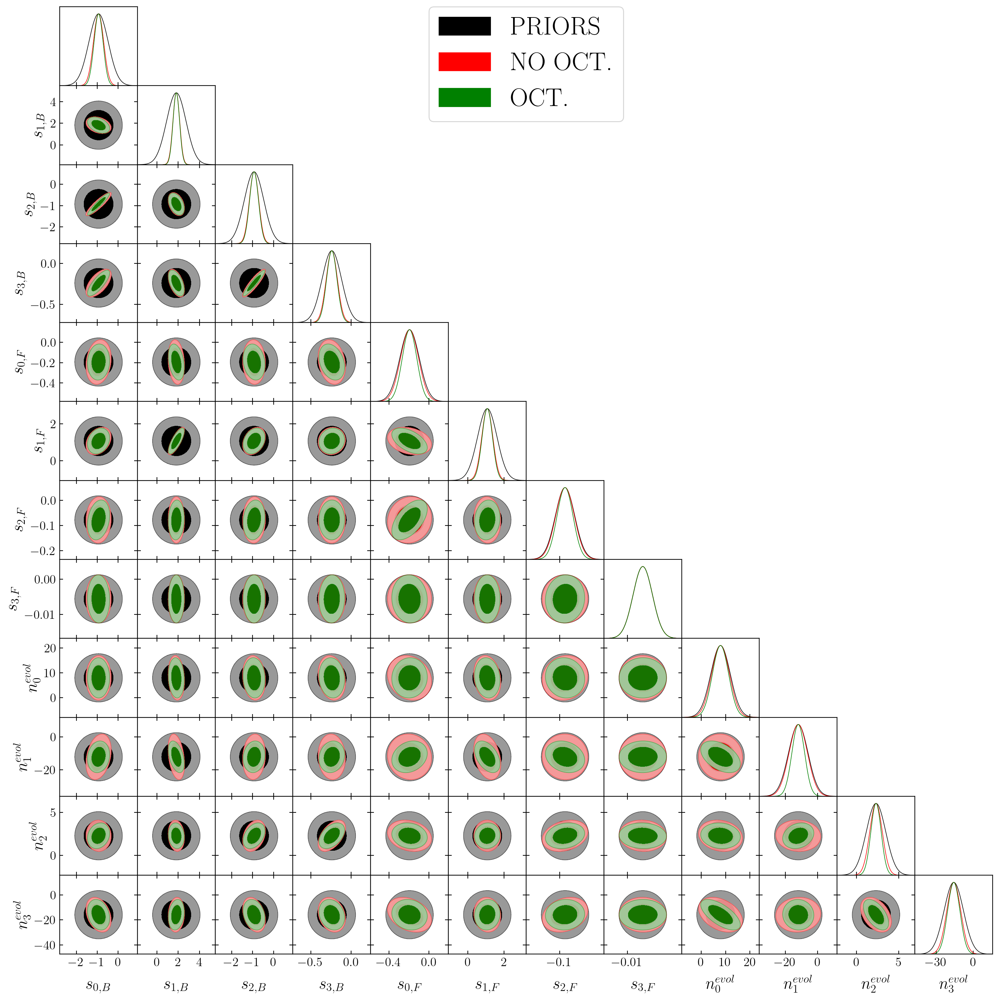

In [115]:
# Triangle plot

mean = np.concatenate([sB_4fit, sF_4fit, num_fit])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

num_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

num_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names + sF_names + num_names 
labels = sB_labels + sF_labels + num_labels 

GaussDist_oct_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_oct_all_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_noct_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_ini_sbias_fbias_fit = GaussianND(mean, Cov_all_19bins, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=15)
g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=18
g.settings.axes_labelsize=22
g.settings.axis_tick_max_labels=6

g.triangle_plot([GaussDist_ini_sbias_fbias_fit, GaussDist_sbias_fbias_fit ,GaussDist_oct_sbias_fbias_fit], param_names,
                filled=True, 
                legend_labels=['PRIORS', 'NO OCT.', 'OCT.'],
                contour_colors=['black', 'red', 'green'])

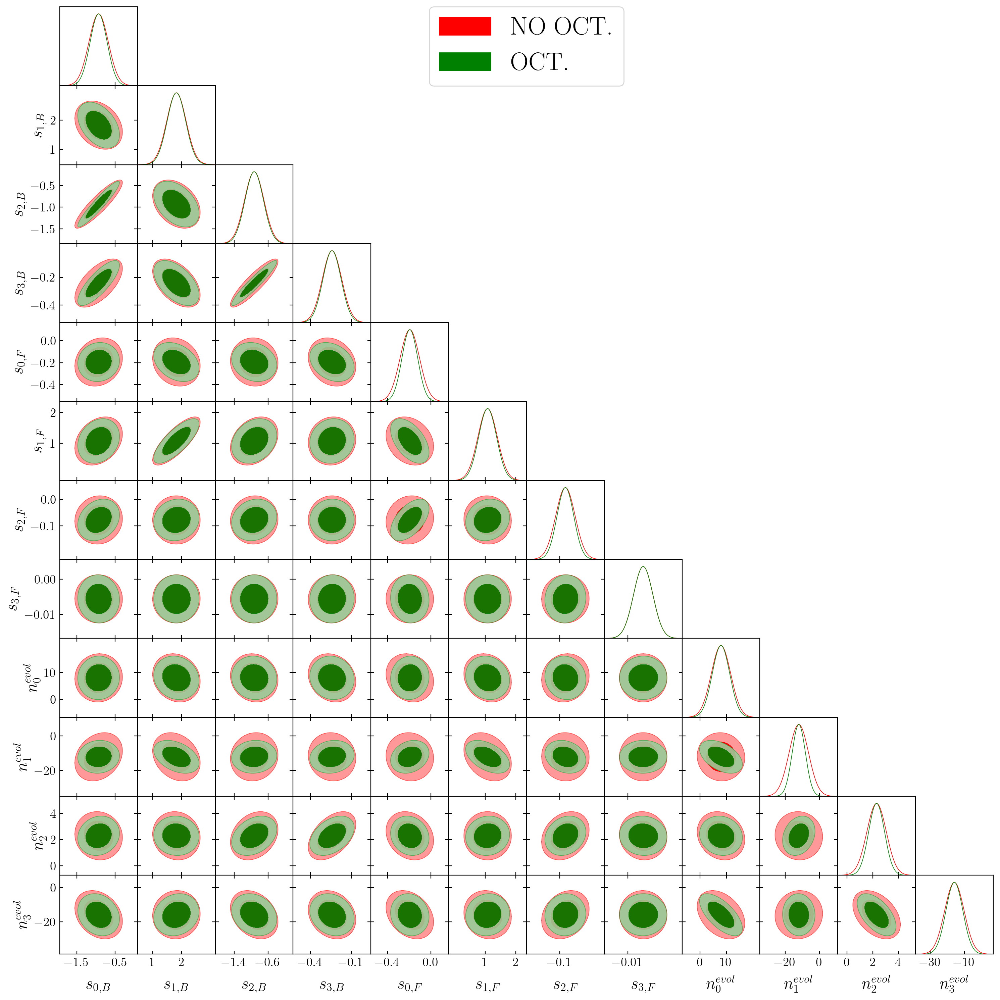

In [215]:
# Triangle plot

mean = np.concatenate([sB_4fit, sF_4fit, num_fit])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

num_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

num_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names + sF_names + num_names 
labels = sB_labels + sF_labels + num_labels 

GaussDist_oct_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_oct_all_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_noct_19bins[:len(mean),:len(mean)], labels = labels, names = param_names)
GaussDist_ini_sbias_fbias_fit = GaussianND(mean, Cov_all_19bins, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=15)

g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=18
g.settings.axes_labelsize=22
g.settings.axis_tick_max_labels=6

g.triangle_plot([GaussDist_sbias_fbias_fit ,GaussDist_oct_sbias_fbias_fit], param_names,
                filled=True, 
                legend_labels=['NO OCT.', 'OCT.'],
                contour_colors=['red', 'green'])

#g.export('plots/tri_plot_st_vs_oct_50x50.pdf')

In [216]:
# Remove sF and fevolB params

rows_to_remove = np.r_[4:8, 12:len(Sigma_Matrix_oct_all_19bins)]

Sigma_Matrix_oct_all_19bins_ = np.delete(Sigma_Matrix_oct_all_19bins, rows_to_remove, axis=0)
Sigma_Matrix_oct_all_19bins_ = np.delete(Sigma_Matrix_oct_all_19bins_, rows_to_remove, axis=1)

Cov_all_19bins_ = np.delete(Cov_all_19bins, np.r_[4:8], axis=0)
Cov_all_19bins_ = np.delete(Cov_all_19bins_, np.r_[4:8], axis=1)

np.shape(Sigma_Matrix_oct_all_19bins_), np.shape(Cov_all_19bins_)

((8, 8), (8, 8))

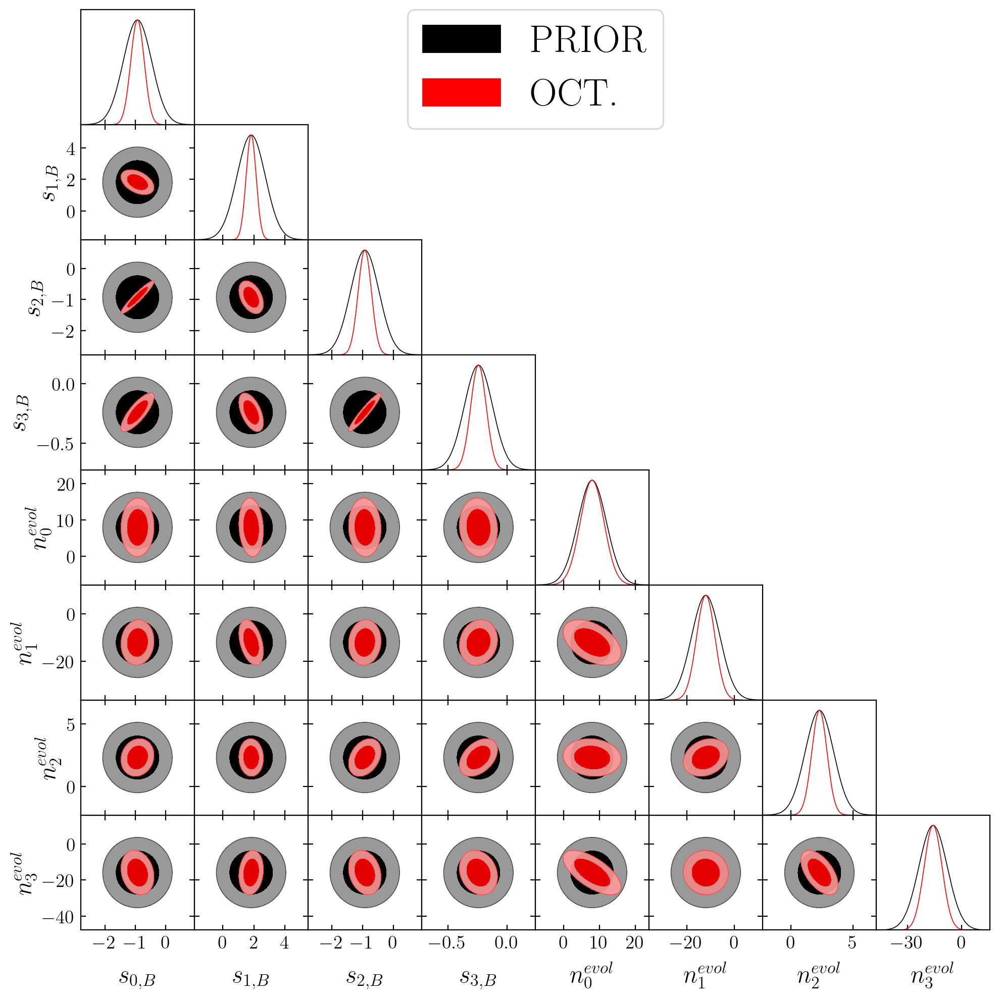

In [217]:
# Triangle plot

mean = np.concatenate([sB_4fit, num_fit])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

fB_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

fB_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names +  fB_names
labels = sB_labels + fB_labels

GaussDist_oct_sbias_fbias_fit_ = GaussianND(mean, Sigma_Matrix_oct_all_19bins_, labels = labels, names = param_names)
GaussDist_ini_sbias_fbias_fit_ = GaussianND(mean, Cov_all_19bins_, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=10)
g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=18
g.settings.axes_labelsize=22
g.settings.axis_tick_max_labels=6

g.triangle_plot([GaussDist_ini_sbias_fbias_fit_, GaussDist_oct_sbias_fbias_fit_], param_names, 
                filled=True, 
                legend_labels=['PRIOR', 'OCT.'],
                contour_colors=['black', 'red'])

#### Comparing with and without OCTUPOLE

Compute the improvement in %

In [27]:
print('------------ Relative errors with octupole * 100 ------------' )
print()
print('sbias = ', params_errors_oct_all_19bins[0:len(sbias_fid)])
print()
print('number = ', params_errors_oct_all_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))])

------------ Relative errors with octupole * 100 ------------

sbias =  [11.70639258  8.94577869 10.33444132 12.59675866 16.28836491 13.88966516
 17.76283693 19.96210386]

number =  [17.34664537 16.14459499 14.45214888 14.54620736]


In [28]:
print('------------ Relative errors without octupole * 100 ------------' )
print()
print('sbias = ', params_errors_noct_19bins[0:len(sbias_fid)])
print()
print('number = ', params_errors_noct_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))])

------------ Relative errors without octupole * 100 ------------

sbias =  [12.49690145  9.28232653 10.49348593 13.11050653 18.50862769 14.72545191
 19.28378534 19.98396027]

number =  [18.6255772  19.35767768 15.49220771 15.51695965]


In [29]:
print('------------ Improvement * 100 ------------' )
print()
print('sbias = ', (1-params_errors_oct_all_19bins[0:len(sbias_fid)]/params_errors_noct_19bins[0:len(sbias_fid)]) * 100)
print()
print('number = ', (1-params_errors_oct_all_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))]/params_errors_noct_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))]) * 100)

------------ Improvement * 100 ------------

sbias =  [ 6.32563897  3.62568404  1.51565092  3.91859672 11.99582605  5.67579691
  7.88718803  0.10936975]

number =  [ 6.86653529 16.59849254  6.71343201  6.25607281]


In [31]:
import pandas as pd

row_names = {
    0: "sB_0",
    1: "sB_1",
    2: "sB_2",
    3: "sB_3",
    4: "sM_0",
    5: "sM_2",
    6: "sM_3",
    7: "sM_4"
}

constraints_s = {
    "Dipole" : params_errors_noct_19bins[0:len(sbias_fid)],
    "Octupole" : params_errors_oct_all_19bins[0:len(sbias_fid)],
    "Improvement" : (1-params_errors_oct_all_19bins[0:len(sbias_fid)]/params_errors_noct_19bins[0:len(sbias_fid)]) * 100
}

df_s = pd.DataFrame(constraints_s, index=row_names.values())
df_s = df_s.apply(pd.Series.round, args=[2])

In [32]:
df_s

,Dipole,Octupole,Improvement
sB_0,12.50,11.71,6.33
sB_1,9.28,8.95,3.63
sB_2,10.49,10.33,1.52
sB_3,13.11,12.60,3.92
sM_0,18.51,16.29,12.00
sM_2,14.73,13.89,5.68
sM_3,19.28,17.76,7.89
sM_4,19.98,19.96,0.11


In [33]:
latex_string = df_s.to_latex(index=True, float_format='%.2f')  # Remove index if desired
print(latex_string)

\begin{tabular}{lrrr}
\toprule
{} &  Dipole &  Octupole &  Improvement \\
\midrule
sB\_0 &   12.50 &     11.71 &         6.33 \\
sB\_1 &    9.28 &      8.95 &         3.63 \\
sB\_2 &   10.49 &     10.33 &         1.52 \\
sB\_3 &   13.11 &     12.60 &         3.92 \\
sM\_0 &   18.51 &     16.29 &        12.00 \\
sM\_2 &   14.73 &     13.89 &         5.68 \\
sM\_3 &   19.28 &     17.76 &         7.89 \\
sM\_4 &   19.98 &     19.96 &         0.11 \\
\bottomrule
\end{tabular}



C:\Users\Daniel SB\AppData\Local\Temp\ipykernel_25768\1143797278.py:1: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  latex_string = df_s.to_latex(index=True, float_format='%.2f')  # Remove index if desired


In [34]:
row_names = {
    0: "n_0",
    1: "n_1",
    2: "n_2",
    3: "n_3"
}

constraints_num = {
    "Dipole" : params_errors_noct_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))],
    "Octupole" : params_errors_oct_all_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))],
    "Improvement" : (1-params_errors_oct_all_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))]/params_errors_noct_19bins[len(sbias_fid):(len(sbias_fid) + len(num_fid))]) * 100
}

df_num = pd.DataFrame(constraints_num, index=row_names.values())
df_num = df_num.apply(pd.Series.round, args=[2])

In [35]:
df_num

,Dipole,Octupole,Improvement
n_0,18.63,17.35,6.87
n_1,19.36,16.14,16.60
n_2,15.49,14.45,6.71
n_3,15.52,14.55,6.26


In [36]:
latex_string = df_num.to_latex(index=True, float_format='%.2f')  # Remove index if desired
print(latex_string)

\begin{tabular}{lrrr}
\toprule
{} &  Dipole &  Octupole &  Improvement \\
\midrule
n\_0 &   18.63 &     17.35 &         6.87 \\
n\_1 &   19.36 &     16.14 &        16.60 \\
n\_2 &   15.49 &     14.45 &         6.71 \\
n\_3 &   15.52 &     14.55 &         6.26 \\
\bottomrule
\end{tabular}



C:\Users\Daniel SB\AppData\Local\Temp\ipykernel_25768\3057744152.py:1: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  latex_string = df_num.to_latex(index=True, float_format='%.2f')  # Remove index if desired


In [37]:
# Galaxy bias and Cosmic params

print('------------ Relative errors with octupole * 100 ------------' )
print()
print('gbias = ', params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))])
print()
print('cosmic = ', params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid) + len(gbias_fid)):])

print('\n------------ Relative errors without octupole * 100 ------------' )
print()
print('gbias = ', params_errors_noct_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))])
print()
print('cosmic = ', params_errors_noct_19bins[(len(sbias_fid) + len(num_fid) + len(gbias_fid)):])

print('\n------------ Improvement * 100 ------------' )
print()
print('gbias = ', (1-params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))]/params_errors_noct_19bins[(len(sbias_fid) + len(num_fid)):(len(sbias_fid) + len(num_fid) + len(gbias_fid))]) * 100)
print()
print('cosmic = ', (1-params_errors_oct_all_19bins[(len(sbias_fid) + len(num_fid) + len(gbias_fid)):]/params_errors_noct_19bins[(len(sbias_fid) + len(num_fid) + len(gbias_fid)):]) * 100)

------------ Relative errors with octupole * 100 ------------

gbias =  [0.39513702 0.3380828  0.16113341 0.30635106]

cosmic =  [1.17870219 0.75538637 0.97947109 1.18311625 0.53866583]

------------ Relative errors without octupole * 100 ------------

gbias =  [0.39521786 0.33811297 0.16114476 0.3064237 ]

cosmic =  [1.17877091 0.75547588 0.97956221 1.1831462  0.5387367 ]

------------ Improvement * 100 ------------

gbias =  [0.02045436 0.00892112 0.00704573 0.02370495]

cosmic =  [0.00583021 0.01184833 0.00930243 0.00253171 0.01315397]


#### Full triangle plot

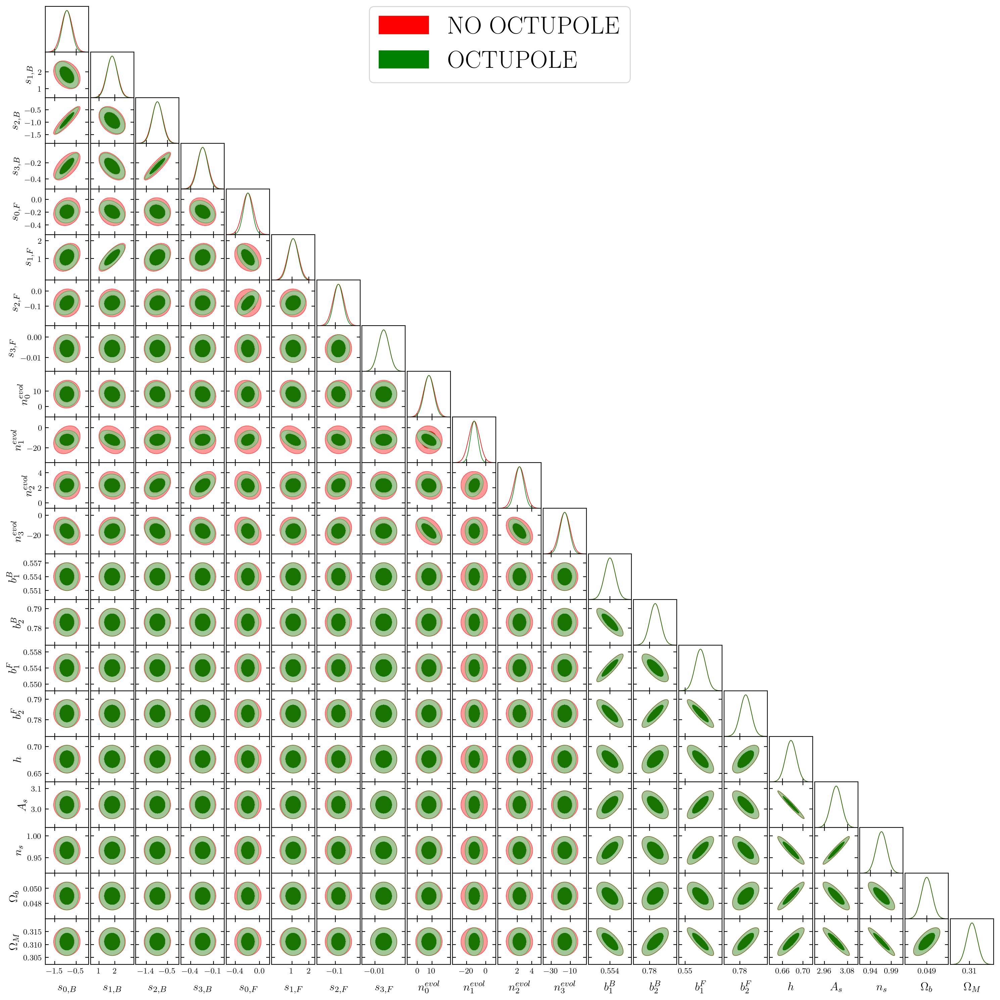

In [222]:
# Triangle plot

mean = np.concatenate([sB_4fit, sF_4fit, num_fit, gbias_fid, cosmic_fid])

sB_names = ['s'+str(int(i))+'B' for i in np.arange(len(sB_4fit))]
sF_names = ['s'+str(int(i))+'F' for i in np.arange(len(sF_4fit))]

sB_labels=[r's_{'+str(i)+r',B}' for i in np.arange(len(sB_4fit))]
sF_labels=[r's_{'+str(i)+r',F}' for i in np.arange(len(sF_4fit))]

fB_names = ['n'+str(int(i)) for i in np.arange(len(num_fit))]

fB_labels=[r'n_{'+str(i)+r'}^{evol}' for i in np.arange(len(num_fit))]

param_names = sB_names + sF_names + fB_names + ['b1B', 'b2B', 'b1F', 'b2F'] + ['h', 'As', 'ns', 'Ob', 'OM']
labels = sB_labels + sF_labels + fB_labels + [r'b_1^B', r'b_2^B', r'b_1^F', r'b_2^F'] + [r'h', r'A_s', r'n_s', r'\Omega_b', r'\Omega_M']

GaussDist_oct_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_oct_all_19bins, labels = labels, names = param_names)
GaussDist_sbias_fbias_fit = GaussianND(mean, Sigma_Matrix_noct_19bins, labels = labels, names = param_names)

g = plots.get_subplot_plotter(width_inch=15)
g.settings.legend_frame = True
g.settings.alpha_filled_add=0.9
g.settings.legend_fontsize=32
g.settings.axes_fontsize=14
g.settings.axes_labelsize=18
g.settings.axis_tick_max_labels=4

g.triangle_plot([GaussDist_sbias_fbias_fit, GaussDist_oct_sbias_fbias_fit], param_names, 
                filled=True, 
                legend_labels=['NO OCTUPOLE', 'OCTUPOLE'],
                contour_colors=['red', 'green'])

#### Predictions

##### Magnification bias

In [97]:
# Magnification bias fit

def magbias_fit(params, x):
    a, b, c, d = params
    return  a + b * x + c * np.log(x) + d * (np.log(x))**2

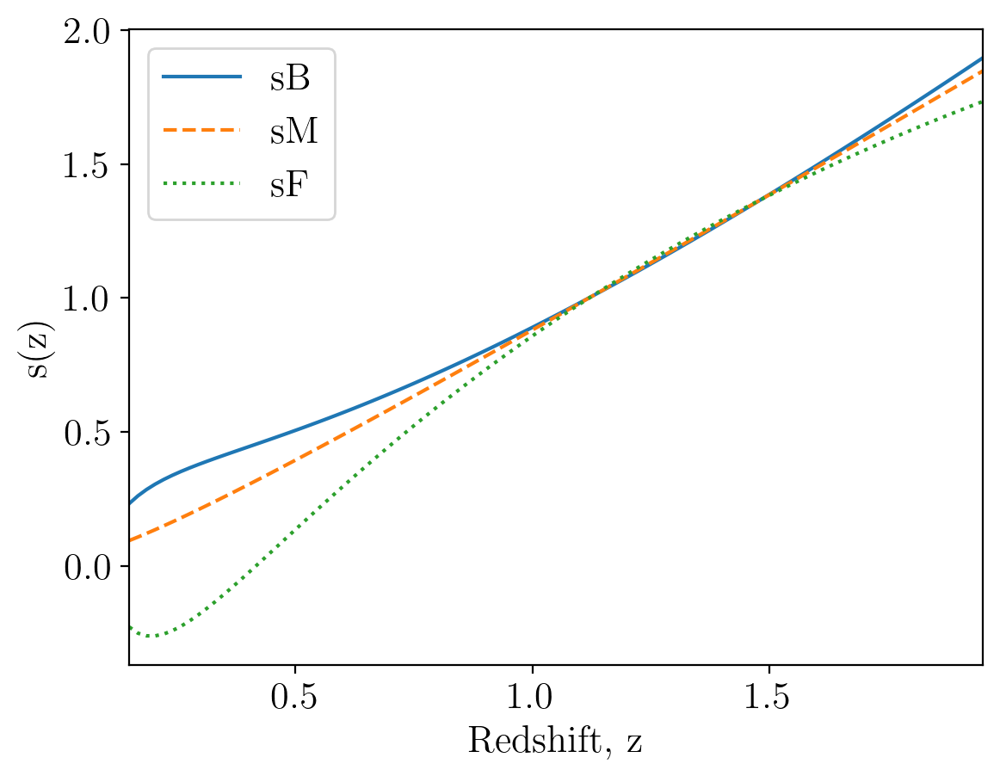

In [98]:
z_lin = np.linspace(z_bins[0], z_bins[-1], 100)
m_split = 10/7

sB_fid = magbias_fit(sB_4fit, z_lin)
sM_fid = magbias_fit(sF_4fit, z_lin)
sF_fid = sM_fid * (m_split/(m_split-1)) - sB_fid/(m_split-1)

plt.plot(z_lin, sB_fid, '-', label=r'sB')
plt.plot(z_lin, sM_fid, '--', label=r'sM')
plt.plot(z_lin, sF_fid, ':', label=r'sF')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.legend();


###### Compare the two observables

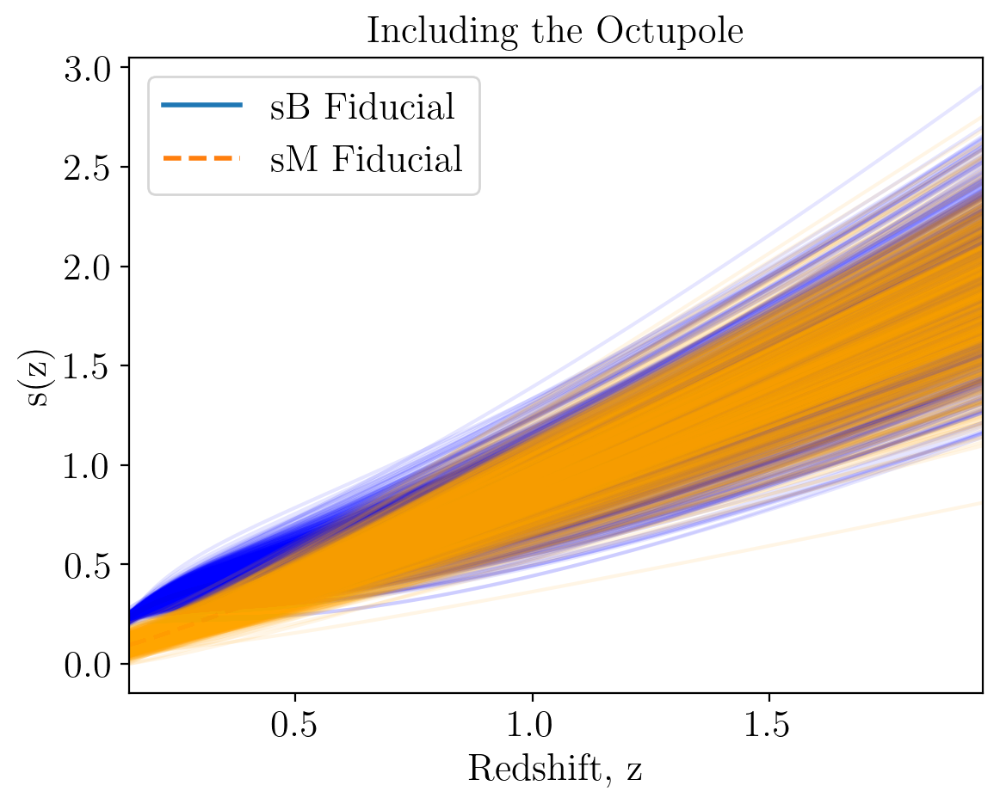

In [99]:
# Select the marginalized covariance matrix for the magnification biases

cov_sB_all = Sigma_Matrix_oct_all_19bins[:4, :4]
cov_sM_all = Sigma_Matrix_oct_all_19bins[4:8, 4:8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sB_pars_samples_all = np.random.multivariate_normal(sB_4fit, cov_sB_all, num_samples)
sM_pars_samples_all = np.random.multivariate_normal(sF_4fit, cov_sM_all, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_all = np.array([magbias_fit(pars, z_lin) for pars in sB_pars_samples_all])
sM_samples_all = np.array([magbias_fit(pars, z_lin) for pars in sM_pars_samples_all])

# Calculate the 68% confidence interval
sB_lower_bound_all = np.percentile(sB_samples_all, 16, axis=0)
sB_upper_bound_all = np.percentile(sB_samples_all, 84, axis=0)
sM_lower_bound_all = np.percentile(sM_samples_all, 16, axis=0)
sM_upper_bound_all= np.percentile(sM_samples_all, 84, axis=0)

# Step 5: Plotting

plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0)
plt.plot(z_lin, sM_fid, '--', label=r'sM Fiducial', lw = 2.0)

# Plot the fitting function for each sample
for sample in sB_samples_all:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)

for sample in sM_samples_all:
    plt.plot(z_lin, sample, color='orange', alpha=0.1)
    
plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title(r'Including the Octupole')
plt.legend();

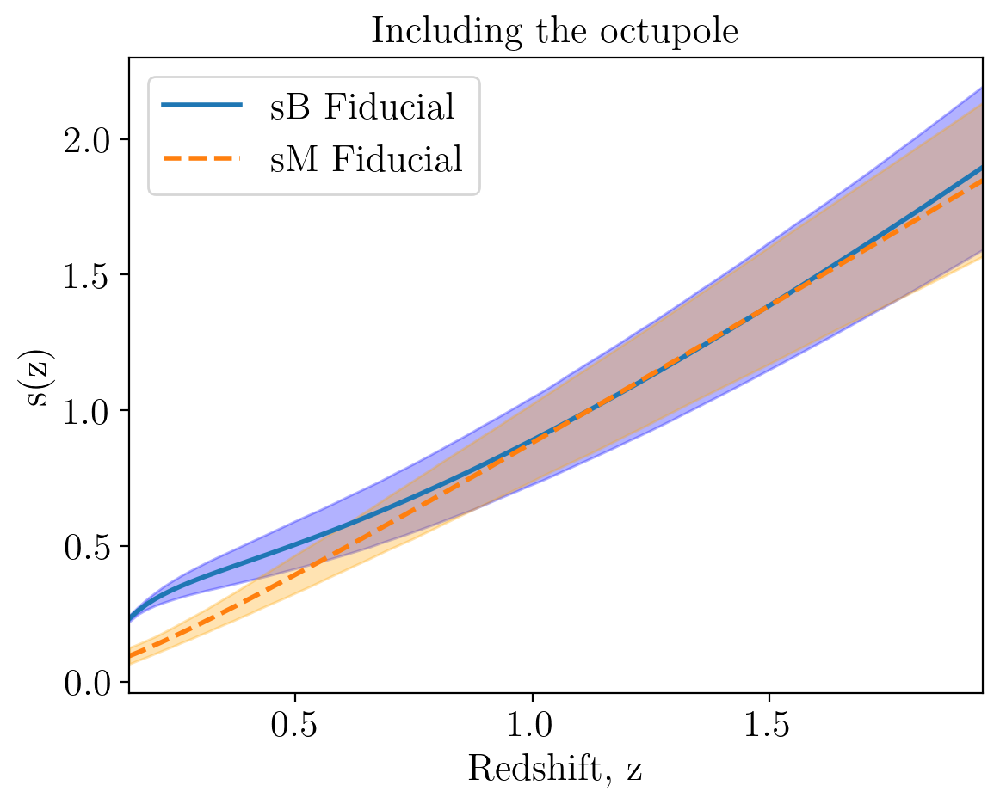

In [100]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0)
plt.plot(z_lin, sM_fid, '--', label=r'sM Fiducial', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_all, sB_upper_bound_all, color='blue', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound_all, sM_upper_bound_all, color='orange', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

###### Compare with priors

In [101]:
# Select the marginalized covariance matrix for the magnification biases priors

cov_sB_priors = Cov_all_19bins[:4, :4]
cov_sM_priors = Cov_all_19bins[4:8, 4:8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sB_pars_samples_priors = np.random.multivariate_normal(sB_4fit, cov_sB_priors, num_samples)
sM_pars_samples_priors = np.random.multivariate_normal(sF_4fit, cov_sM_priors, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_priors = np.array([magbias_fit(pars, z_lin) for pars in sB_pars_samples_priors])
sM_samples_priors = np.array([magbias_fit(pars, z_lin) for pars in sM_pars_samples_priors])

# Calculate the 68% confidence interval
sB_lower_bound_priors = np.percentile(sB_samples_priors, 16, axis=0)
sB_upper_bound_priors = np.percentile(sB_samples_priors, 84, axis=0)
sM_lower_bound_priors = np.percentile(sM_samples_priors, 16, axis=0)
sM_upper_bound_priors = np.percentile(sM_samples_priors, 84, axis=0)

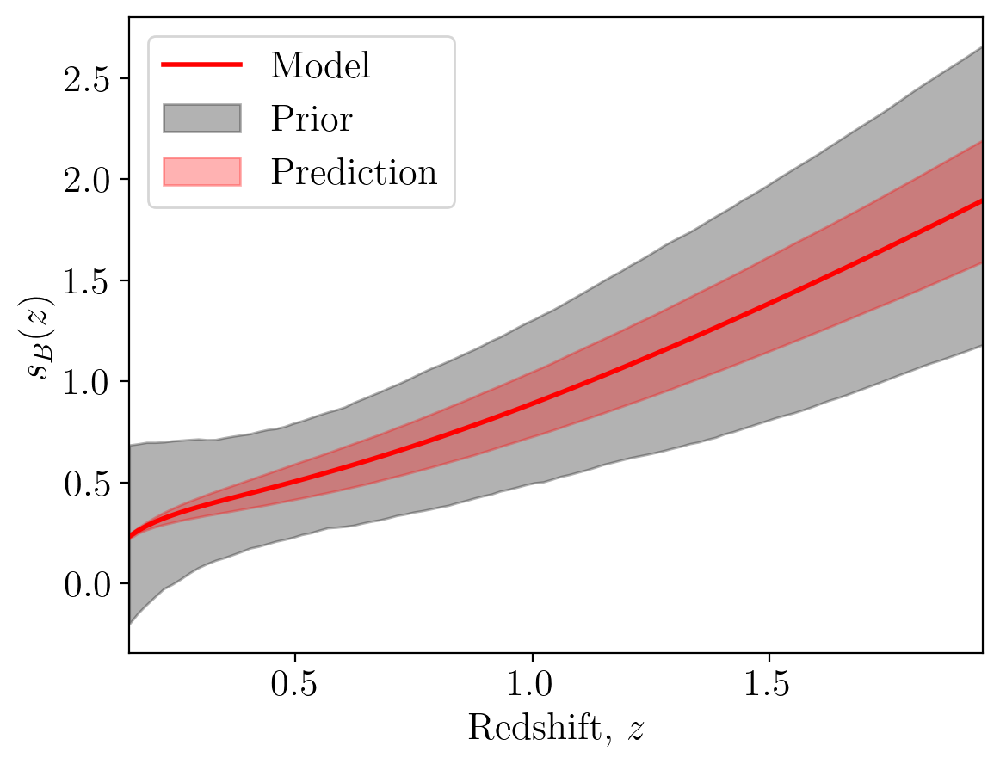

In [102]:
plt.plot(z_lin, sB_fid, '-', lw = 2.0, color='red', label='Model')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_priors, sB_upper_bound_priors, color='black', alpha=0.3, label='Prior')
plt.fill_between(z_lin, sB_lower_bound_all, sB_upper_bound_all, color='red', alpha=0.3, label='Prediction')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_B(z)$');
plt.legend(loc='upper left');
#plt.title(r'Prediction vs Prior (with octupole)')

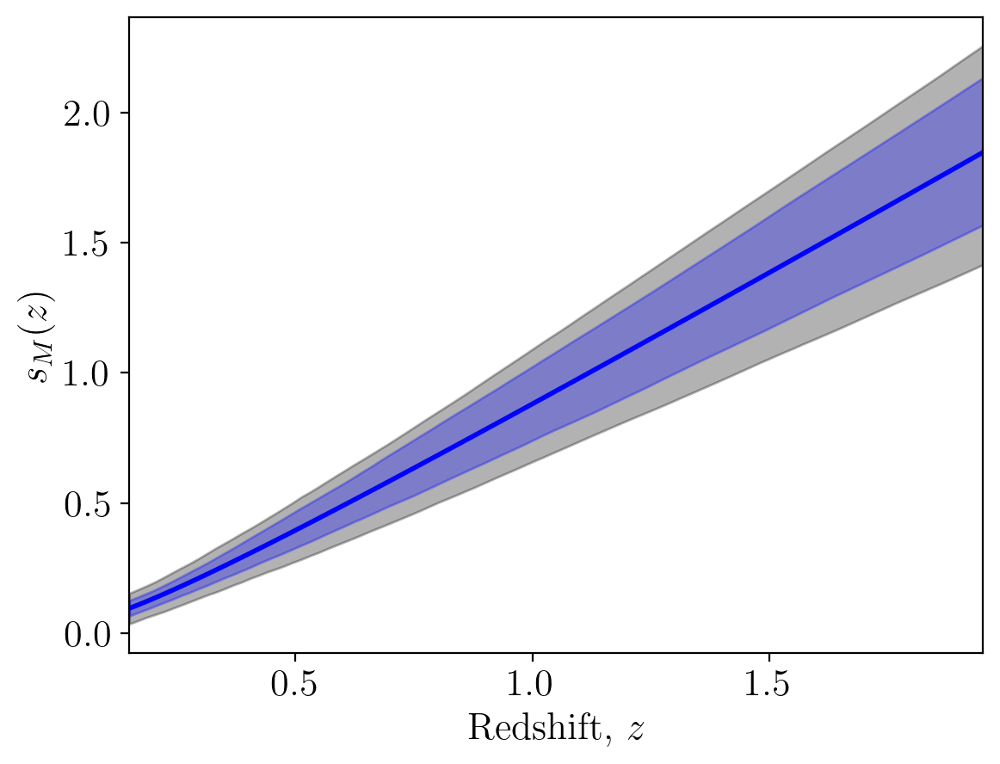

In [103]:
plt.plot(z_lin, sM_fid, '-', lw = 2.0, color='blue', label='Model')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sM_lower_bound_priors, sM_upper_bound_priors, color='black', alpha=0.3, label='Prior')
plt.fill_between(z_lin, sM_lower_bound_all, sM_upper_bound_all, color='blue', alpha=0.3, label='Prediction')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_M(z)$');
#plt.title(r'Prediction vs Prior (with octupole)')

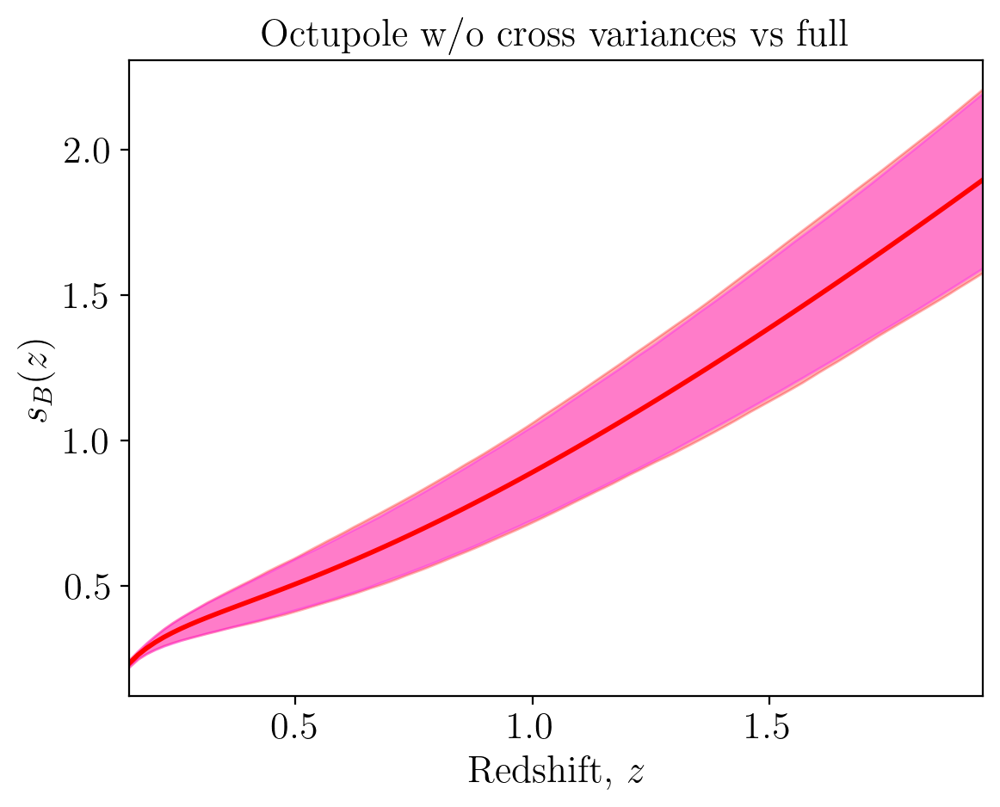

In [104]:
plt.plot(z_lin, sB_fid, '-', lw = 2.0, color='red')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_, sB_upper_bound_, color='red', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound_all, sB_upper_bound_all, color='magenta', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_B(z)$');
plt.title(r'Octupole w/o cross variances vs full');

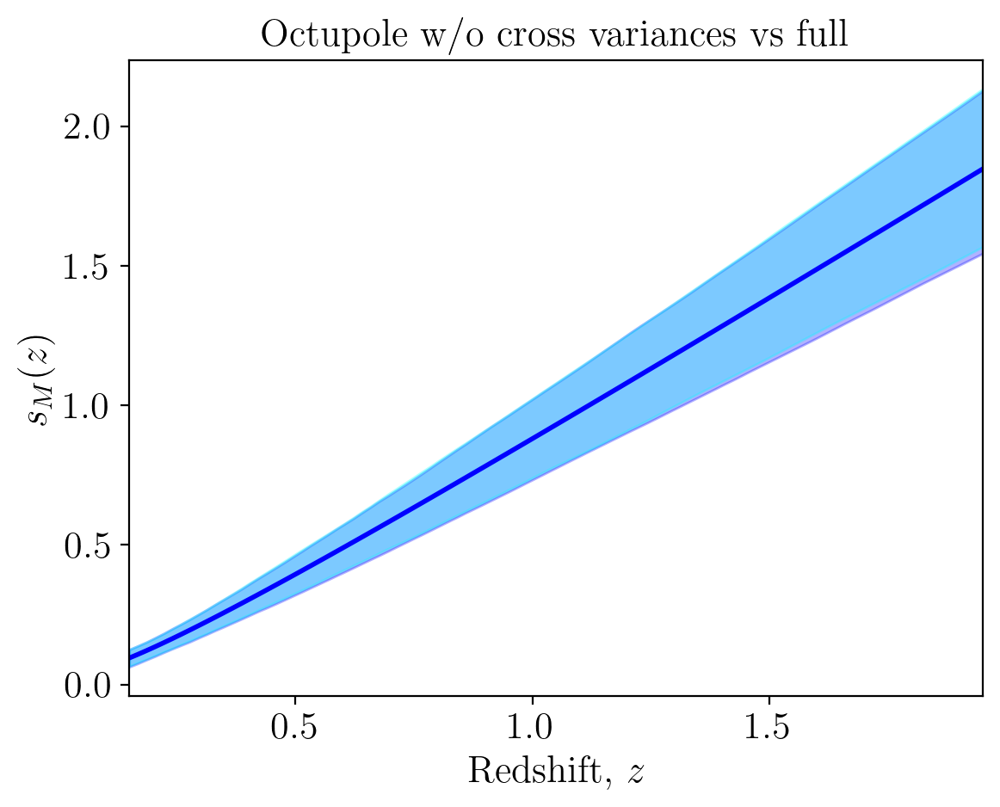

In [105]:
plt.plot(z_lin, sM_fid, '-', lw = 2.0, color='blue')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sM_lower_bound_, sM_upper_bound_, color='blue', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound_all, sM_upper_bound_all, color='cyan', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_M(z)$');
plt.title(r'Octupole w/o cross variances vs full');

###### Compare with no-octupole

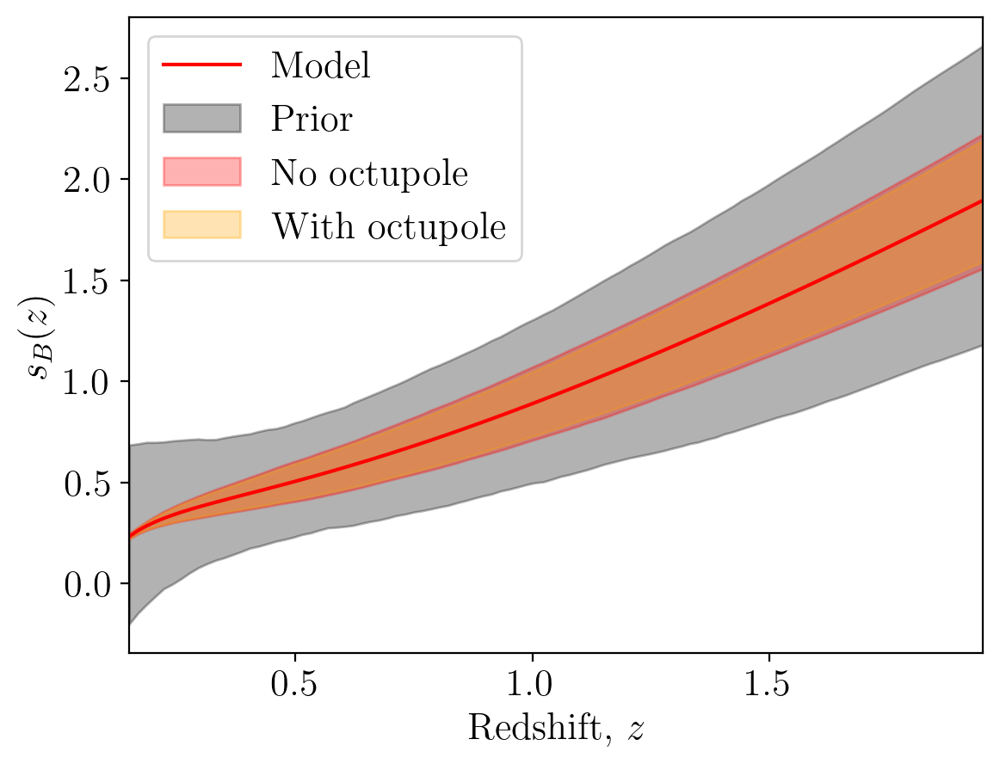

In [115]:
plt.plot(z_lin, sB_fid, '-', lw = 1.5, color='red', label=r'Model')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_priors, sB_upper_bound_priors, color='black', alpha=0.3, label=r'Prior')
plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='red', alpha=0.3, label=r'No octupole')
plt.fill_between(z_lin, sB_lower_bound_all, sB_upper_bound_all, color='orange', alpha=0.3, label=r'With octupole')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_B(z)$');
#plt.title(r'With and without octupole');
plt.legend(loc='upper left');

plt.savefig("plots/sB_prediction_70x30_full_vs_noct_vs_prior20.pdf", bbox_inches='tight', format='pdf')

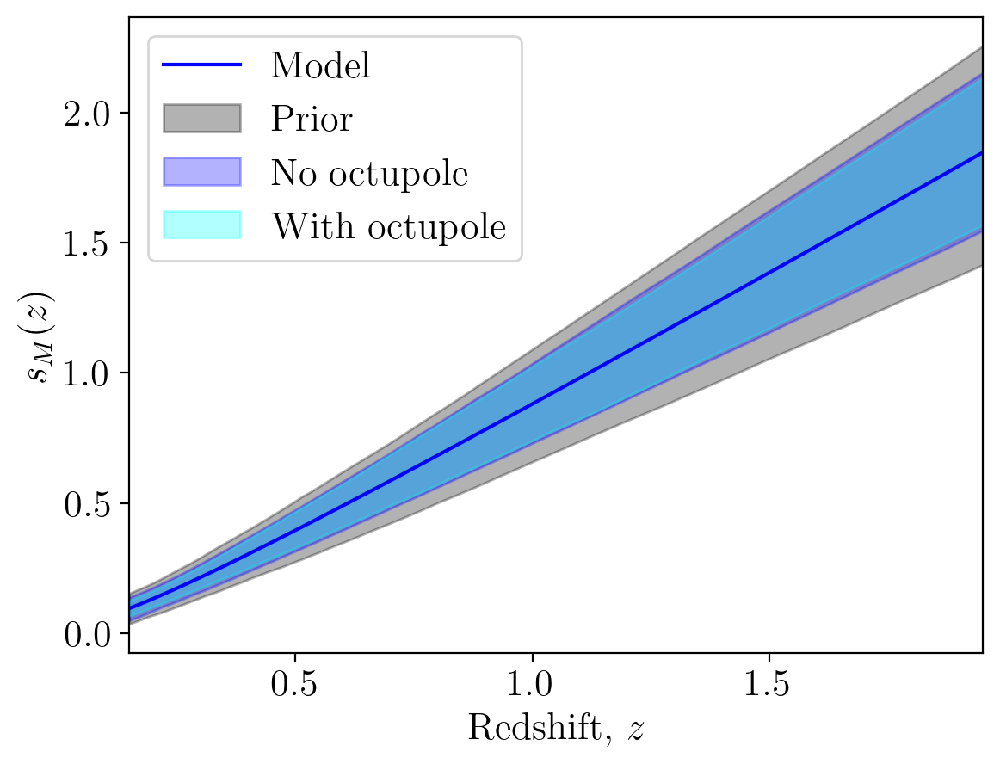

In [116]:
plt.plot(z_lin, sM_fid, '-', lw = 1.5, color='blue', label='Model')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sM_lower_bound_priors, sM_upper_bound_priors, color='black', alpha=0.3, label='Prior')
plt.fill_between(z_lin, sM_lower_bound, sM_upper_bound, color='blue', alpha=0.3, label='No octupole')
plt.fill_between(z_lin, sM_lower_bound_all, sM_upper_bound_all, color='cyan', alpha=0.3, label='With octupole')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_M(z)$');
#plt.title(r'With and without octupole');
plt.legend(loc='upper left')

plt.savefig("plots/sM_prediction_70x30_full_vs_noct_vs_prior20.pdf", bbox_inches='tight', format='pdf')

###### Magnification bias of the Faint

The magnification bias of the faint population is obtained by:

$$ s_F(z) = s_{model}(z)\frac{\bar{N}(z)}{\bar{N}_F(z)} - s_B(z)\frac{\bar{N}_B(z)}{\bar{N}_F(z)} = s_F(z) = s_{model}(z)\frac{m}{m-1} - s_B(z)\frac{1}{m-1} $$ 

We need to sample together the $s_B$ and $s_m$ parameters.

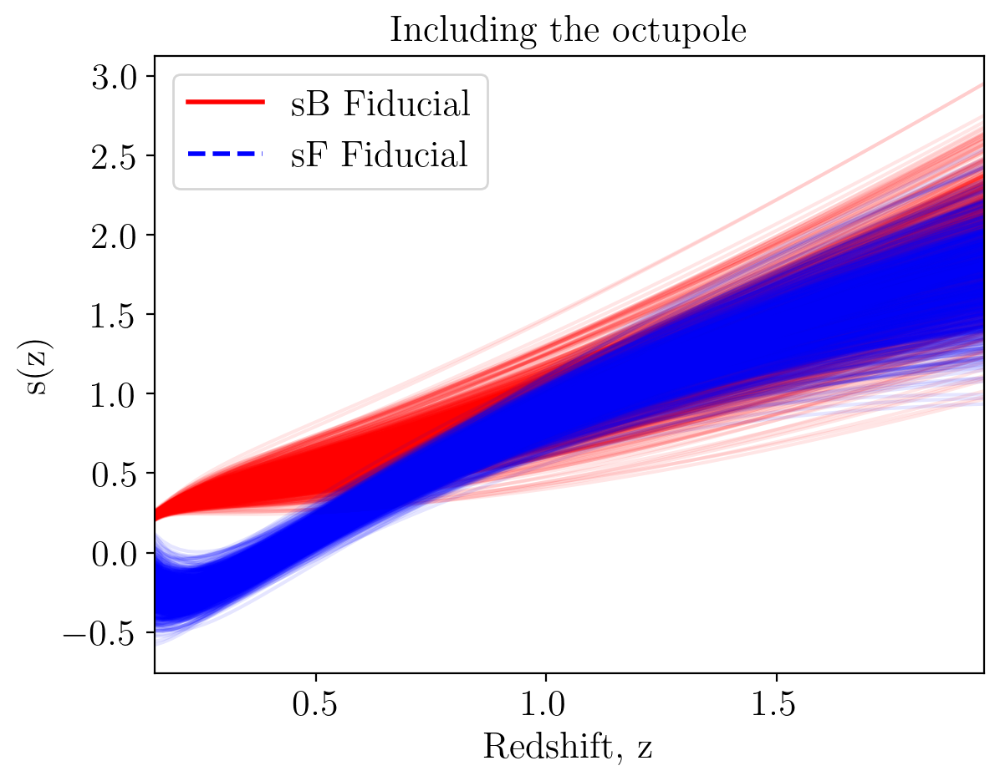

In [108]:
# Select the marginalized covariance matrix for the magnification biases together
cov_sbias_all = Sigma_Matrix_oct_all_19bins[:8, :8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sbias_pars_samples_all = np.random.multivariate_normal(sbias_fid, cov_sbias_all, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_all = np.array([magbias_fit(pars[:4], z_lin) for pars in sbias_pars_samples_all])
sM_samples_all = np.array([magbias_fit(pars[4:8], z_lin) for pars in sbias_pars_samples_all])

# Compute the sF for each sample
sF_samples_all = sM_samples_all*m_split/(m_split-1) - sB_samples_all/(m_split-1)

# Calculate the 68% confidence interval
sF_lower_bound_all = np.percentile(sF_samples_all, 16, axis=0)
sF_upper_bound_all = np.percentile(sF_samples_all, 84, axis=0)

# Step 5: Plotting

plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='red')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='blue')

# Plot the fitting function for each sample
for sample in sB_samples_all:
    plt.plot(z_lin, sample, color='red', alpha=0.1)

for sample in sF_samples_all:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

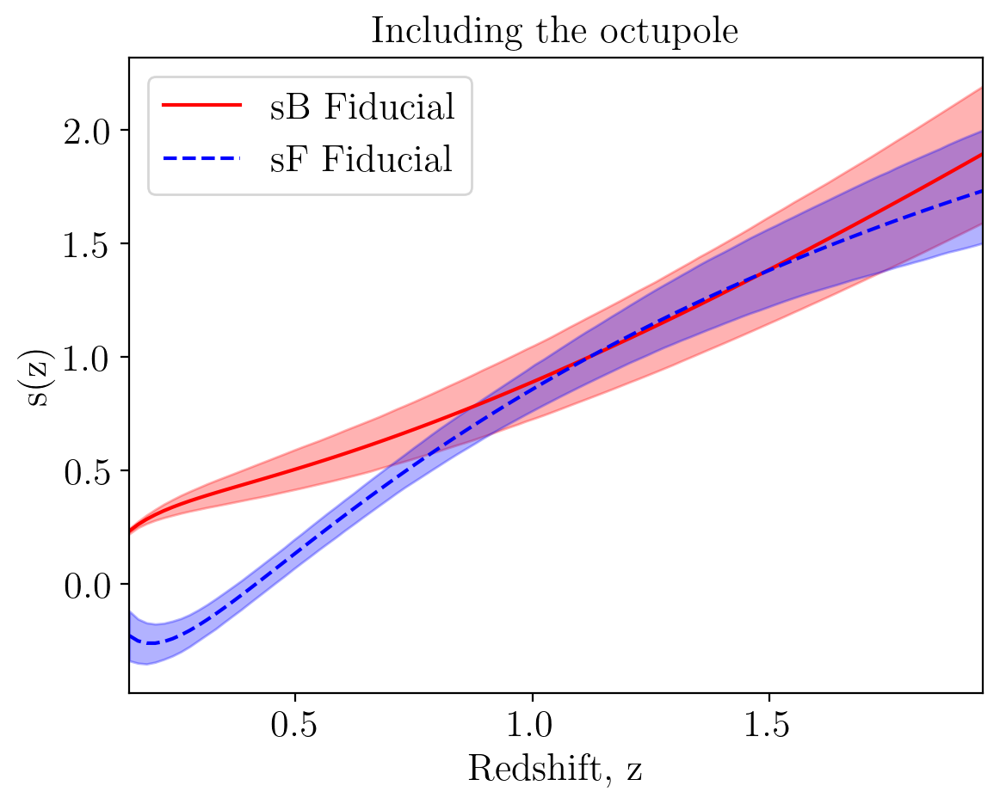

In [109]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 1.5, color='red')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 1.5, color='blue')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_all, sB_upper_bound_all, color='red', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_all, sF_upper_bound_all, color='blue', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

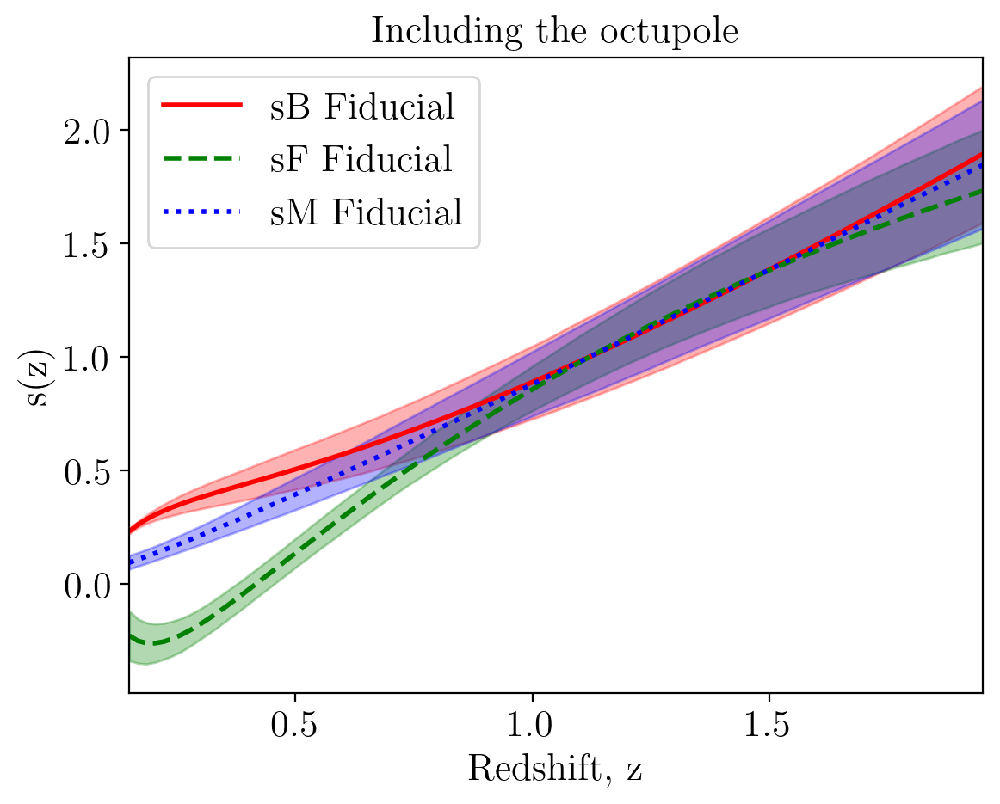

In [110]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='red')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='green')
plt.plot(z_lin, sM_fid, ':', label=r'sM Fiducial', lw = 2.0, color='blue')


# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_all, sB_upper_bound_all, color='red', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_all, sF_upper_bound_all, color='green', alpha=0.3)
plt.fill_between(z_lin, sM_lower_bound_all, sM_upper_bound_all, color='blue', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

Compare with priors

In [111]:
# Select the marginalized covariance matrix for the magnification biases together
cov_sbias_priors = Cov_all_19bins[:8, :8]

# Generate parameter samples from multivariate normal distribution
num_samples = 1000
sbias_pars_samples_priors = np.random.multivariate_normal(sbias_fid, cov_sbias_priors, num_samples)

# Evaluate fitting function for each parameter sample
sB_samples_priors = np.array([magbias_fit(pars[:4], z_lin) for pars in sbias_pars_samples_priors])
sM_samples_priors = np.array([magbias_fit(pars[4:8], z_lin) for pars in sbias_pars_samples_priors])

# Compute the sF for each sample
sF_samples_priors = sM_samples_priors*m_split/(m_split-1) - sB_samples_priors/(m_split-1)

# Calculate the 68% confidence interval
sF_lower_bound_priors = np.percentile(sF_samples_priors, 16, axis=0)
sF_upper_bound_priors = np.percentile(sF_samples_priors, 84, axis=0)

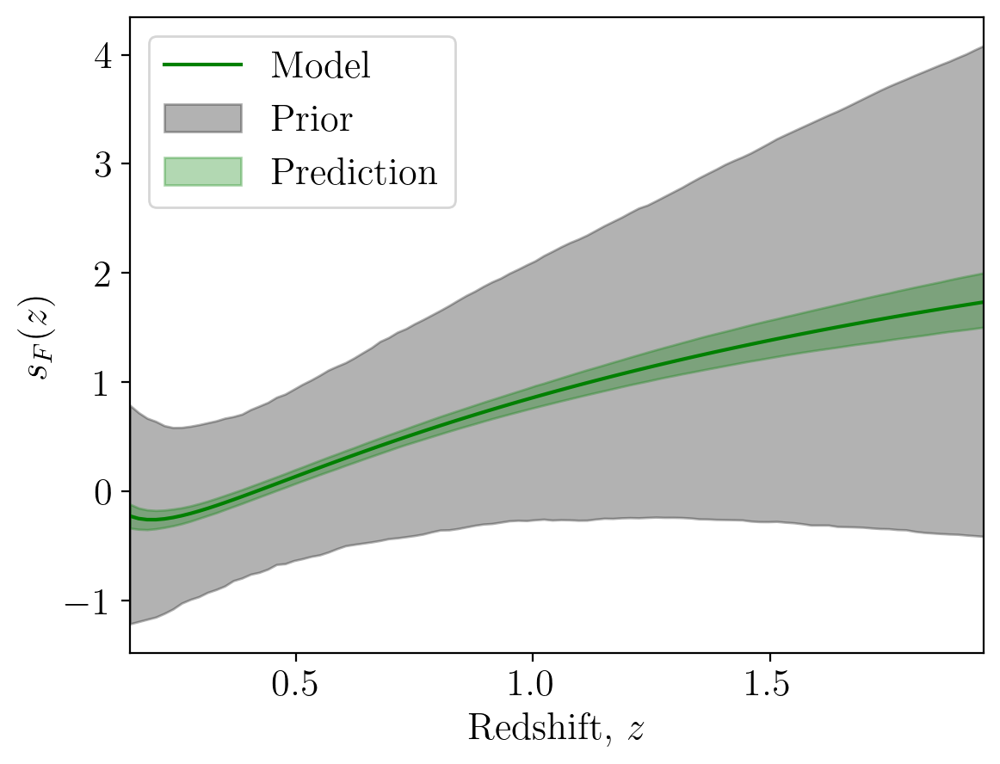

In [112]:
plt.plot(z_lin, sF_fid, '-', lw = 1.5, color='green', label='Model')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sF_lower_bound_priors, sF_upper_bound_priors, color='black', alpha=0.3, label='Prior')
plt.fill_between(z_lin, sF_lower_bound_all, sF_upper_bound_all, color='green', alpha=0.3, label='Prediction')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_F(z)$');
#plt.title(r'Prediction vs Prior (with octupole)')
plt.legend(loc='upper left')

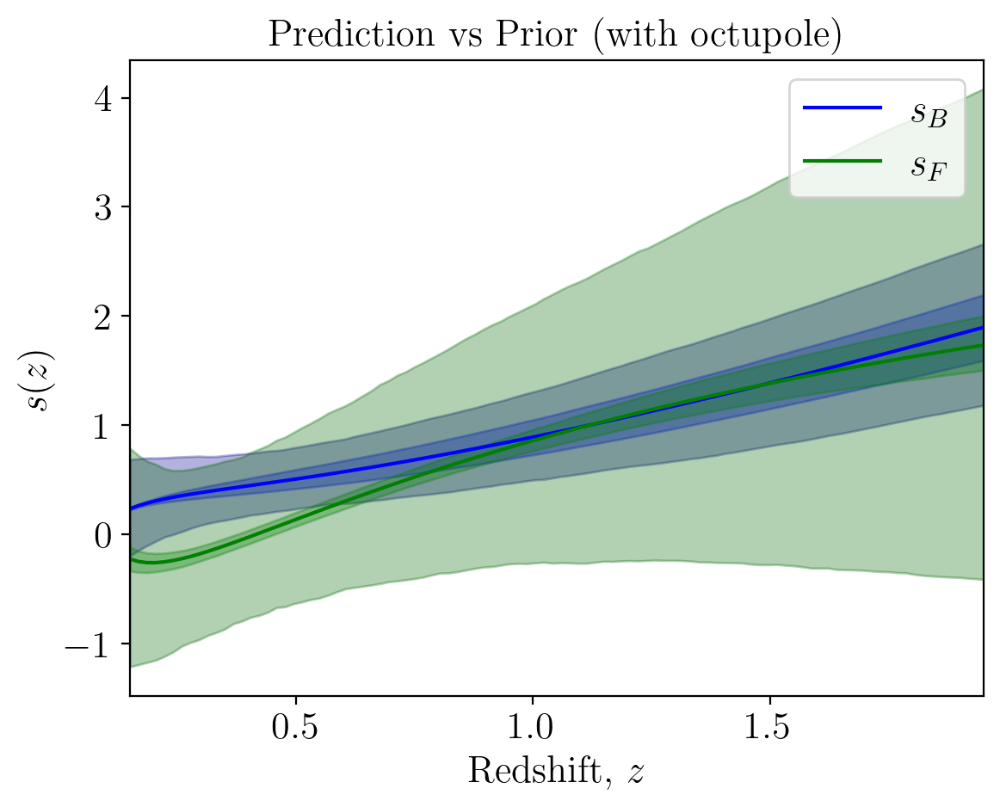

In [113]:
plt.plot(z_lin, sB_fid, '-', lw = 1.5, color='blue', label=r'$s_B$')
plt.plot(z_lin, sF_fid, '-', lw = 1.5, color='green', label=r'$s_F$')


# Shade the 68% confidence interval

plt.fill_between(z_lin, sB_lower_bound_priors, sB_upper_bound_priors, color='darkblue', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound_all, sB_upper_bound_all, color='blue', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_priors, sF_upper_bound_priors, color='darkgreen', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_all, sF_upper_bound_all, color='green', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s(z)$');
plt.title(r'Prediction vs Prior (with octupole)');
plt.legend();

Compare with no octupole

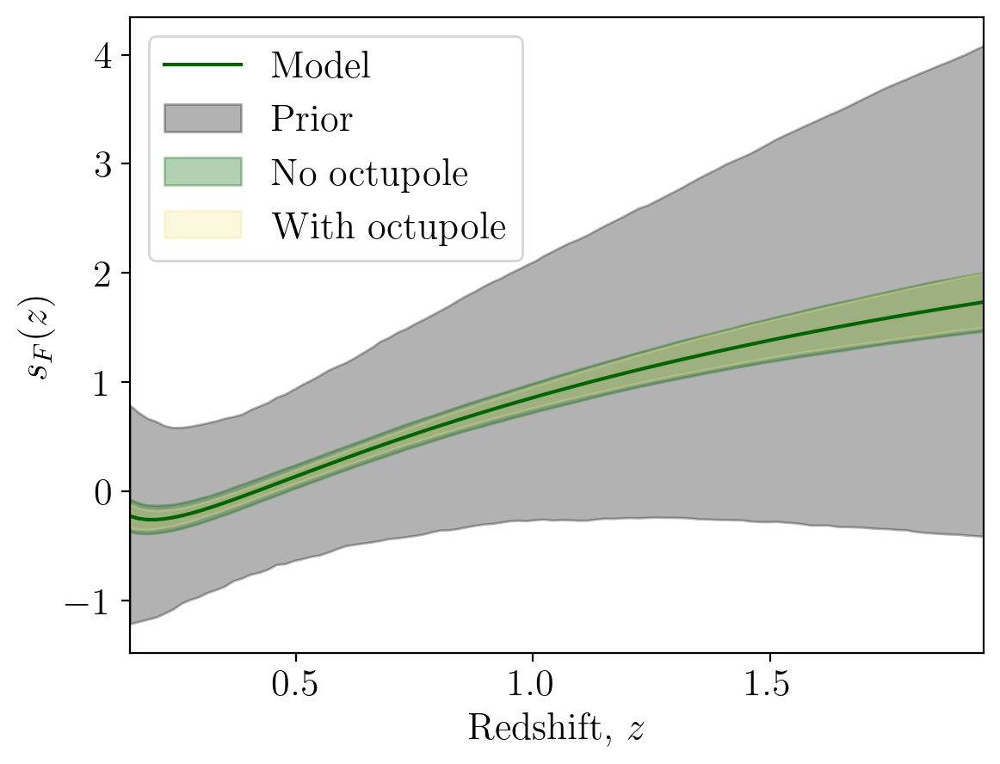

In [117]:
plt.plot(z_lin, sF_fid, '-', lw = 1.5, color='darkgreen', label='Model')

# Shade the 68% confidence interval

plt.fill_between(z_lin, sF_lower_bound_priors, sF_upper_bound_priors, color='black', alpha=0.3, label='Prior')
plt.fill_between(z_lin, sF_lower_bound, sF_upper_bound, color='darkgreen', alpha=0.3, label='No octupole')
plt.fill_between(z_lin, sF_lower_bound_all, sF_upper_bound_all, color='khaki', alpha=0.3, label='With octupole')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, $z$');
plt.ylabel(r'$s_F(z)$');
#plt.title(r'With and without octupole');
plt.legend(loc='upper left');

plt.savefig("plots/sF_prediction_70x30_full_vs_noct_vs_prior20.pdf", bbox_inches='tight', format='pdf')

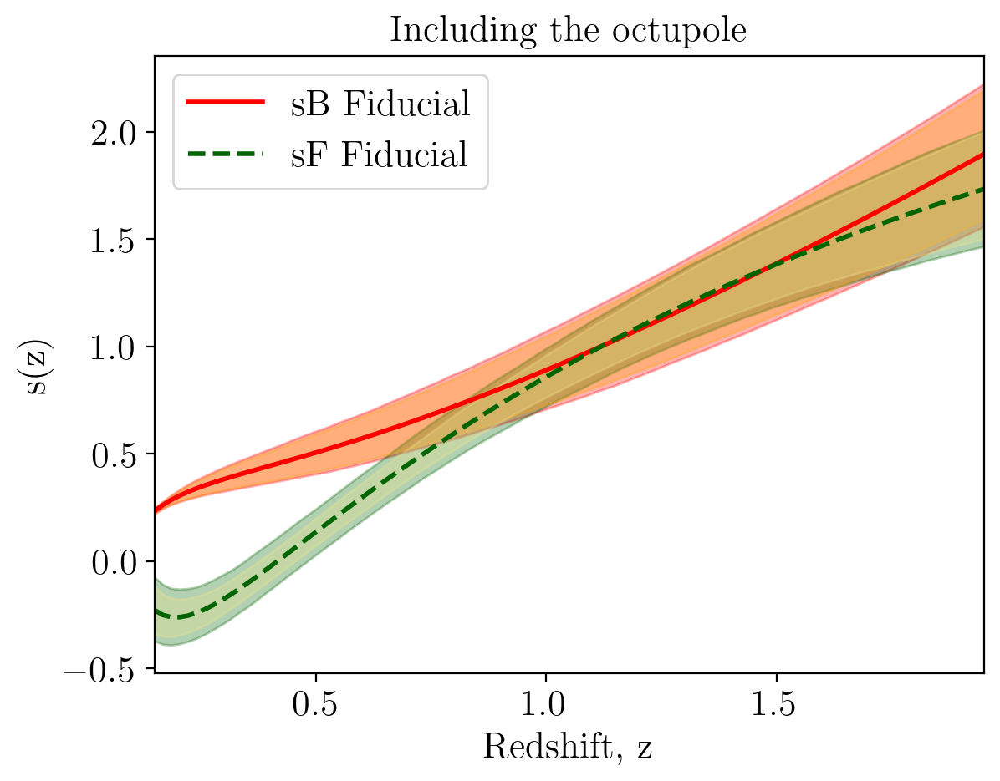

In [118]:
plt.plot(z_lin, sB_fid, '-', label=r'sB Fiducial', lw = 2.0, color='red')
plt.plot(z_lin, sF_fid, '--', label=r'sF Fiducial', lw = 2.0, color='darkgreen')

# Shade the 68% confidence interval
plt.fill_between(z_lin, sB_lower_bound, sB_upper_bound, color='red', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound, sF_upper_bound, color='darkgreen', alpha=0.3)
plt.fill_between(z_lin, sB_lower_bound_all, sB_upper_bound_all, color='orange', alpha=0.3)
plt.fill_between(z_lin, sF_lower_bound_all, sF_upper_bound_all, color='khaki', alpha=0.3)

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r's(z)')
plt.title('Including the octupole')
plt.legend();

##### Number evolution

In [119]:
def nevol_fit(params, x):
    a, b, c, d = params
    return a + b * x + c * (1/x) + d * np.exp(-x)

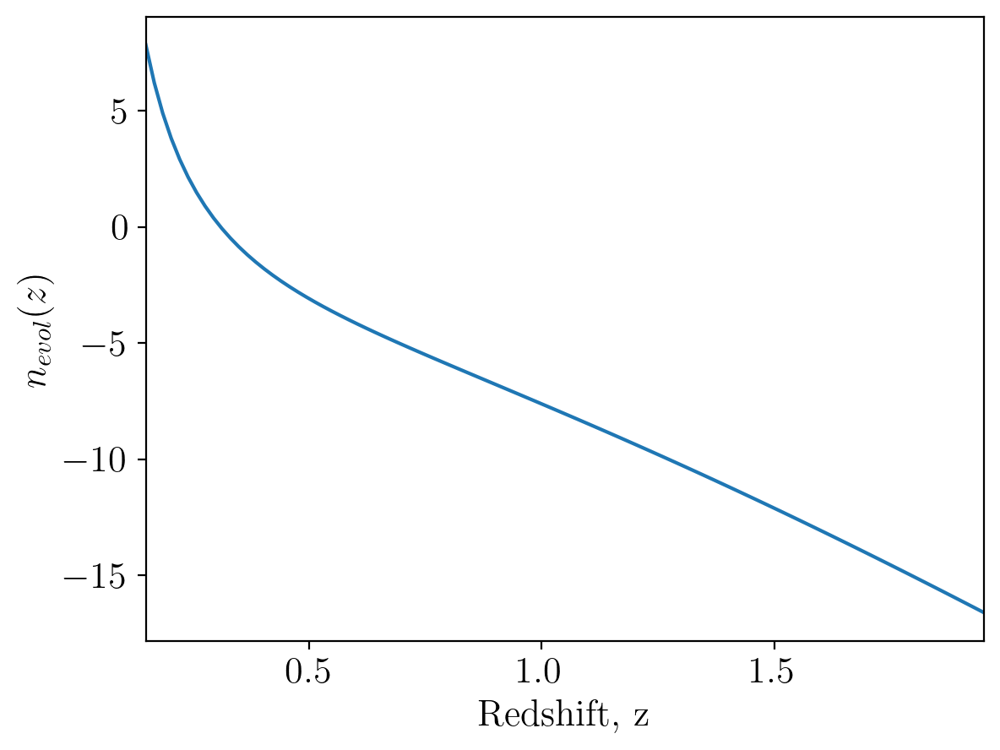

In [120]:
z_lin = np.linspace(z_bins[0], z_bins[-1], 100)
m_split = 10/7

num_evol_fid = nevol_fit(nevol_fid, z_lin)

plt.plot(z_lin, num_evol_fid, '-')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$n_{evol}(z)$');

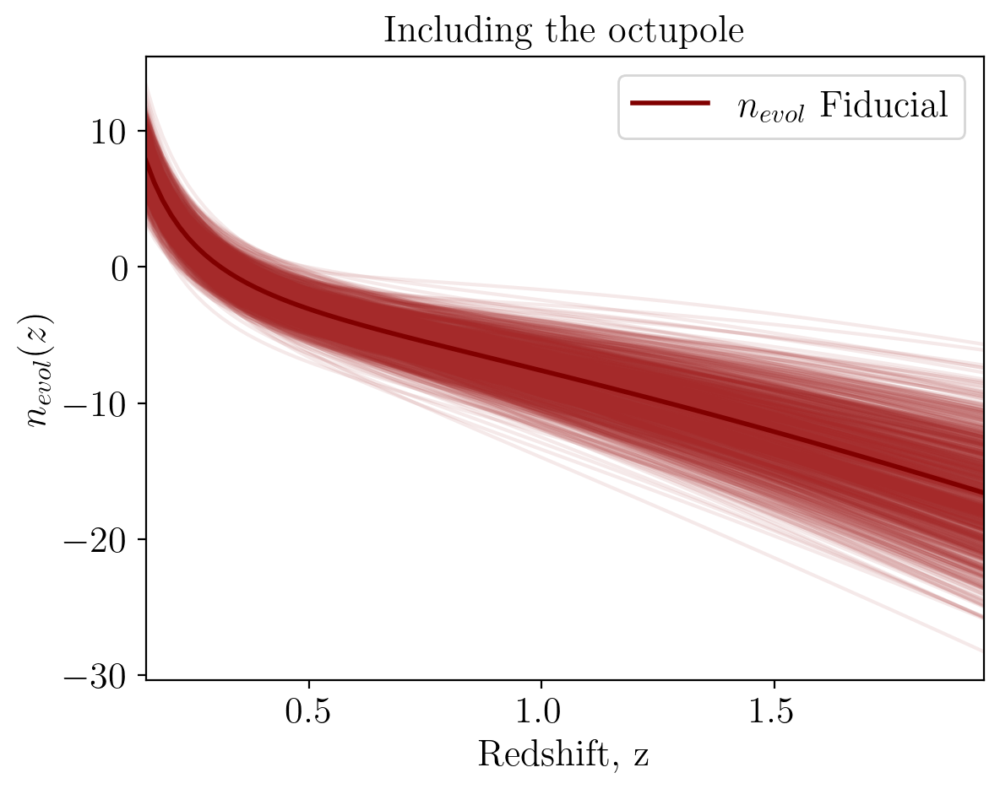

In [121]:
# Select the marginalized covariance matrix for the number evolution
cov_numevol_all = Sigma_Matrix_oct_all_19bins[8:12, 8:12]
cov_numevol_priors = Cov_all_19bins[8:12, 8:12]


# Generate parameter samples from multivariate normal distribution
num_samples = 1000
nevol_pars_samples_all = np.random.multivariate_normal(nevol_fid, cov_numevol_all, num_samples)
nevol_samples_priors = np.random.multivariate_normal(nevol_fid, cov_numevol_priors, num_samples)


# Evaluate fitting function for each parameter sample
nevol_samples_all = np.array([nevol_fit(pars, z_lin) for pars in nevol_pars_samples_all])
nevol_samples_priors = np.array([nevol_fit(pars, z_lin) for pars in nevol_samples_priors])

# Calculate the 68% confidence interval
nevol_lower_bound_all = np.percentile(nevol_samples_all, 16, axis=0)
nevol_upper_bound_all = np.percentile(nevol_samples_all, 84, axis=0)
nevol_lower_bound_priors = np.percentile(nevol_samples_priors, 16, axis=0)
nevol_upper_bound_priors = np.percentile(nevol_samples_priors, 84, axis=0)

# Step 5: Plotting

# Plot the fitting function for each sample
for sample in nevol_samples_all:
    plt.plot(z_lin, sample, color='brown', alpha=0.1)
    
plt.plot(z_lin, num_evol_fid, '-', color='maroon', label=r'$n_{evol}$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$n_{evol}(z)$')
plt.title('Including the octupole')
plt.legend();

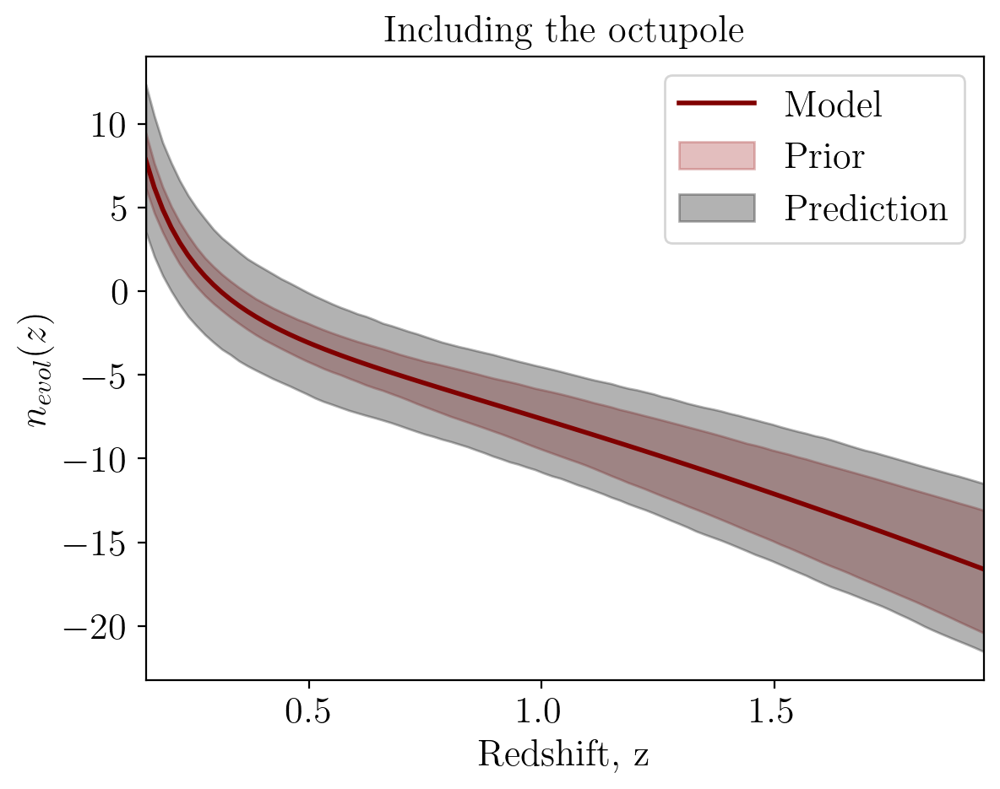

In [122]:
plt.plot(z_lin, num_evol_fid, '-', color='maroon', label=r'Model', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, nevol_lower_bound_all, nevol_upper_bound_all, color='brown', alpha=0.3, label=r'Prior')
plt.fill_between(z_lin, nevol_lower_bound_priors, nevol_upper_bound_priors, color='black', alpha=0.3, label=r'Prediction')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$n_{evol}(z)$')
plt.title('Including the octupole')
plt.legend();

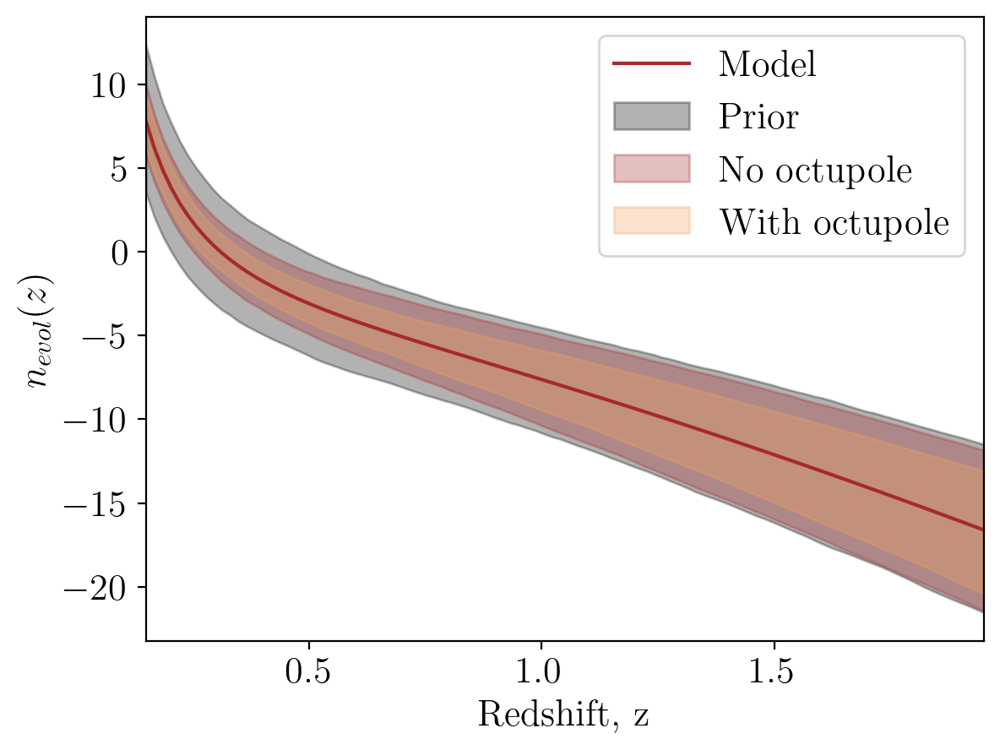

In [124]:
plt.plot(z_lin, num_evol_fid, '-', color='brown', label=r'Model', lw = 1.5)

# Shade the 68% confidence interval

plt.fill_between(z_lin, nevol_lower_bound_priors, nevol_upper_bound_priors, color='black', alpha=0.3, label='Prior')
plt.fill_between(z_lin, nevol_lower_bound, nevol_upper_bound, color='brown', alpha=0.3, label='No octupole')
plt.fill_between(z_lin, nevol_lower_bound_all, nevol_upper_bound_all, color='sandybrown', alpha=0.3, label='With octupole')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$n_{evol}(z)$')
#plt.title('With and without octupole')
plt.legend();

plt.savefig("plots/nevol_prediction_70x30_full_vs_noct_vs_prior20.pdf", bbox_inches='tight', format='pdf')

##### Evolution bias

The evolution bias is computed from the magnification biases and the evolution of the number densities.

$$ f^{evol}_{B}(z) = -\frac{d\log{N_B(z)}}{d\log{(1+z)}} - \frac{d\log{H(z)}}{d\log{(1+z)}} + \frac{2(1+z)}{r(z)H(z)} -5\,s_B(z)\left(1+\frac{(1+z)}{r(z)H(z)}\right) - \frac{5}{2}s_B(z)\,\frac{d\log{F_c}}{d\log{(1+z)}} $$

$$ f^{evol}_{F}(z) = -\frac{d\log{N_F(z)}}{d\log{(1+z)}} - \frac{d\log{H(z)}}{d\log{(1+z)}} + \frac{2(1+z)}{r(z)H(z)} -5\,s_F(z)\left(1+\frac{(1+z)}{r(z)H(z)}\right) 
    - \frac{5}{2}\left[\frac{\bar{N}}{\bar{N}_F}\,s_{model}(z)\frac{d\log{F_*}}{d\log{(1+z)}}-\frac{\bar{N}_B}{\bar{N}_F}\,s_B(z)\frac{d\log{F_c}}{d\log{(1+z)}}\right] $$

We have all the ingredients defined as methods in the EvolutionBias class. We need to extract the relevant terms and then sample togeter the $n_{evol}$ and magnification bias parameters to construct the predictions for each evolution bias. 

In [125]:
m_split = 10/7

myEvolBias = EvolutionBias(n_split=m_split)

dlogH = myEvolBias.dlogH
rHterm = myEvolBias.rHterm
dFstar = myEvolBias.dLogFstar
dFcut = myEvolBias.dLogFcut

In [126]:
def fevol_bright(pars_s, pars_n, z):
    pars_sB = pars_s[:4] 
    return - nevol_fit(params=pars_n, x=z) - dlogH(z) + (2 - 5*magbias_fit(params=pars_sB, x=z))*rHterm(z) - 5*magbias_fit(params=pars_sB, x=z) - 5/2*magbias_fit(params=pars_sB, x=z)*dFcut(z)
    
def fevol_faint(pars_s, pars_n, z):
    
    pars_sB = pars_s[:4]
    pars_sM = pars_s[4:]
    s_B = magbias_fit(params=pars_sB, x=z)
    s_M = magbias_fit(params=pars_sM, x=z)
    s_faint = s_M*m_split/(m_split-1) - s_B/(m_split-1)
    
    return - nevol_fit(params=pars_n, x=z) - dlogH(z) + (2 - 5*s_faint)*rHterm(z) - 5*s_faint + 5/2*((1/(m_split-1)) * s_B *dFcut(z) - (m_split/(m_split-1)) * s_M *dFstar(z))

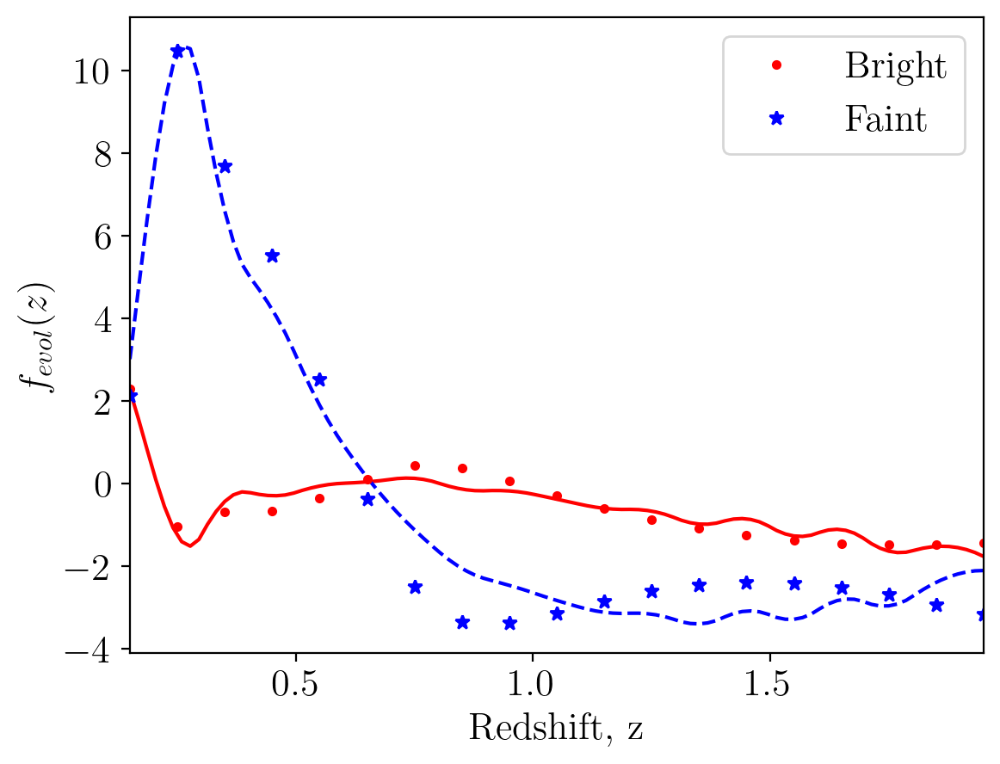

In [127]:
from scipy.interpolate import interp1d

z_lin = np.linspace(z_bins[0], z_bins[-1], 100)

fevol_B_fid = fevol_bright(pars_s = sbias_fid, pars_n = nevol_fid, z = z_lin)
fevol_F_fid = fevol_faint(pars_s = sbias_fid, pars_n = nevol_fid, z = z_lin)

plt.plot(z_lin, fevol_B_fid, 'r-')
plt.plot(z_lin, fevol_F_fid, 'b--')

feB_ = myEvolBias.fevol_bright(z_lin)
feF_ = myEvolBias.fevol_faint(z_lin)

feBi = interp1d(z_lin, feB_, kind='cubic', fill_value='extrapolate')
feFi = interp1d(z_lin, feF_, kind='cubic', fill_value='extrapolate')

feB = feBi(z_bins)
feF = feFi(z_bins)

plt.plot(z_bins, feB, 'r.', label='Bright')
plt.plot(z_bins, feF, 'b*', label='Faint')

plt.xlim(z_bins[0],z_bins[-1])

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f_{evol}(z)$');
plt.legend();

In [128]:
# Select the marginalized covariance matrix for the number evolution

cov_all_all = Sigma_Matrix_oct_all_19bins[:12, :12]
cov_all_priors = Cov_all_19bins[:12, :12]

all_fid = np.concatenate([sbias_fid, nevol_fid])

# Generate parameter samples from multivariate normal distribution

num_samples = 1000
all_pars_samples_all = np.random.multivariate_normal(all_fid, cov_all_all, num_samples)
all_pars_samples_priors = np.random.multivariate_normal(all_fid, cov_all_priors, num_samples)

# Evaluate fitting function for each parameter sample

fevol_B_samples_all = np.array([fevol_bright(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_all])
fevol_B_samples_priors = np.array([fevol_bright(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_priors])
fevol_F_samples_all = np.array([fevol_faint(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_all])
fevol_F_samples_priors = np.array([fevol_faint(pars_s = pars[:8], pars_n = pars[8:12], z = z_lin) for pars in all_pars_samples_priors])

# Calculate the 68% confidence intervals

fevol_B_lower_bound_all = np.percentile(fevol_B_samples_all, 16, axis=0)
fevol_B_upper_bound_all = np.percentile(fevol_B_samples_all, 84, axis=0)
fevol_B_lower_bound_priors = np.percentile(fevol_B_samples_priors, 16, axis=0)
fevol_B_upper_bound_priors = np.percentile(fevol_B_samples_priors, 84, axis=0)

fevol_F_lower_bound_all = np.percentile(fevol_F_samples_all, 16, axis=0)
fevol_F_upper_bound_all = np.percentile(fevol_F_samples_all, 84, axis=0)
fevol_F_lower_bound_priors = np.percentile(fevol_F_samples_priors, 16, axis=0)
fevol_F_upper_bound_priors = np.percentile(fevol_F_samples_priors, 84, axis=0)

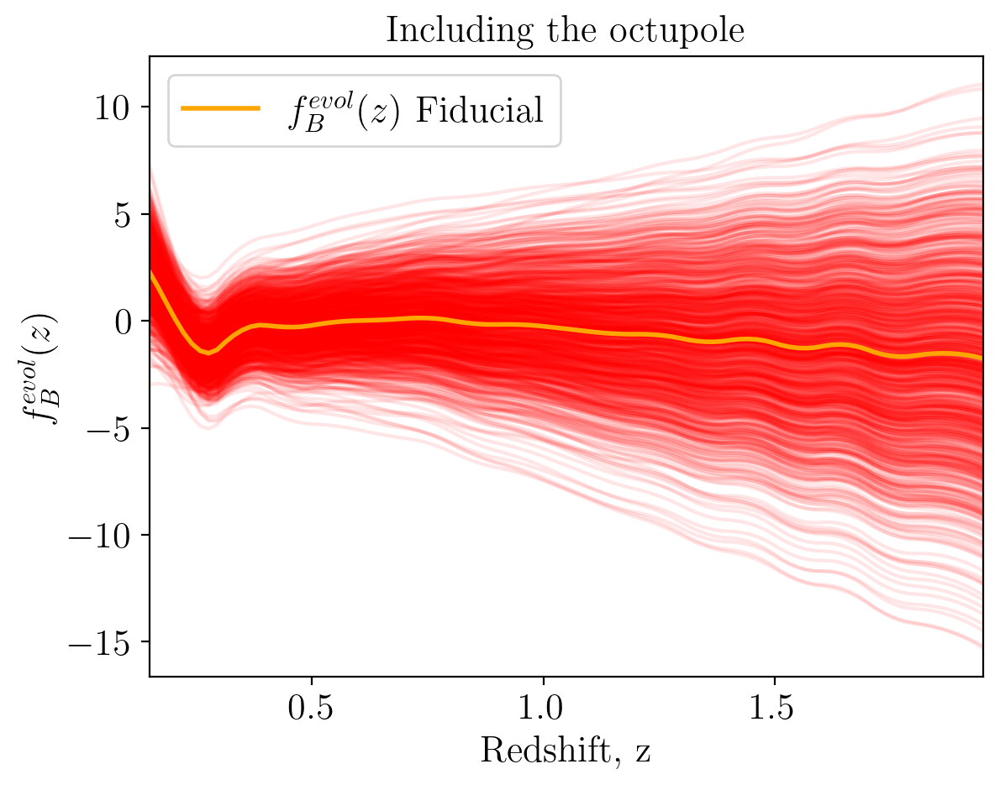

In [129]:
# Plot the fitting function for each sample
for sample in fevol_B_samples_all:
    plt.plot(z_lin, sample, color='red', alpha=0.1)
    
plt.plot(z_lin, fevol_B_fid, '-', color='orange', label=r'$f^{evol}_B(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
plt.title('Including the octupole')
plt.legend();

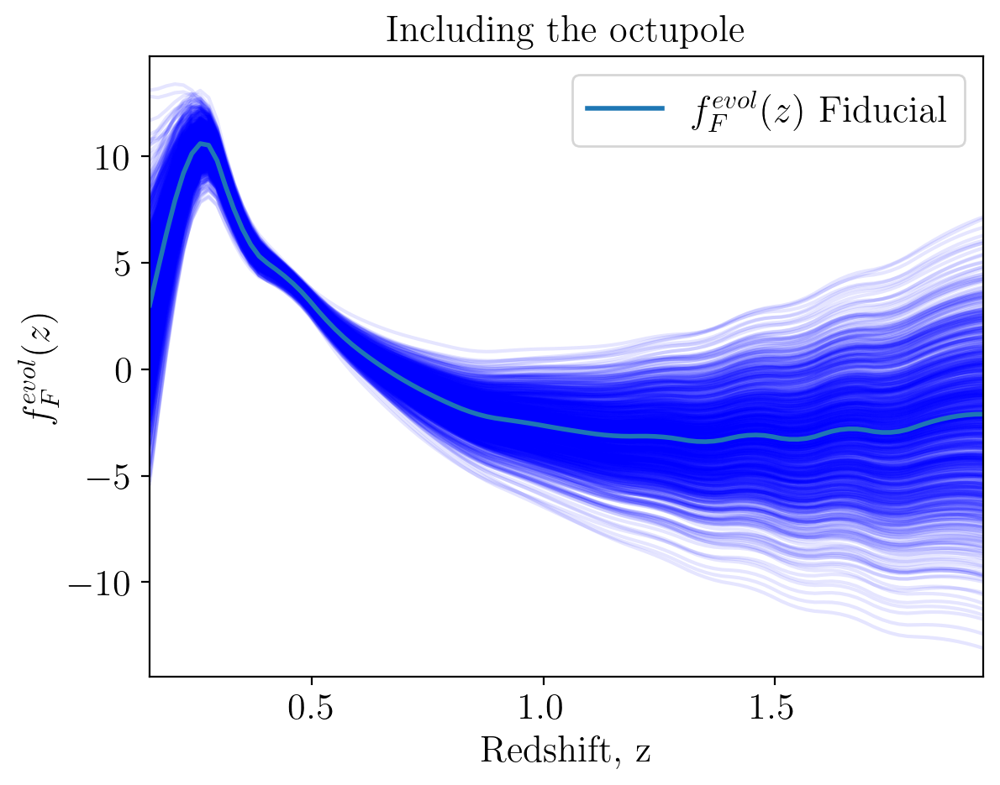

In [130]:
# Plot the fitting function for each sample
for sample in fevol_F_samples_all:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.plot(z_lin, fevol_F_fid, '-', label=r'$f^{evol}_F(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_F(z)$')
plt.title('Including the octupole')
plt.legend();

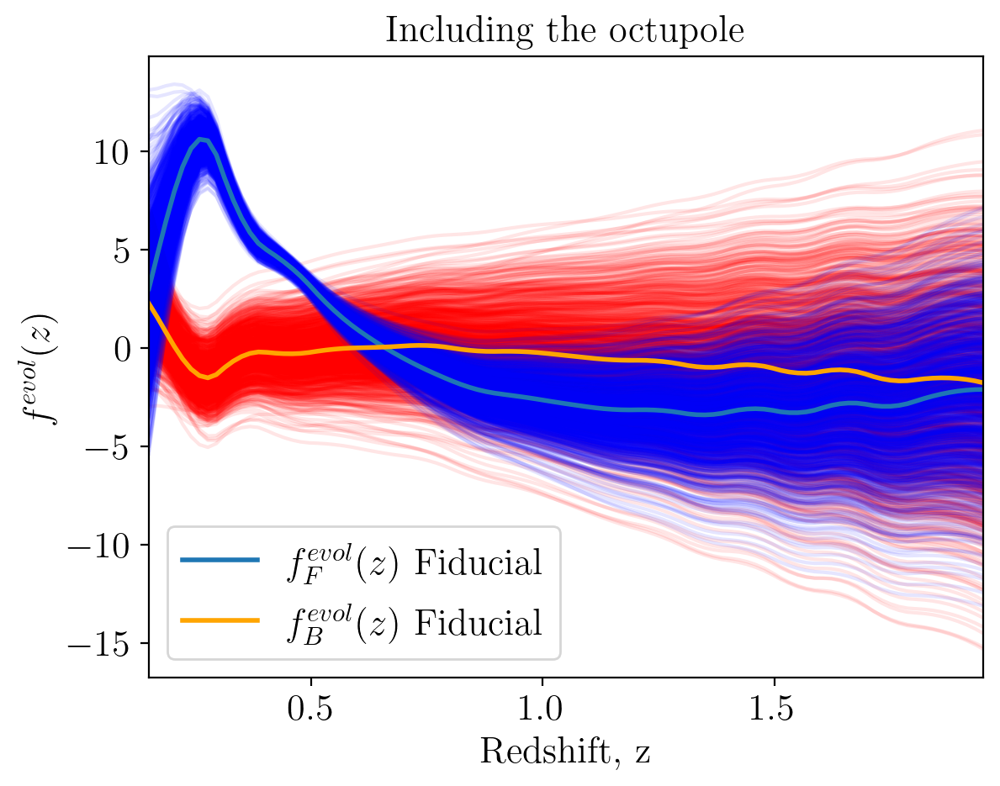

In [131]:
# Plot the fitting function for each sample
for sample in fevol_B_samples_all:
    plt.plot(z_lin, sample, color='red', alpha=0.1)

for sample in fevol_F_samples_all:
    plt.plot(z_lin, sample, color='blue', alpha=0.1)
    
plt.plot(z_lin, fevol_F_fid, '-', label=r'$f^{evol}_F(z)$'+' Fiducial', lw = 2.0)
plt.plot(z_lin, fevol_B_fid, '-', color='orange', label=r'$f^{evol}_B(z)$'+' Fiducial', lw = 2.0)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}(z)$')
plt.title('Including the octupole')
plt.legend();

Text(0.5, 1.0, 'Including the octupole')

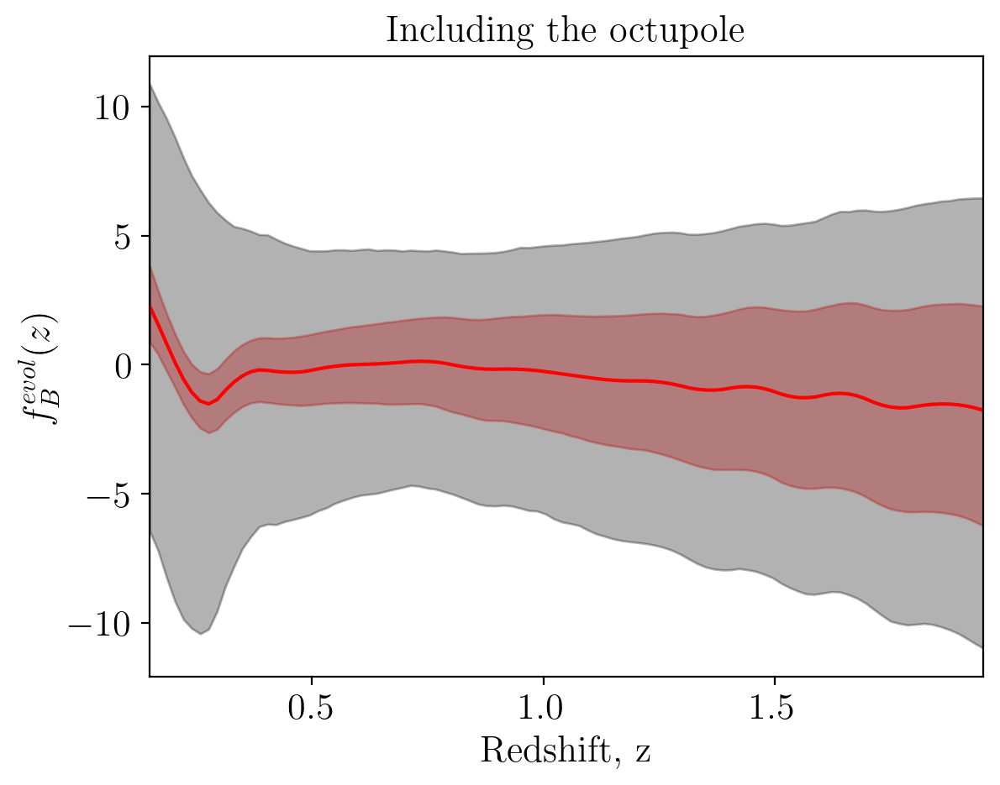

In [132]:
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 1.5)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_B_lower_bound_all, fevol_B_upper_bound_all, color='red', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound_priors, fevol_B_upper_bound_priors, color='black', alpha=0.3)


plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
plt.title('Including the octupole')

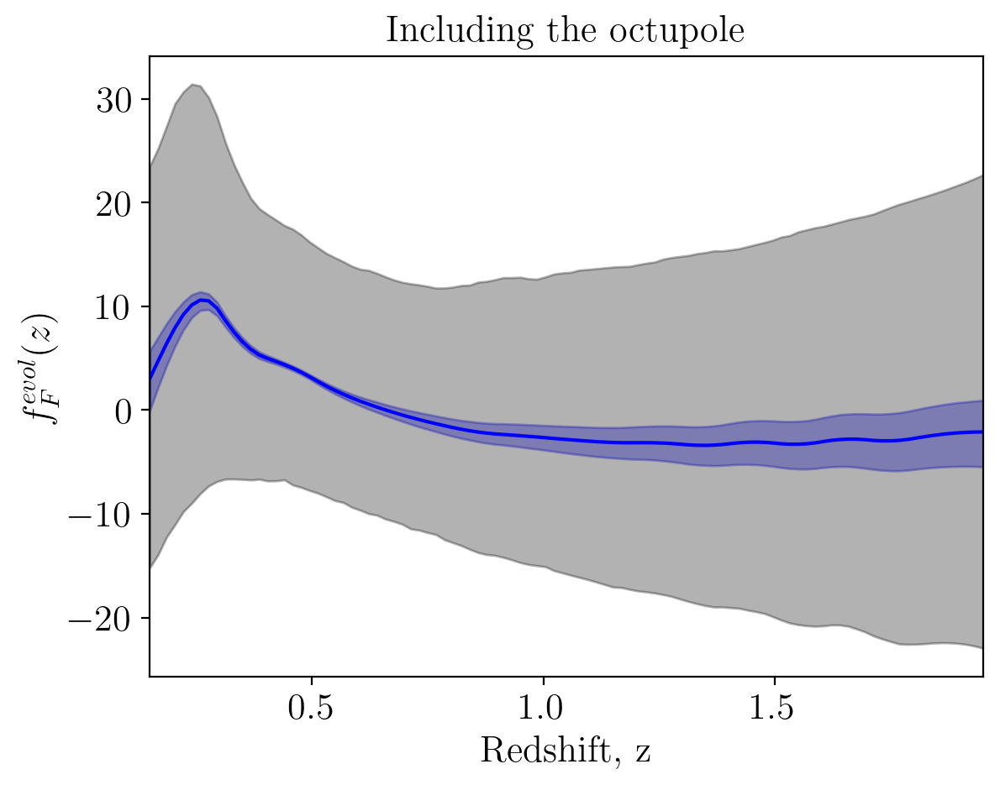

In [133]:
plt.plot(z_lin, fevol_F_fid, '-', color='blue', lw = 1.5)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_F_lower_bound_all, fevol_F_upper_bound_all, color='blue', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound_priors, fevol_F_upper_bound_priors, color='black', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f^{evol}_F(z)$');
plt.title('Including the octupole');

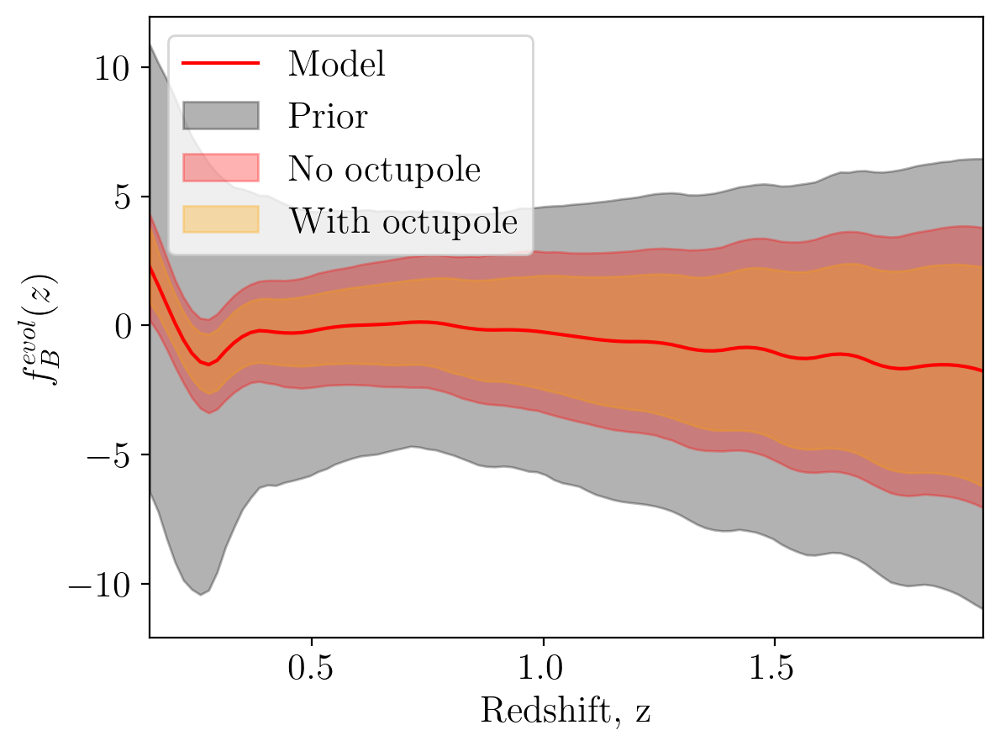

In [134]:
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 1.5, label = 'Model')

# Shade the 68% confidence interval


plt.fill_between(z_lin, fevol_B_lower_bound_priors, fevol_B_upper_bound_priors, color='black', alpha=0.3, label='Prior')
plt.fill_between(z_lin, fevol_B_lower_bound, fevol_B_upper_bound, color='red', alpha=0.3, label='No octupole')
plt.fill_between(z_lin, fevol_B_lower_bound_all, fevol_B_upper_bound_all, color='orange', alpha=0.3, label='With octupole')

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
#plt.title('With and without the octupole');
plt.legend(loc='upper left')

plt.savefig("plots/fevolB_prediction_70x30_full_vs_noct_vs_prior20.pdf", bbox_inches='tight', format='pdf')

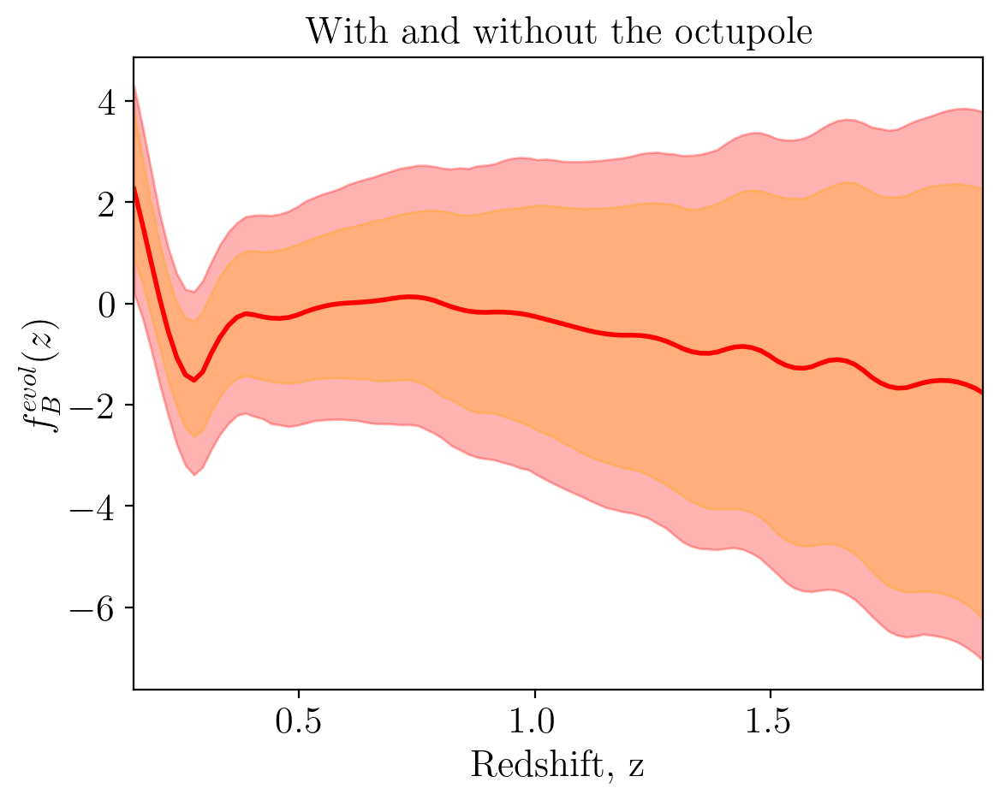

In [135]:
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_B_lower_bound, fevol_B_upper_bound, color='red', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound_all, fevol_B_upper_bound_all, color='orange', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z')
plt.ylabel(r'$f^{evol}_B(z)$')
plt.title('With and without the octupole');

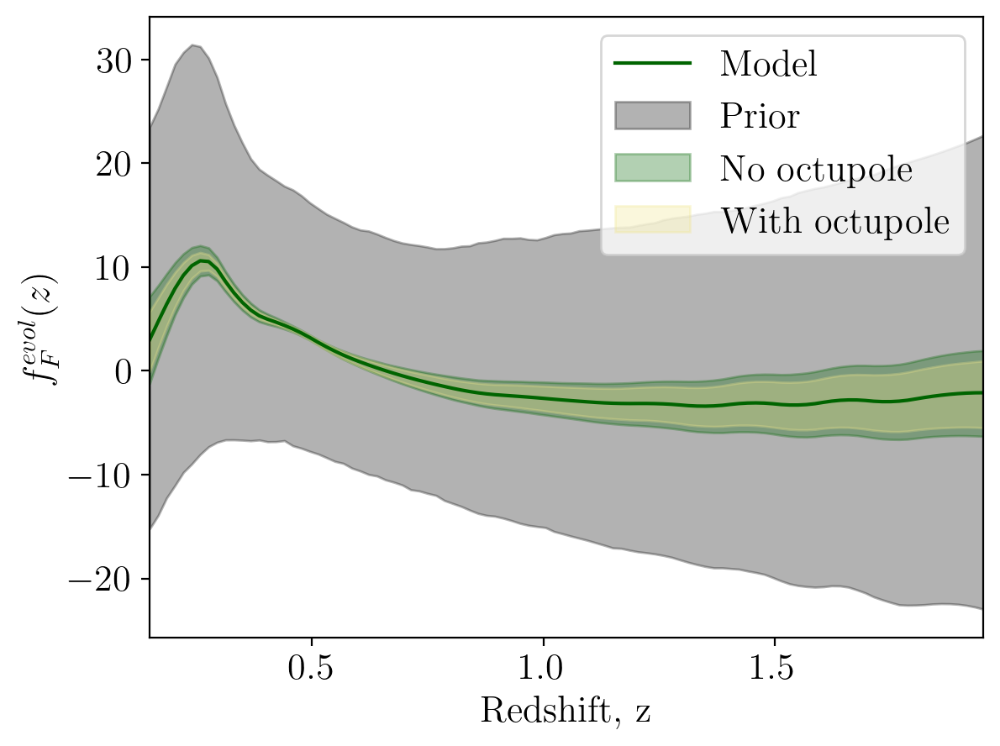

In [136]:
plt.plot(z_lin, fevol_F_fid, '-', color='darkgreen', lw = 1.5, label='Model')

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_F_lower_bound_priors, fevol_F_upper_bound_priors, color='black', alpha=0.3, label='Prior')
plt.fill_between(z_lin, fevol_F_lower_bound, fevol_F_upper_bound, color='darkgreen', alpha=0.3, label='No octupole')
plt.fill_between(z_lin, fevol_F_lower_bound_all, fevol_F_upper_bound_all, color='khaki', alpha=0.3, label='With octupole')

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f^{evol}_F(z)$');
#plt.title('With and without octupole');
plt.legend(loc='upper right')

plt.savefig("plots/fevolF_prediction_70x30_full_vs_noct_vs_prior20.pdf", bbox_inches='tight', format='pdf')

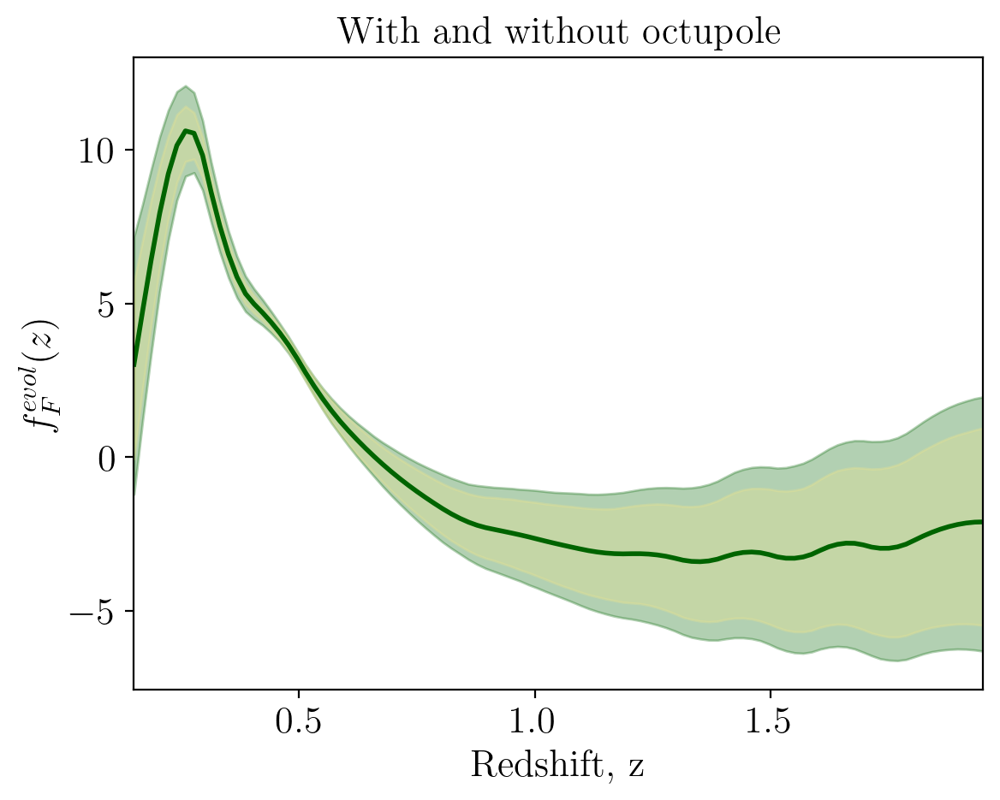

In [137]:
plt.plot(z_lin, fevol_F_fid, '-', color='darkgreen', lw = 2.0)

# Shade the 68% confidence interval

plt.fill_between(z_lin, fevol_F_lower_bound, fevol_F_upper_bound, color='darkgreen', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound_all, fevol_F_upper_bound_all, color='khaki', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f^{evol}_F(z)$');
plt.title('With and without octupole');

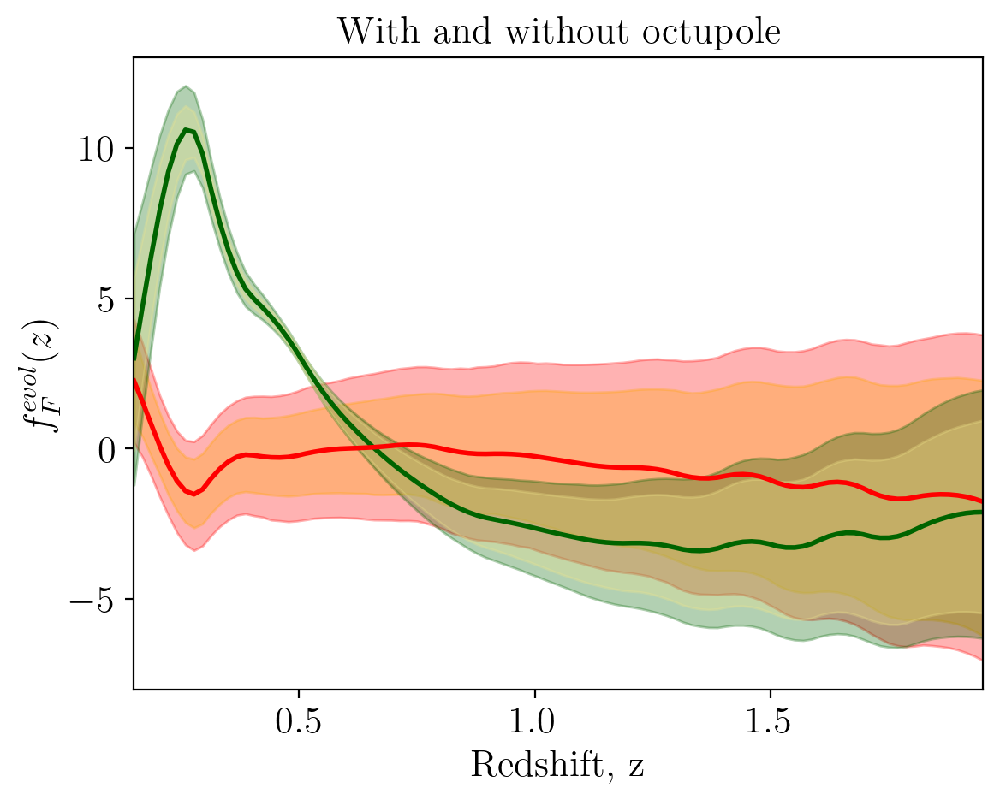

In [138]:
plt.plot(z_lin, fevol_F_fid, '-', color='darkgreen', lw = 2.0)
plt.plot(z_lin, fevol_B_fid, '-', color='red', lw = 2.0)

# Shade the 68% confidence interval

#plt.fill_between(z_lin, fevol_B_lower_bound_priors, fevol_B_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound, fevol_B_upper_bound, color='red', alpha=0.3)
plt.fill_between(z_lin, fevol_B_lower_bound_all, fevol_B_upper_bound_all, color='orange', alpha=0.3)

# Shade the 68% confidence interval

#plt.fill_between(z_lin, fevol_F_lower_bound_priors, fevol_F_upper_bound_priors, color='black', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound, fevol_F_upper_bound, color='darkgreen', alpha=0.3)
plt.fill_between(z_lin, fevol_F_lower_bound_all, fevol_F_upper_bound_all, color='khaki', alpha=0.3)

plt.xlim(0.15,1.95)

plt.xlabel(r'Redshift, z');
plt.ylabel(r'$f^{evol}_F(z)$');
plt.title('With and without octupole');